# Prediction of the Box-Counting Dimension of Metal Nanoparticles: Models Training and Evaluation

This notebook contains the models training and evaluation results from the machine learning predictions of the box-counting dimensions, $D_B$, computed for metal (specifically the mono-, bi-, and tri-metallic combinations of gold, palladium, and platinum) nanoparticles, in attempt to explore the possibility of using a machine learning model to compute the $D_B$ values to save computational costs. The feature importance profiles are also studied to investigate the most influential features in the prediction of the $D_B$ of metal nanoparticles.

The $D_B$ values are computed using [Sphractal](https://github.com/jon-ting/sphractal), a Python package for the estimation of the fractal dimension of the surfaces of atomistic objects via box-counting approaches.

## Outline

[Notebook Setups](#setup)

[Monometallic Nanoparticles](#mnps)

[Bimetallic Nanoparticles](#bnps)

[Trimetallic Nanoparticles](#tnps)

<a id='setup'></a>
## Notebook Setups

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
# Import relevant libraries
from os import listdir
import pickle
import warnings

import lightgbm
import seaborn as sns
import sklearn
import xgboost

from lightgbm import LGBMRegressor
from natsort import natsorted
# from sklearnex import patch_sklearn; 
# patch_sklearn()
from sklearn.ensemble import AdaBoostRegressor, BaggingRegressor, ExtraTreesRegressor, GradientBoostingRegressor, RandomForestRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.linear_model import ElasticNetCV, LassoLarsCV, LinearRegression, RidgeCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor, ExtraTreeRegressor
from xgboost import XGBRegressor

from trainEvalModels import *

# Print package versions for reproducibility
print('Versions of imported libraries:')
print(f"  lightgbm: {lightgbm.__version__}")
print(f"  matplotlib: {mpl.__version__}")
print(f"  numpy: {np.__version__}")
print(f"  pandas: {pd.__version__}")
print(f"  seaborn: {sns.__version__}")
print(f"  scikit-learn: {sklearn.__version__}")
print(f"  xgboost: {xgboost.__version__}")

Versions of imported libraries:
  lightgbm: 4.1.0
  matplotlib: 3.7.1
  numpy: 1.24.3
  pandas: 1.5.3
  seaborn: 0.13.0
  scikit-learn: 1.3.0
  xgboost: 1.7.3


Below are some general settings for plotting figures:

In [4]:
# Settings for figures
sns.set_theme(context='paper', style='ticks', palette='colorblind', font='sans-serif', font_scale=1, color_codes=True, rc=None)  # Options are: {paper, notebook, talk, poster}
figSize, fontSize, labelSize = (3.5, 2.5), 'medium', 'small'
legendSize, lineWidth, markerSize = 'x-small', 1, 3
# SMALL_SIZE, MEDIUM_SIZE, LARGE_SIZE, TITLE_SIZE = 8, 10, 12, 14
# plt.rc('font', size=LARGE_SIZE)  # controls default text sizes
# plt.rc('axes', titlesize=TITLE_SIZE)  # fontsize of the axes title
# plt.rc('axes', labelsize=LARGE_SIZE)  # fontsize of the x and y labels
# plt.rc('xtick', labelsize=LARGE_SIZE)  # fontsize of the tick labels
# plt.rc('ytick', labelsize=LARGE_SIZE)  # fontsize of the tick labels
# plt.rc('legend', fontsize=LARGE_SIZE)  # legend fontsize
# plt.rc('figure', titlesize=TITLE_SIZE)  # fontsize of the figure title

In [5]:
# Global variables
SCALING = 'minmax'  # {None, 'minmax', 'standard', 'yeo-johnson'}
POLY_FEATS = False
FIG_NAME_APPENDIX = 'minmax'

## Regression Models Implemented

Below are a list of the regression models that are implemented and compared.

### Linear Regressor (Baseline)

We implement the ordinary least squares (OLS) linear regressor as the baseline model, more complex models should exhibit better performance. A linear model is fitted with coefficients to minimize the residual sum of squares between the observed label values in the dataset, and the label values predicted by the linear approximation.

### LASSO Regressor

Linear model trained with L1 prior as regularizer or least absolute shrinkage and selection operator (LASSO), using the LARS algorithm, with iterative fitting along a regularization path. LassoLarsCV is more stable than LassoCV in general because it finds the relevant alphas values by itself. However, it is more fragile to heavily multicollinear datasets.

### Ridge Regressor

Ridge regression with built-in cross-validation via Leave-One-Out Cross-Validation (LOOCV).

### Elastic Net Regressor

Elastic Net model with iterative fitting along a regularization path.

### Kernel Ridge Regressor

### K-Nearest Neighbours Regressor

K-nearest neighbors regression.

### Support Vector Regressor

Support vector machine, free parameters being C and epsilon. 

C is a regularization parameter. The strength of the regularization is inversely proportional to C. Must be strictly positive. The penalty is a squared l2 penalty.

Epsilon specifies the epsilon-tube within which no penalty is associated in the training loss function with points predicted within a distance epsilon from the actual value. Must be non-negative.

### Decision Tree Regressor

A decision tree is a non-parametric model. The model predicts the value of a target variable by learning simple decision rules inferred from the data features. A tree can be seen as a piecewise constant approximation.

### ExtRa Tree Regressor

Extremely randomized tree regressor. When looking for the best split to separate the samples of a node into two groups, random splits are drawn for each of the max_features randomly selected features and the best split among those is chosen. Extra-trees should only be used within ensemble methods.

### Random Forest Regressor

A meta estimator that fits a number of classifying decision trees on various sub-samples of the dataset and uses averaging to improve the predictive accuracy and control over-fitting.

### ExtRa Trees Regressor

A meta estimator that fits a number of randomized decision trees (a.k.a. extra-trees) on various sub-samples of the dataset and uses averaging to improve the predictive accuracy and control over-fitting.

### Adaptive Boosting Forest Regressor

A meta-estimator that begins by fitting a regressor on the original dataset and then fits additional copies of the regressor on the same dataset but where the weights of instances are adjusted according to the error of the current prediction, via an the AdaBoost algorithm. As such, subsequent regressors focus more on difficult cases.

### Extreme Gradient Boosting Regressor

XGBoost is an optimized distributed gradient boosting library designed to be highly efficient, flexible and portable. It implements machine learning algorithms under the Gradient Boosting framework. XGBoost provides a parallel tree boosting (also known as GBDT, GBM) that solve many data science problems in a fast and accurate way.

### Light Gradient-Boosting Machine Regressor

Light gradient-boosting machine. It:
 - includes features such as sparse optimization, parallel training, multiple loss functions, regularization, bagging, and early stopping. 
 - does not grow a tree level-wise. Instead, it grows trees leaf-wise. It chooses the leaf it believes will yield the largest decrease in loss.
 - does not use the widely used sorted-based decision tree learning algorithm, which searches the best split point on sorted feature values. Instead, it implements a highly optimized histogram-based decision tree learning algorithm, which yields great advantages on both efficiency and memory consumption.
 - utilizes two novel techniques called Gradient-Based One-Side Sampling (GOSS) and Exclusive Feature Bundling (EFB) which allow the algorithm to run faster while maintaining a high level of accuracy.

<a id='mnps'></a>
## Monometallic Nanoparticles

Here we attempt to train a machine learning model that aims to predict the $D_B$ values of a set of simulated monometallic nanoparticles (either gold, palladium, or platinum), study the feature importance profile to understand the influential features in the prediction of the $D_B$ values, and investigate the conditions that give rise to rougher nanoparticles.

### Data Loading

In [4]:
with open('data/processedMNPdata.pickle', 'rb') as f:
    MNPsDF = pickle.load(f)
AuNPDF, PdNPDF, PtNPDF, MNPNPDF = MNPsDF

In [5]:
XtrainAuNP, XtestAuNP, yTrainAuNP, yTestAuNP = splitScaleData(df=AuNPDF, polyFeats=POLY_FEATS, scaling=SCALING, verbose=True)
XtrainPdNP, XtestPdNP, yTrainPdNP, yTestPdNP = splitScaleData(df=PdNPDF, polyFeats=POLY_FEATS, scaling=SCALING, verbose=True)
XtrainPtNP, XtestPtNP, yTrainPtNP, yTestPtNP = splitScaleData(df=PtNPDF, polyFeats=POLY_FEATS, scaling=SCALING, verbose=True)
XtrainMNP, XtestMNP, yTrainMNP, yTestMNP = splitScaleData(df=MNPNPDF, polyFeats=POLY_FEATS, scaling=SCALING, verbose=True)
X_Y_MNPS = {'Au': (XtrainAuNP, XtestAuNP, yTrainAuNP, yTestAuNP), 
            'Pd': (XtrainPdNP, XtestPdNP, yTrainPdNP, yTestPdNP), 
            'Pt': (XtrainPtNP, XtestPtNP, yTrainPtNP, yTestPtNP), 
            'MNP': (XtrainMNP, XtestMNP, yTrainMNP, yTestMNP)}

Applying minmax scaling to feature values...
Applying minmax scaling to feature values...
Applying minmax scaling to feature values...
Applying minmax scaling to feature values...


In [6]:
# Label Transformation

# Standardisation
# yTrain = (yTrain - yTrain.mean()) / yTrain.std()
# yTest = (yTest - yTest.mean()) / yTest.std()

# # Normalisation
# yTrain = (yTrain - yTrain.min()) / abs(yTrain.max() - yTrain.min())
# yTest = (yTest - yTest.min()) / abs(yTest.max() - yTest.min())

### Models Training and Evaluation

The regression models as described above are trained on different monometallic nanoparticle datasets (gold, palladium, platinum, and all three datasets combined) without polynomial features, with features scaled via min-max normalisation.

#### Linear Regressor


Dataset: Au
  Running LinR
  Trained and tested using coefficient of determination.
    Training score: 0.714
    Testing score:
      Mean absolute error: 0.011150
      Mean squared error: 0.000216
      Root mean squared error: 0.014693
      Coefficient of determination: 0.705


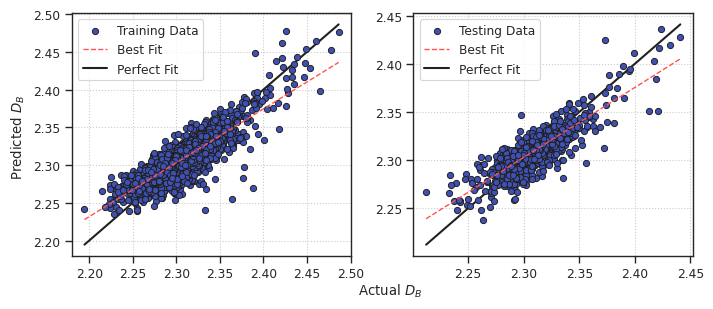

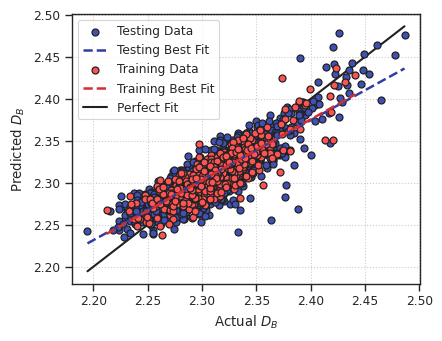

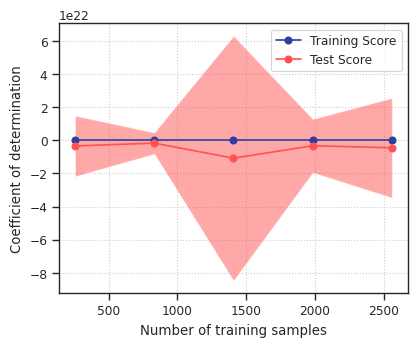

  Feature coefficients:
    N_total: 0.011
    R_max: 0.072
    R_kurt: 0.007
    S_100: 0.028
    S_110: 0.028
    S_311: 0.056
    Avg_bonds: 0.005
    Min_bonds: 0.002
    Perc_BCN_7: 0.003
    Perc_BCN_13: 0.066
    Perc_BCN_14: 0.067
    Perc_BCN_15: 0.015
    Perc_BCN_16: 0.026
    Perc_BCN_17: 0.004
    Perc_q6q6_B3: 0.021
    Perc_q6q6_B6: 0.053
    Perc_q6q6_B11: 0.028
    Perc_q6q6_B13: 0.010
    Perc_q6q6_B14: 0.007
    Perc_SCN_9: 0.826
    Perc_SCN_10: 1.431
    Perc_SCN_11: 2.863
    Perc_SCN_12: 0.424
    Perc_SCN_13: 0.225
    Perc_SCN_14: 0.067
    Perc_SCN_15: 0.047
    Perc_q6q6_S2: 0.012
    Perc_q6q6_S3: 0.002
    Perc_q6q6_S6: 0.103
    Perc_q6q6_S7: 0.016
    Perc_q6q6_S11: 0.048
    Perc_q6q6_S13: 0.006
    Perc_q6q6_T4: 0.053
    Perc_q6q6_T5: 0.042
    Perc_q6q6_T8: 0.119
    Perc_q6q6_T10: 0.014

Dataset: Pd
  Running LinR
  Trained and tested using coefficient of determination.
    Training score: 0.729
    Testing score:
      Mean absolute error: 0.011715


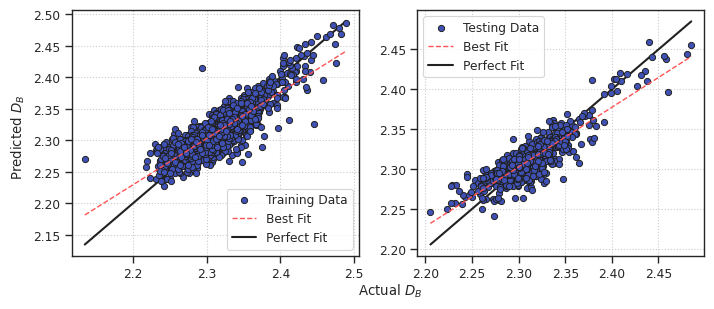

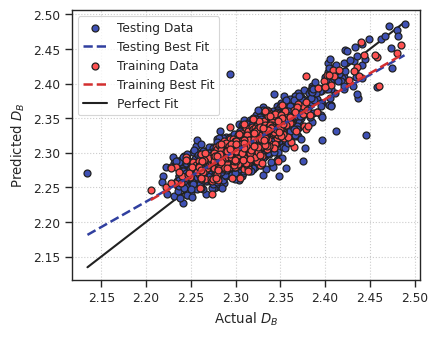

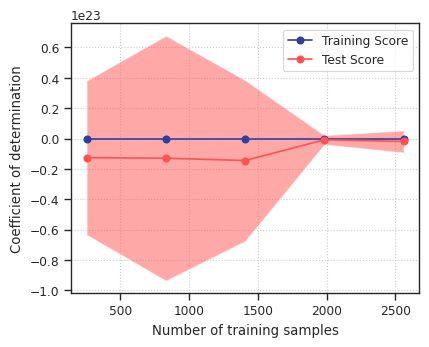

  Feature coefficients:
    T: 0.019
    R_max: 16.731
    S_100: 0.106
    S_111: 0.125
    S_110: 0.015
    S_311: 0.088
    Curve_11-20: 0.050
    Curve_21-30: 0.005
    Curve_31-40: 0.040
    Avg_total: 0.037
    Avg_bulk: 2.805
    Avg_surf: 4.901
    Min_bonds: 0.002
    ICOS: 0.003
    angle_std: 0.014
    Perc_BCN_5: 0.009
    Perc_BCN_6: 0.031
    Perc_BCN_7: 0.149
    Perc_BCN_8: 0.218
    Perc_BCN_9: 0.769
    Perc_BCN_10: 1.075
    Perc_BCN_11: 2.461
    Perc_BCN_12: 2.804
    Perc_q6q6_B5: 0.013
    Perc_q6q6_B6: 0.023
    Perc_q6q6_B9: 0.013
    Perc_q6q6_B11: 0.013
    Perc_q6q6_B14: 0.008
    Perc_q6q6_B15: 0.020
    Perc_SCN_1: 17137374466.374
    Perc_SCN_2: 13615996151.326
    Perc_SCN_3: 16031737403.931
    Perc_SCN_4: 39758708761.641
    Perc_SCN_5: 179500312897.621
    Perc_SCN_6: 537613196938.282
    Perc_SCN_7: 708375136191.942
    Perc_SCN_8: 1278592403880.011
    Perc_SCN_9: 1362069474830.284
    Perc_SCN_10: 596380631414.552
    Perc_SCN_11: 637636557640.386


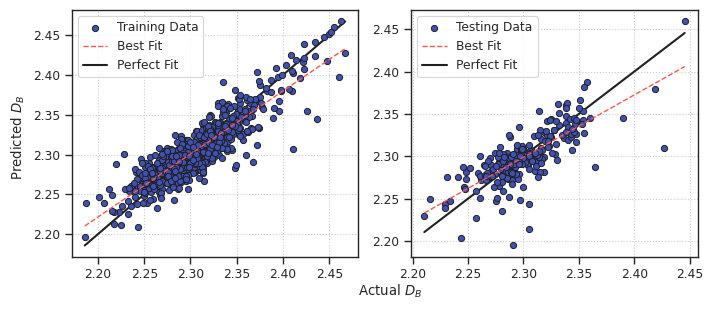

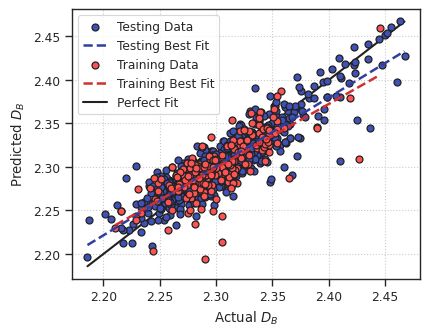

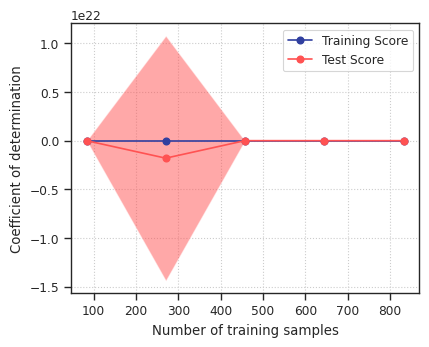

  Feature coefficients:
    T: 0.006
    time: 0.015
    R_min: 499.972
    R_diff: 597.498
    R_skew: 0.008
    S_100: 0.271
    S_111: 0.400
    Curve_11-20: 0.047
    Curve_21-30: 0.013
    Curve_31-40: 0.047
    Avg_total: 0.246
    Avg_bonds: 0.005
    Max_bonds: 0.003
    angle_std: 0.006
    HCP: 0.004
    Perc_BCN_6: 0.011
    Perc_BCN_7: 0.001
    Perc_BCN_8: 0.005
    Perc_BCN_14: 0.018
    Perc_q6q6_B0: 0.010
    Perc_q6q6_B3: 0.011
    Perc_q6q6_B5: 0.020
    Perc_q6q6_B7: 0.031
    Perc_q6q6_B8: 0.022
    Perc_q6q6_B9: 0.003
    Perc_q6q6_B11: 0.026
    Perc_q6q6_B14: 0.002
    Perc_SCN_9: 11.766
    Perc_SCN_10: 15.673
    Perc_SCN_11: 27.510
    Perc_SCN_12: 1.287
    Perc_SCN_13: 0.273
    Perc_q6q6_S5: 0.029
    Perc_q6q6_S7: 0.149
    Perc_q6q6_S8: 0.073
    Perc_TCN_5: 0.006
    Perc_TCN_7: 0.090
    Perc_TCN_9: 0.035
    Perc_TCN_10: 0.043
    Perc_q6q6_T6: 0.043
    Perc_q6q6_T8: 0.004

Dataset: MNP
  Running LinR
  Trained and tested using coefficient of determin

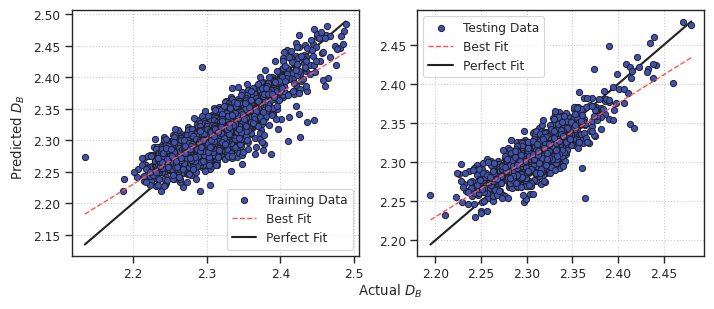

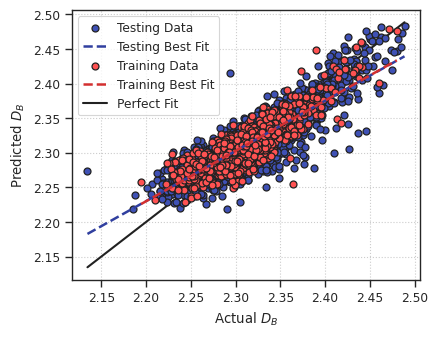

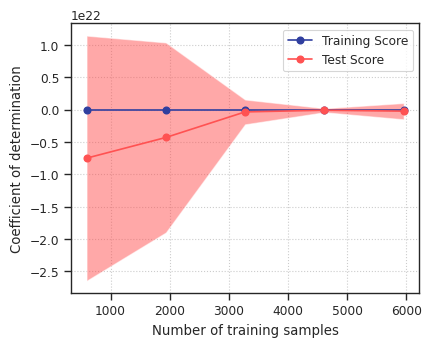

  Feature coefficients:
    time: 0.001
    R_max: 253.464
    S_100: 0.023
    S_111: 0.021
    S_311: 0.085
    Curve_11-20: 0.070
    Curve_31-40: 0.013
    Avg_total: 0.028
    Avg_surf: 2.138
    Avg_bonds: 0.001
    Min_bonds: 0.001
    FCC: 0.032
    Perc_BCN_7: 0.015
    Perc_BCN_13: 0.062
    Perc_BCN_14: 0.053
    Perc_BCN_15: 0.008
    Perc_BCN_16: 0.027
    Perc_BCN_17: 0.008
    Perc_q6q6_B5: 0.016
    Perc_q6q6_B6: 0.013
    Perc_q6q6_B8: 0.006
    Perc_q6q6_B9: 0.004
    Perc_q6q6_B11: 0.010
    Perc_q6q6_B14: 0.016
    Perc_q6q6_S6: 0.068
    Perc_q6q6_S7: 0.017
    Perc_q6q6_S8: 0.069
    Perc_q6q6_S13: 0.001
    Perc_TCN_9: 0.001
    Perc_TCN_10: 0.034
    Perc_q6q6_T4: 0.046
    Perc_q6q6_T5: 0.004
    Perc_q6q6_T10: 0.038


In [25]:
for mnp in X_Y_MNPS.keys():
    print(f"\nDataset: {mnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]
    
    linReg = LinearRegression(positive=False, fit_intercept=True, 
                              copy_X=True, n_jobs=NUM_JOBS)
    yPredTrainLinR, yPredTestLinR, linReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                     model=linReg, modelName='LinR', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                     showFeatCoef=True, plotFeatImp=False, verbose=True, showFig=True)

#### LASSO Regressor


Dataset: Au
  Running LASSO
  Trained and tested using coefficient of determination.
    Training score: 0.711
    Testing score:
      Mean absolute error: 0.011080
      Mean squared error: 0.000213
      Root mean squared error: 0.014609
      Coefficient of determination: 0.708
  Feature coefficients:
    R_max: 0.056
    R_kurt: 0.004
    S_100: 0.021
    S_110: 0.003
    S_311: 0.037
    Min_bonds: 0.003
    FCC: 0.007
    Perc_BCN_7: 0.001
    Perc_BCN_9: 0.005
    Perc_BCN_14: 0.016
    Perc_BCN_16: 0.018
    Perc_q6q6_B3: 0.007
    Perc_q6q6_B6: 0.034
    Perc_q6q6_B7: 0.001
    Perc_q6q6_B11: 0.026
    Perc_q6q6_B14: 0.005
    Perc_SCN_8: 0.115
    Perc_q6q6_S2: 0.008
    Perc_q6q6_S4: 0.005
    Perc_q6q6_S6: 0.077
    Perc_q6q6_S7: 0.017
    Perc_q6q6_S11: 0.034
    Perc_q6q6_S13: 0.005
    Perc_TCN_10: 0.007
    Perc_q6q6_T5: 0.020
    Perc_q6q6_T8: 0.043
    Perc_q6q6_T10: 0.012

Dataset: Pd
  Running LASSO
  Trained and tested using coefficient of determination.
    Trai

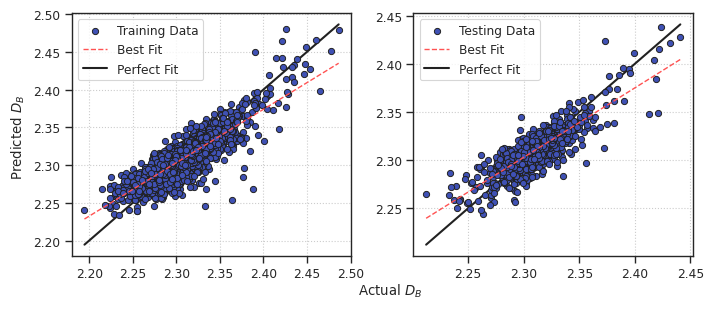

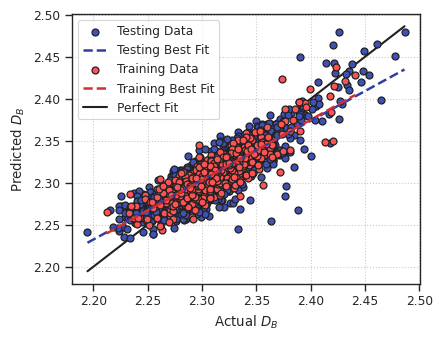

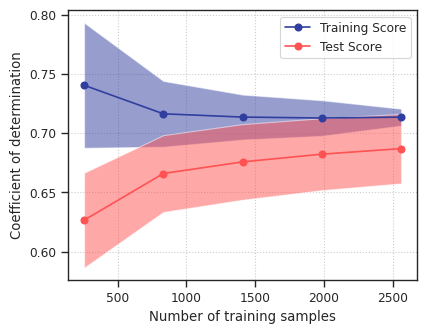

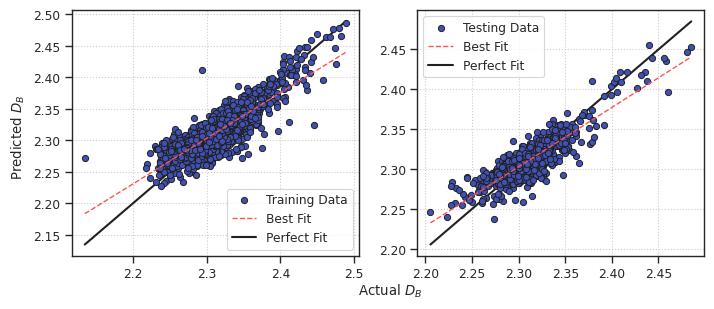

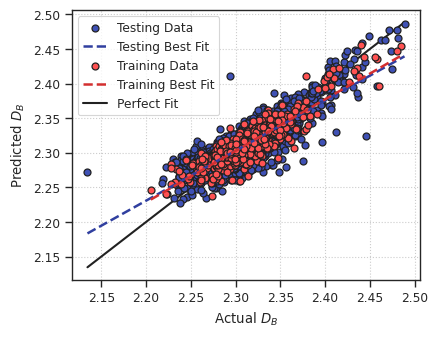

...

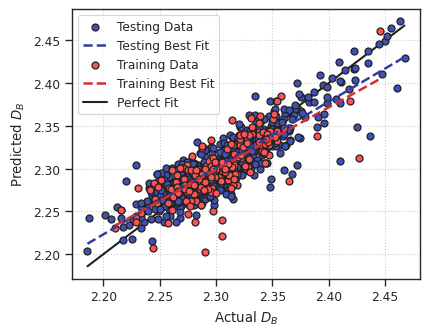

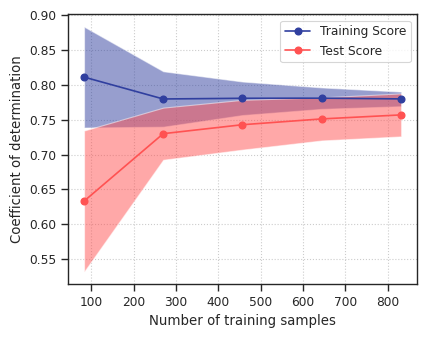

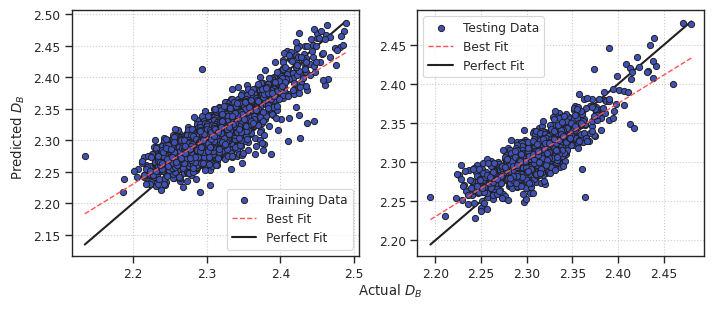

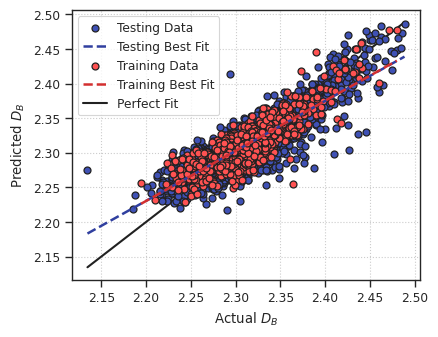

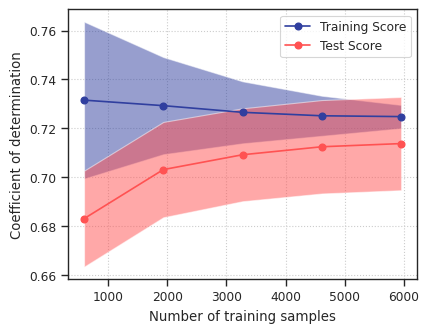

In [48]:
for mnp in X_Y_MNPS.keys():
    print(f"\nDataset: {mnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]
    
    lassoReg = LassoLarsCV(fit_intercept=True, max_iter=500, cv=5, max_n_alphas=1000, positive=False, eps=np.finfo(float).eps, 
                           precompute='auto', n_jobs=NUM_JOBS, copy_X=True, verbose=False)
    yPredTrainLASSO, yPredTestLASSO, lassoReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                         model=lassoReg, modelName='LASSO', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                         showFeatCoef=True, plotFeatImp=False, verbose=True, showFig=True)

#### Ridge Regressor


Dataset: Au
  Running Ridge
  Trained and tested using coefficient of determination.
    Training score: 0.712
    Testing score:
      Mean absolute error: 0.011100
      Mean squared error: 0.000214
      Root mean squared error: 0.014630
      Coefficient of determination: 0.707
  Feature coefficients:
    R_max: 0.061
    R_kurt: 0.006
    S_100: 0.029
    S_110: 0.015
    S_311: 0.036
    Avg_total: 0.022
    Avg_bonds: 0.004
    Min_bonds: 0.003
    FCC: 0.008
    Perc_BCN_7: 0.005
    Perc_BCN_9: 0.005
    Perc_BCN_14: 0.018
    Perc_BCN_15: 0.001
    Perc_BCN_16: 0.020
    Perc_BCN_17: 0.002
    Perc_q6q6_B3: 0.020
    Perc_q6q6_B6: 0.034
    Perc_q6q6_B7: 0.005
    Perc_q6q6_B11: 0.027
    Perc_q6q6_B13: 0.004
    Perc_q6q6_B14: 0.004
    Perc_SCN_8: 0.067
    Perc_SCN_9: 0.003
    Perc_SCN_13: 0.001
    Perc_SCN_15: 0.007
    Perc_q6q6_S2: 0.011
    Perc_q6q6_S4: 0.009
    Perc_q6q6_S6: 0.077
    Perc_q6q6_S7: 0.025
    Perc_q6q6_S8: 0.001
    Perc_q6q6_S11: 0.039
    Perc_q

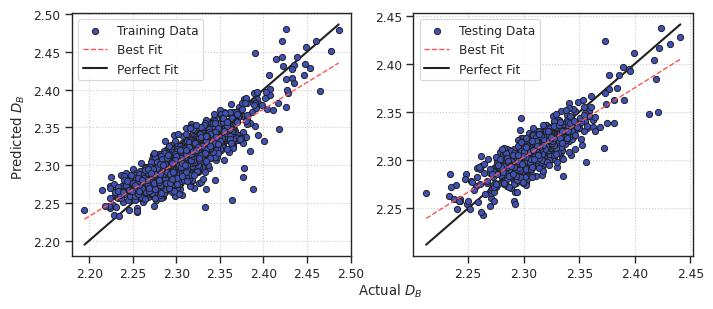

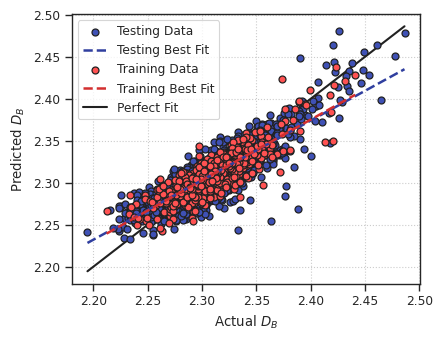

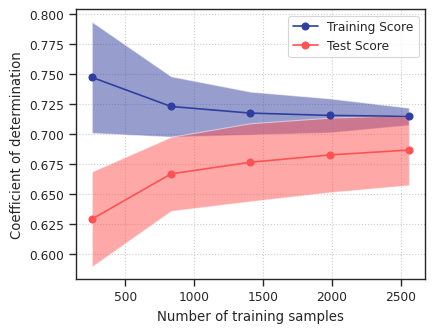

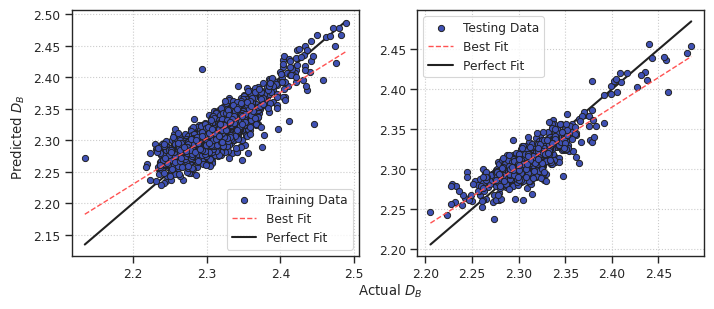

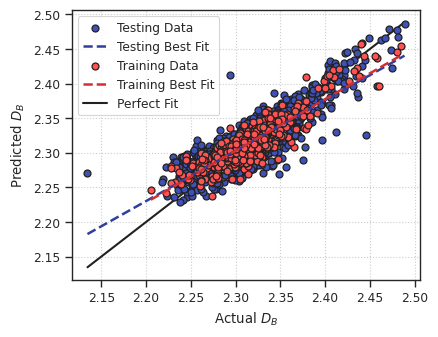

...

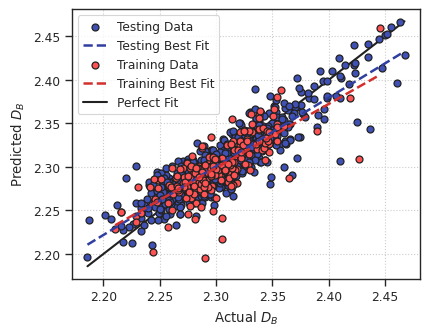

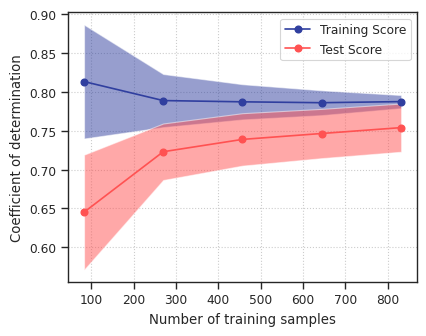

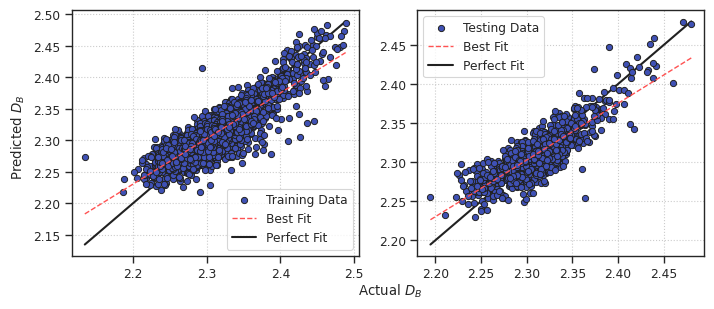

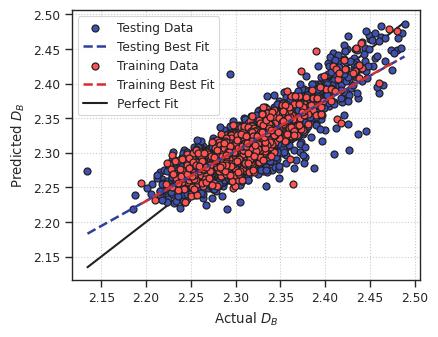

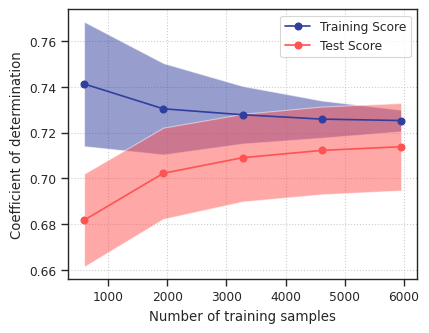

In [50]:
for mnp in X_Y_MNPS.keys():
    print(f"\nDataset: {mnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]
    
    ridgeReg = RidgeCV(alphas=(0.01, 0.1, 1.0, 10.0, 100.0), fit_intercept=True, scoring=None, cv=None, 
                       gcv_mode='auto', store_cv_values=False, alpha_per_target=False)  # cv=None for LOOCV, scoring='negative mean squared error'
    yPredTrainRidge, yPredTestRidge, ridgeReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                         model=ridgeReg, modelName='Ridge', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                         showFeatCoef=True, plotFeatImp=False, verbose=True, showFig=True)

#### Elastic Net Regressor


Dataset: Au
  Running ElasNetR
  Trained and tested using coefficient of determination.
    Training score: 0.710
    Testing score:
      Mean absolute error: 0.011061
      Mean squared error: 0.000213
      Root mean squared error: 0.014596
      Coefficient of determination: 0.709
  Feature coefficients:
    R_max: 0.053
    R_kurt: 0.003
    S_100: 0.023
    S_311: 0.035
    Avg_total: 0.036
    Min_bonds: 0.003
    FCC: 0.006
    Perc_BCN_9: 0.006
    Perc_BCN_10: 0.001
    Perc_BCN_14: 0.010
    Perc_BCN_16: 0.017
    Perc_q6q6_B3: 0.006
    Perc_q6q6_B6: 0.029
    Perc_q6q6_B7: 0.001
    Perc_q6q6_B11: 0.022
    Perc_q6q6_B14: 0.004
    Perc_SCN_8: 0.107
    Perc_q6q6_S2: 0.006
    Perc_q6q6_S4: 0.002
    Perc_q6q6_S6: 0.068
    Perc_q6q6_S7: 0.017
    Perc_q6q6_S8: 0.005
    Perc_q6q6_S11: 0.025
    Perc_q6q6_S13: 0.005
    Perc_TCN_10: 0.012
    Perc_q6q6_T5: 0.018
    Perc_q6q6_T8: 0.034
    Perc_q6q6_T10: 0.009

Dataset: Pd
  Running ElasNetR
  Trained and tested using coe

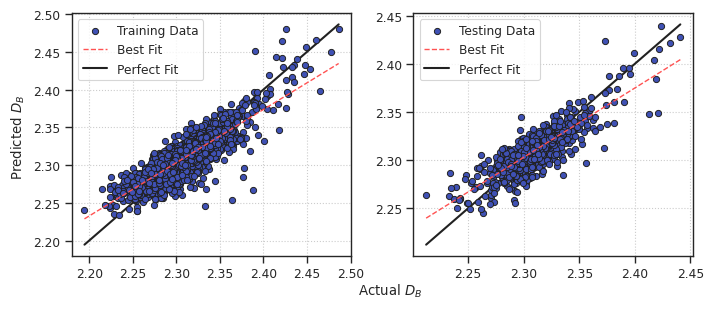

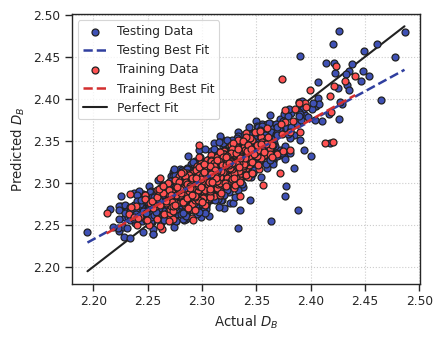

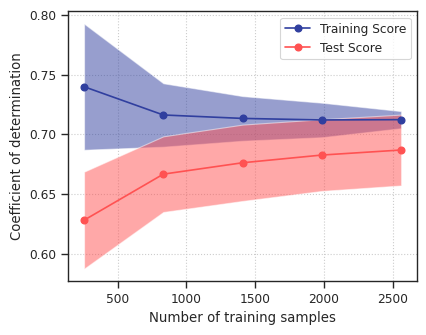

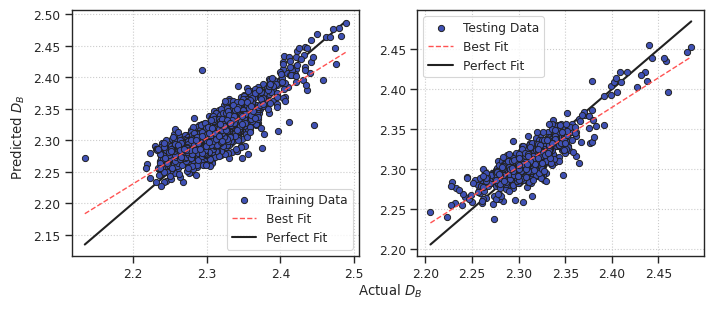

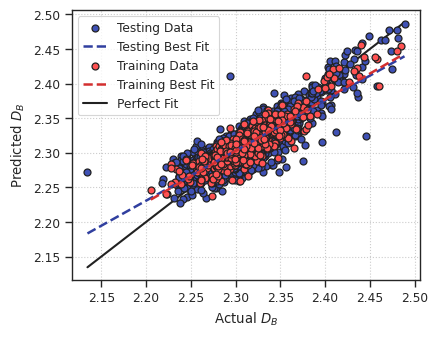

...

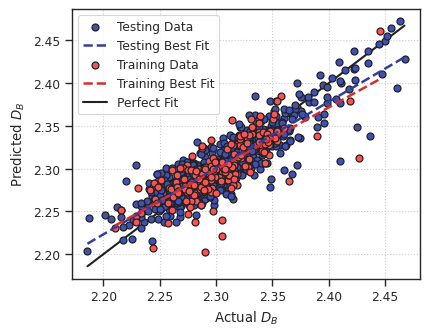

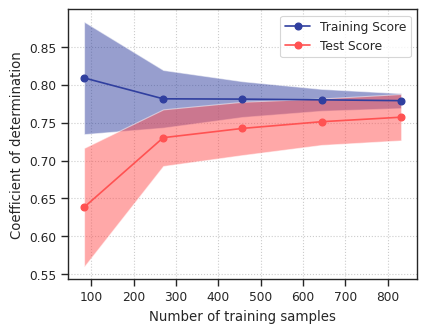

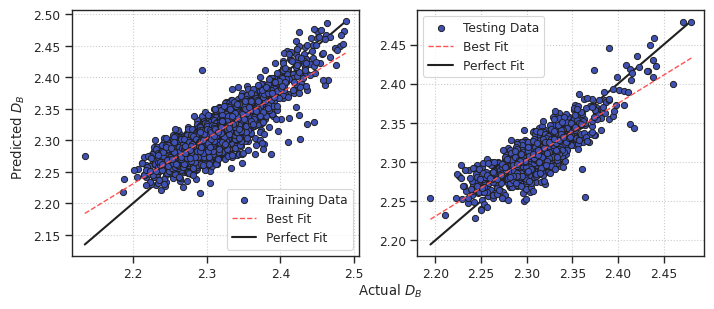

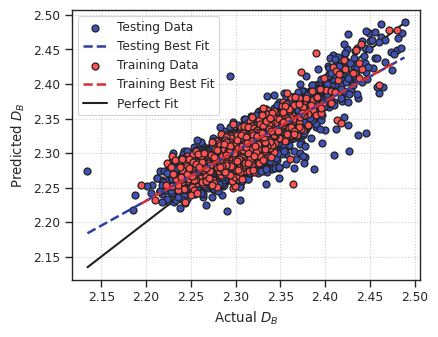

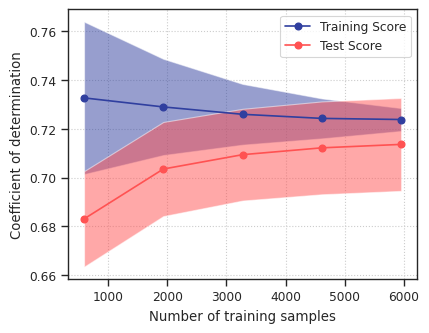

In [51]:
for mnp in X_Y_MNPS.keys():
    print(f"\nDataset: {mnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]
    
    enReg = ElasticNetCV(l1_ratio=(0.1, 0.5, 0.7, 0.9, 0.95, 0.99), eps=0.001, n_alphas=100, alphas=None, 
                         fit_intercept=True, precompute='auto', max_iter=100000, tol=0.0001, cv=5, 
                         copy_X=True, verbose=0, n_jobs=NUM_JOBS, positive=False, random_state=RANDOM_SEED, selection='cyclic')
    yPredTrainElasNetR, yPredTestElasNetR, enReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                            model=enReg, modelName='ElasNetR', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                            showFeatCoef=True, plotFeatImp=False, verbose=True, showFig=True)

#### Kernel Ridge Regressor


Dataset: Au
Best score: 0.706
Best parameter combination: {'alpha': 0.1, 'kernel': 'poly'}
Best score: 0.675
Best parameter combination: {'alpha': 0.1, 'coef0': 0.5, 'gamma': 0.01, 'kernel': 'sigmoid'}
Best score: 0.728
Best parameter combination: {'alpha': 0.1, 'coef0': 2.0, 'degree': 2, 'gamma': 0.1, 'kernel': 'polynomial'}
Best score: 0.715
Best parameter combination: {'alpha': 0.1, 'gamma': 0.01, 'kernel': 'laplacian'}
  Running KRR
  Trained and tested using coefficient of determination.
    Training score: 0.754
    Testing score:
      Mean absolute error: 0.010674
      Mean squared error: 0.000199
      Root mean squared error: 0.014103
      Coefficient of determination: 0.728


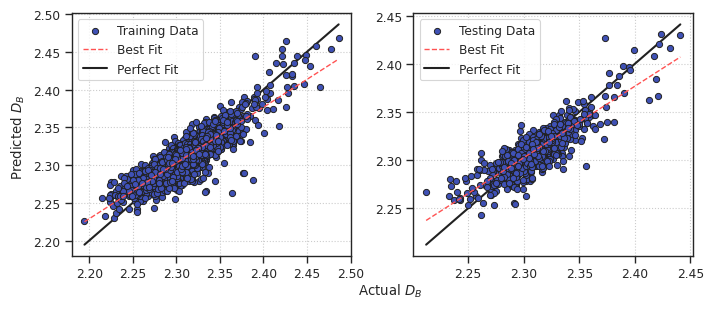

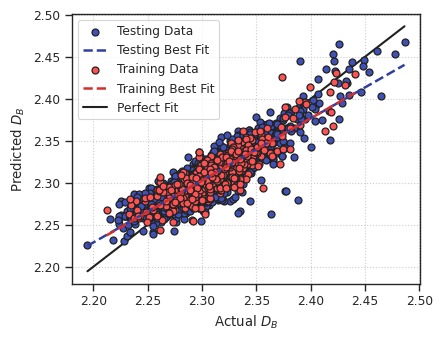

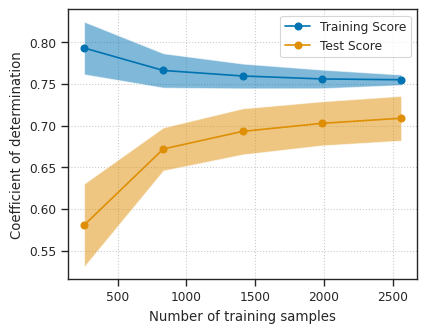


Dataset: Pd
Best score: 0.765
Best parameter combination: {'alpha': 0.1, 'kernel': 'poly'}
Best score: 0.729
Best parameter combination: {'alpha': 0.1, 'coef0': 0.5, 'gamma': 0.01, 'kernel': 'sigmoid'}
Best score: 0.781
Best parameter combination: {'alpha': 0.1, 'coef0': 2.0, 'degree': 2, 'gamma': 0.1, 'kernel': 'polynomial'}
Best score: 0.768
Best parameter combination: {'alpha': 0.1, 'gamma': 0.01, 'kernel': 'laplacian'}
  Running KRR
  Trained and tested using coefficient of determination.
    Training score: 0.774
    Testing score:
      Mean absolute error: 0.011299
      Mean squared error: 0.000228
      Root mean squared error: 0.015098
      Coefficient of determination: 0.781


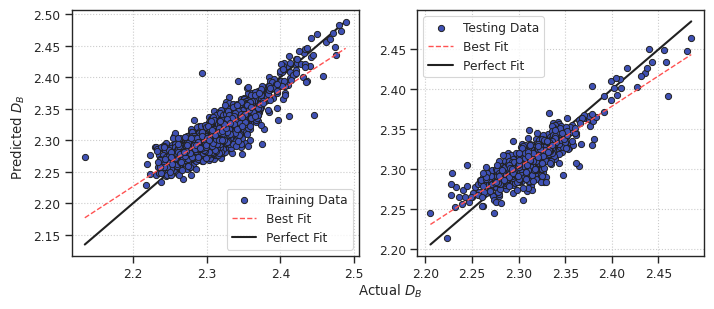

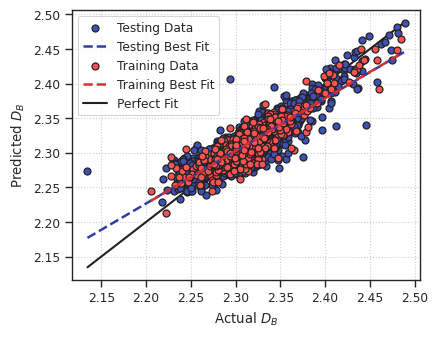

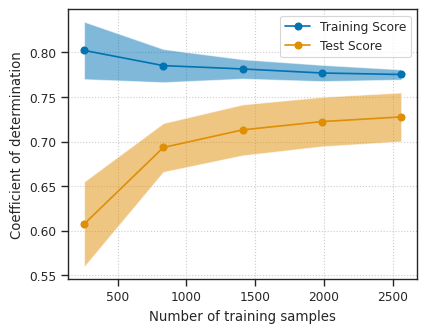


Dataset: Pt
Best score: 0.534
Best parameter combination: {'alpha': 0.1, 'kernel': 'poly'}
Best score: 0.523
Best parameter combination: {'alpha': 0.1, 'coef0': 0.5, 'gamma': 0.01, 'kernel': 'sigmoid'}
Best score: 0.554
Best parameter combination: {'alpha': 0.1, 'coef0': 2.0, 'degree': 4, 'gamma': 0.01, 'kernel': 'polynomial'}
Best score: 0.469
Best parameter combination: {'alpha': 0.1, 'gamma': 0.01, 'kernel': 'laplacian'}
  Running KRR
  Trained and tested using coefficient of determination.
    Training score: 0.797
    Testing score:
      Mean absolute error: 0.014140
      Mean squared error: 0.000435
      Root mean squared error: 0.020853
      Coefficient of determination: 0.554


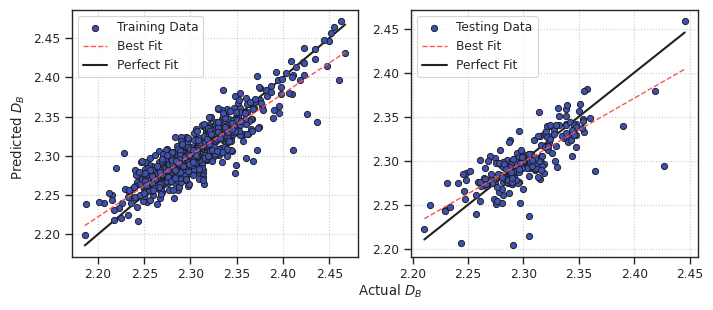

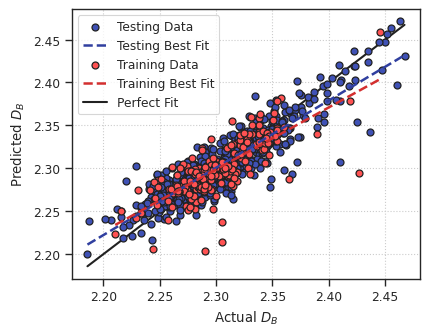

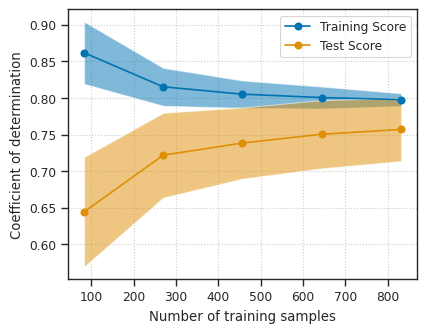


Dataset: MNP
Best score: 0.722
Best parameter combination: {'alpha': 0.1, 'kernel': 'poly'}
Best score: 0.695
Best parameter combination: {'alpha': 0.1, 'coef0': 0.5, 'gamma': 0.01, 'kernel': 'sigmoid'}
Best score: 0.735
Best parameter combination: {'alpha': 0.1, 'coef0': 2.0, 'degree': 2, 'gamma': 0.1, 'kernel': 'polynomial'}
Best score: 0.704
Best parameter combination: {'alpha': 0.1, 'gamma': 0.01, 'kernel': 'laplacian'}
  Running KRR
  Trained and tested using coefficient of determination.
    Training score: 0.766
    Testing score:
      Mean absolute error: 0.011162
      Mean squared error: 0.000231
      Root mean squared error: 0.015199
      Coefficient of determination: 0.735


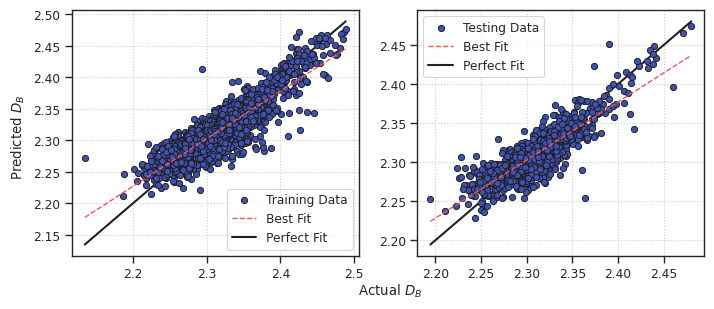

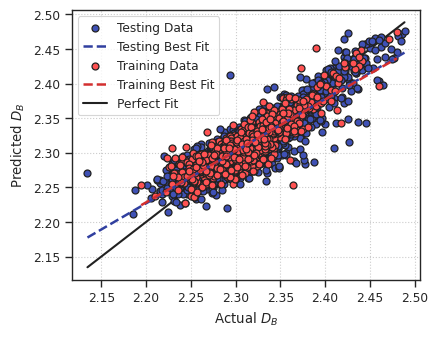

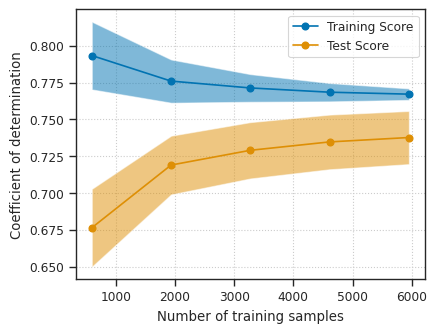

In [10]:
for mnp in X_Y_MNPS.keys():
    print(f"\nDataset: {mnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]

    # General
    estimator = KernelRidge(alpha=1, kernel='linear', gamma=None, degree=3, coef0=1, kernel_params=None)
    paramGridGeneral = {'alpha': [0.1, 1.0, 10, 100], 
                 'kernel': ['linear', 'poly', 'cosine'],  # 'linear', 'poly', 'rbf', 'sigmoid', 'additive_chi2', 'chi2', 'polynomial', 'laplacian', 'cosine'
                 }
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResultsGeneral = hyperparamTune(estimator, paramGridGeneral, Xtrain, yTrain, Xtest, yTest, cv=cv)

    # Sigmoid kernel
    estimator = KernelRidge(alpha=1, kernel='linear', gamma=None, degree=3, coef0=1, kernel_params=None)
    paramGridSigmoid = {'alpha': [0.1, 1.0, 10, 100], 
                 'kernel': ['sigmoid'], 
                 'gamma': (1.0, 0.1, 0.01, 0.001), 
                 'coef0': [0.5, 1.0, 2.0], 
                 }
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResultsSigmoid = hyperparamTune(estimator, paramGridSigmoid, Xtrain, yTrain, Xtest, yTest, cv=cv)
   
    # Polynomial kernel
    estimator = KernelRidge(alpha=1, kernel='linear', gamma=None, degree=3, coef0=1, kernel_params=None)
    paramGridPolynomial = {'alpha': [0.1, 1.0, 10, 100], 
                 'kernel': ['polynomial'], 
                 'degree' : [2, 3, 4], 
                 'gamma': (1.0, 0.1, 0.01, 0.001), 
                 'coef0': [0.5, 1.0, 2.0], 
                 }
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResultsPolynomial = hyperparamTune(estimator, paramGridPolynomial, Xtrain, yTrain, Xtest, yTest, cv=cv)

    # Kernel involving gammas
    estimator = KernelRidge(alpha=1, kernel='linear', gamma=None, degree=3, coef0=1, kernel_params=None)
    paramGridGamma = {'alpha': [0.1, 1.0, 10, 100], 
                 'kernel': ['rbf', 'laplacian', 'chi2', 'sigmoid'],  
                 'gamma': (1.0, 0.1, 0.01, 0.001), 
                 }
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResultsGamma = hyperparamTune(estimator, paramGridGamma, Xtrain, yTrain, Xtest, yTest, cv=cv)

    bestResultsIdx = np.argmax([searchResultsGeneral.best_score_, searchResultsSigmoid.best_score_, searchResultsPolynomial.best_score_, searchResultsGamma.best_score_])
    searchResultsBest = [searchResultsGeneral, searchResultsSigmoid, searchResultsPolynomial, searchResultsGamma][bestResultsIdx]

    krReg = searchResultsBest.best_estimator_
    yPredTrainKRR, yPredTestKRR, krReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                  model=krReg, modelName='KRR', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                  showFeatCoef=False, plotFeatImp=False, verbose=True, showFig=True)

#### K-Nearest Neighbour Regressor


Dataset: Au
Best score: 0.711
Best parameter combination: {'metric': 'minkowski', 'n_neighbors': 10, 'p': 1, 'weights': 'distance'}
  Running KNR
  Trained and tested using coefficient of determination.
    Training score: 1.000
    Testing score:
      Mean absolute error: 0.010917
      Mean squared error: 0.000211
      Root mean squared error: 0.014537
      Coefficient of determination: 0.711

Dataset: Pd
Best score: 0.759
Best parameter combination: {'metric': 'minkowski', 'n_neighbors': 10, 'p': 1, 'weights': 'distance'}
  Running KNR
  Trained and tested using coefficient of determination.
    Training score: 1.000
    Testing score:
      Mean absolute error: 0.011773
      Mean squared error: 0.000250
      Root mean squared error: 0.015818
      Coefficient of determination: 0.759

Dataset: Pt
Best score: 0.587
Best parameter combination: {'metric': 'minkowski', 'n_neighbors': 10, 'p': 1.5, 'weights': 'distance'}
  Running KNR
  Trained and tested using coefficient of deter

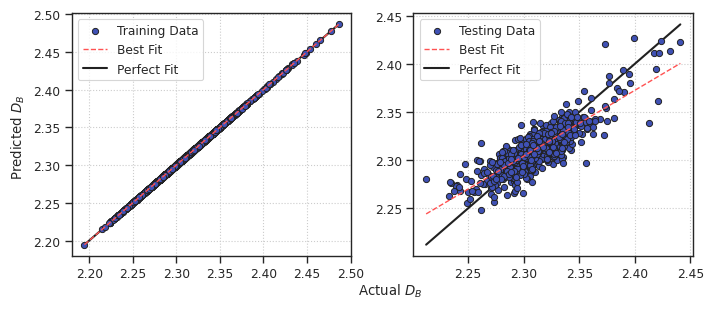

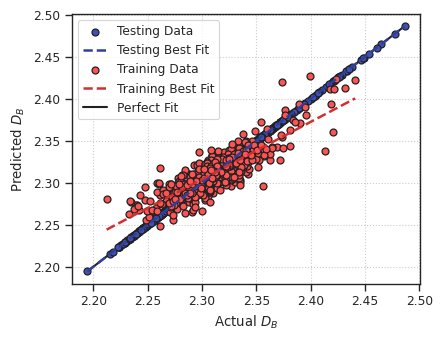

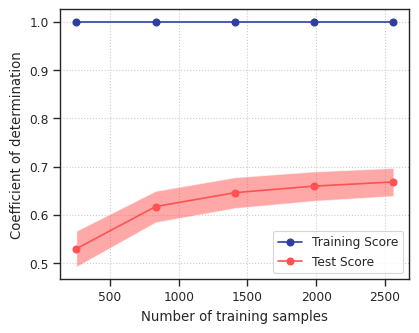

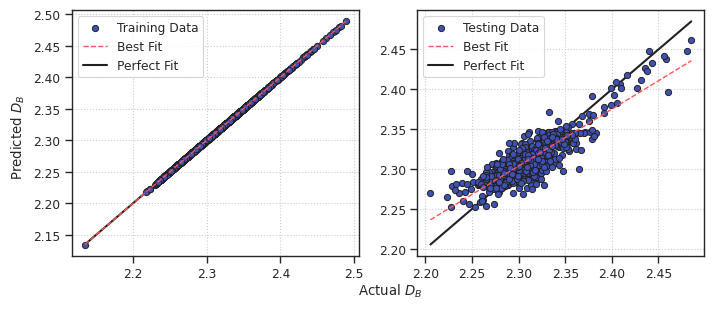

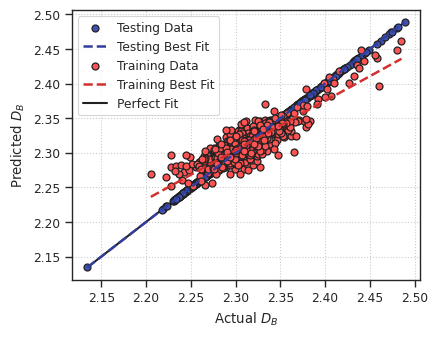

...

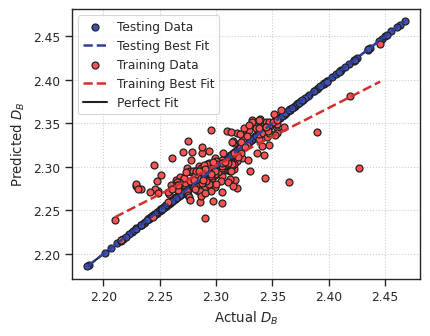

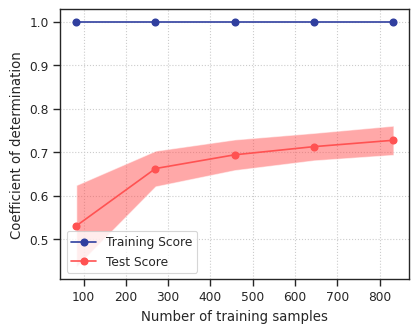

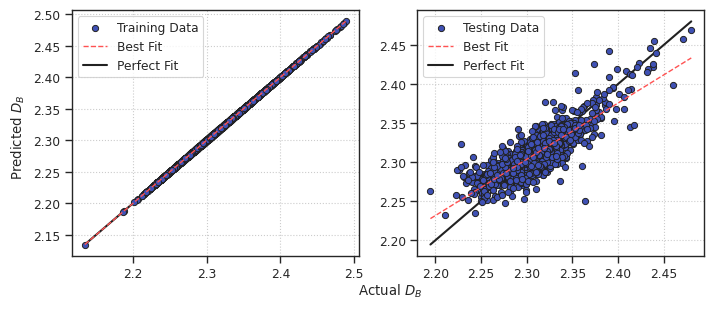

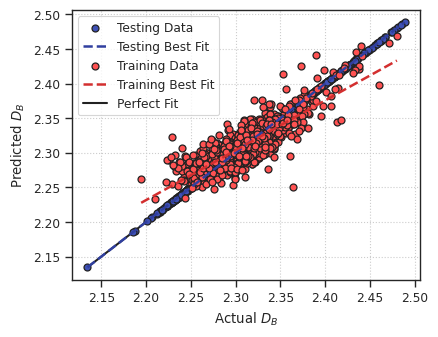

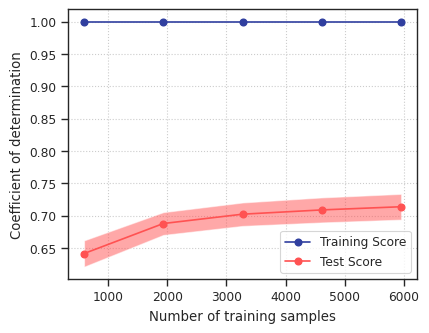

In [66]:
for mnp in X_Y_MNPS.keys():
    print(f"\nDataset: {mnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]
    
    estimator = KNeighborsRegressor(n_neighbors=5, weights='uniform', p=2, metric='minkowski', 
                                    algorithm='auto', leaf_size=30, metric_params=None, n_jobs=NUM_JOBS)
    paramGrid = {'n_neighbors': [3, 5, 8, 10], 
                 'weights': ['uniform', 'distance'],  
                 'p' : [1, 1.5, 2], 
                 'metric': ['minkowski', 'euclidean', 'manhattan']}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

    knReg = searchResults.best_estimator_
    yPredTrainKNR, yPredTestKNR, knReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                  model=knReg, modelName='KNR', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                  showFeatCoef=False, plotFeatImp=False, verbose=True, showFig=True)

#### Support Vector Regressor


Dataset: Au
Best score: 0.732
Best parameter combination: {'C': 0.1, 'degree': 2, 'epsilon': 0.01, 'gamma': 'scale', 'kernel': 'rbf'}
  Running SVR
  Trained and tested using coefficient of determination.
    Training score: 0.762
    Testing score:
      Mean absolute error: 0.010503
      Mean squared error: 0.000196
      Root mean squared error: 0.013994
      Coefficient of determination: 0.732


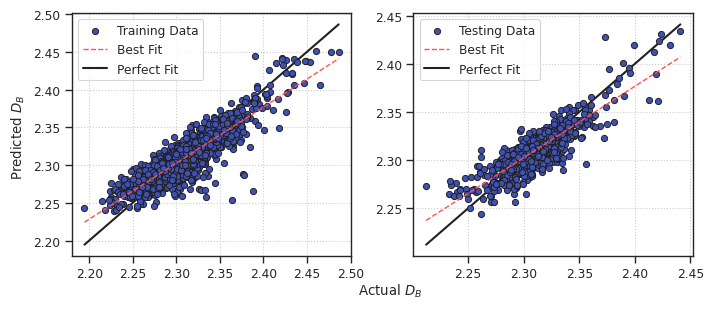

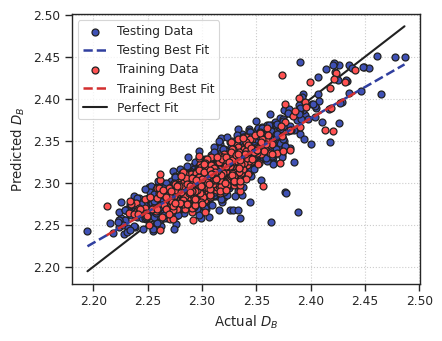

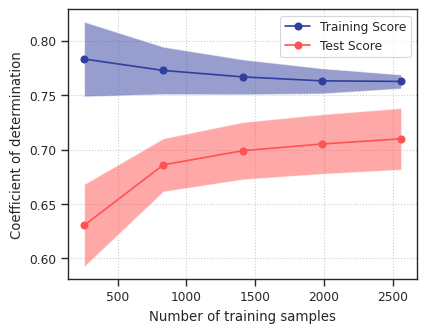


Dataset: Pd
Best score: 0.781
Best parameter combination: {'C': 0.1, 'degree': 2, 'epsilon': 0.01, 'gamma': 'scale', 'kernel': 'rbf'}
  Running SVR
  Trained and tested using coefficient of determination.
    Training score: 0.779
    Testing score:
      Mean absolute error: 0.011245
      Mean squared error: 0.000227
      Root mean squared error: 0.015082
      Coefficient of determination: 0.781


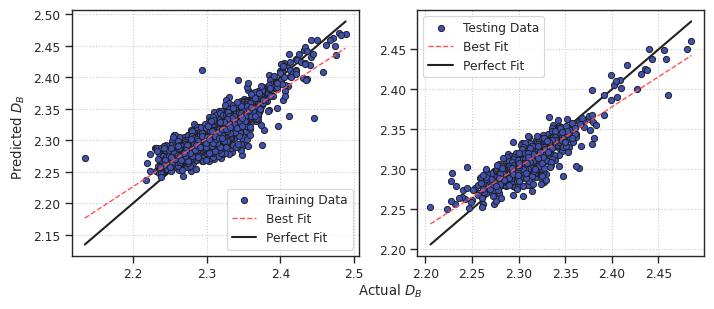

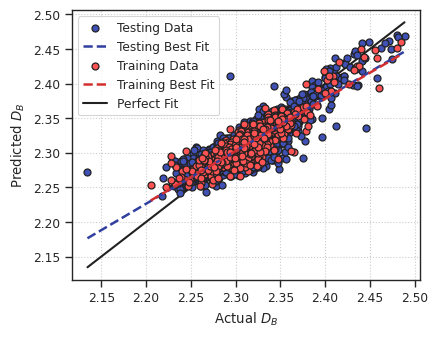

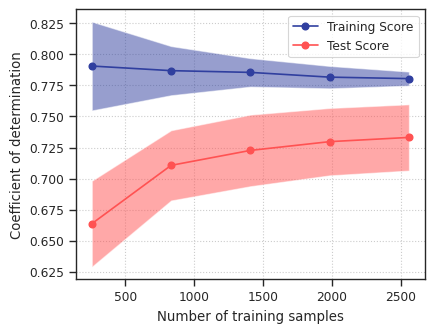


Dataset: Pt
Best score: 0.598
Best parameter combination: {'C': 0.1, 'degree': 2, 'epsilon': 0.01, 'gamma': 'scale', 'kernel': 'rbf'}
  Running SVR
  Trained and tested using coefficient of determination.
    Training score: 0.811
    Testing score:
      Mean absolute error: 0.013253
      Mean squared error: 0.000391
      Root mean squared error: 0.019785
      Coefficient of determination: 0.598


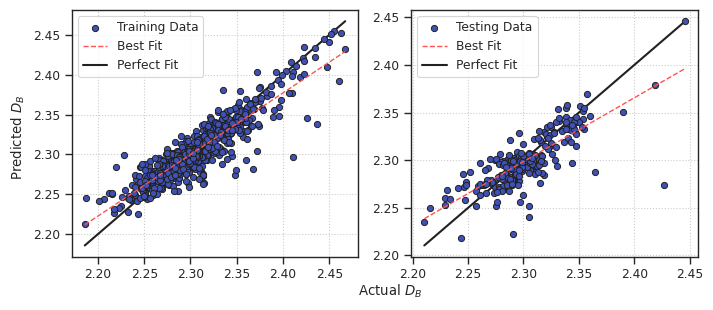

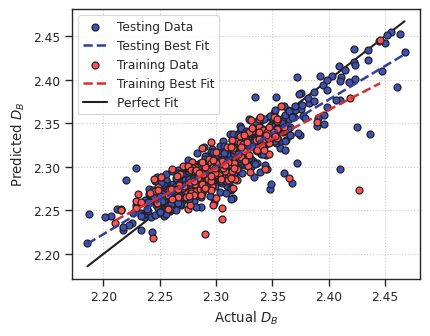

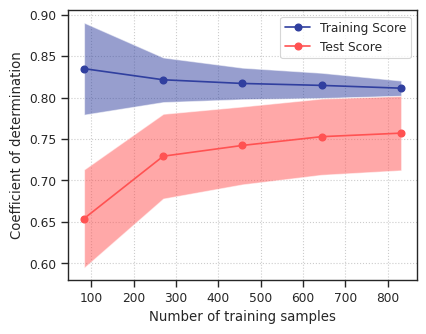


Dataset: MNP


KeyboardInterrupt: 

In [36]:
for mnp in X_Y_MNPS.keys():
    print(f"\nDataset: {mnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]
    
    estimator = SVR(coef0=0.0, tol=0.001, epsilon=0.1, shrinking=True, cache_size=200, verbose=False, max_iter=-1)
    paramGrid = {'C': [0.01, 0.1, 1.0, 10, 100], 
                 'epsilon': [0.01, 0.1, 1.0], 
                 'kernel': ['linear', 'poly', 'rbf', 'sigmoid'], 
                 'degree' : [2, 3, 4], 
                 'gamma': ['scale', 'auto', 0.01, 0.1, 1.0]}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

    svReg = searchResults.best_estimator_
    yPredTrainSVR, yPredTestSVR, svReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                  model=svReg, modelName='SVR', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                  showFeatCoef=False, plotFeatImp=False, verbose=True, showFig=True)


Dataset: MNP
  Running SVR
  Trained and tested using coefficient of determination.
    Training score: 0.777
    Testing score:
      Mean absolute error: 0.011109
      Mean squared error: 0.000232
      Root mean squared error: 0.015215
      Coefficient of determination: 0.735


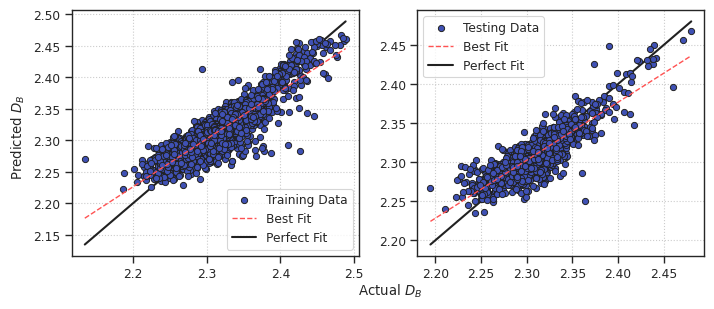

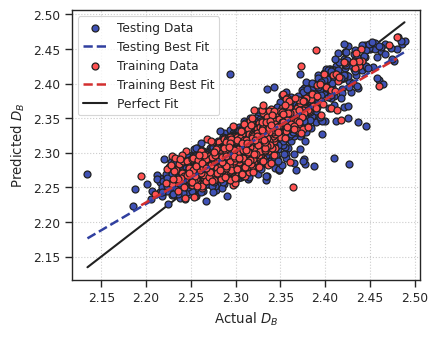

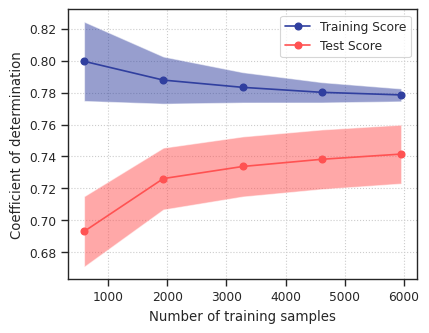

In [39]:
mnp = 'MNP'
print(f"\nDataset: {mnp}")
Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]
svReg = SVR(C=0.1, degree=2, epsilon=0.01, gamma='scale', kernel='rbf', 
            coef0=0.0, tol=0.001,  shrinking=True, cache_size=200, verbose=False, max_iter=-1)
yPredTrainSVR, yPredTestSVR, svReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                              model=svReg, modelName='SVR', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                              showFeatCoef=False, plotFeatImp=False, verbose=True, showFig=True)

#### Decision Tree Regressor


Dataset: Au
Best score: 0.613
Best parameter combination: {'criterion': 'absolute_error', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}
  Running DTR
  Trained and tested using coefficient of determination.
    Training score: 0.680
    Testing score:
      Mean absolute error: 0.012704
      Mean squared error: 0.000283
      Root mean squared error: 0.016835
      Coefficient of determination: 0.613

Dataset: Pd
Best score: 0.696
Best parameter combination: {'criterion': 'squared_error', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}
  Running DTR
  Trained and tested using coefficient of determination.
    Training score: 0.725
    Testing score:
      Mean absolute error: 0.013295
      Mean squared error: 0.000317
      Root mean squared error: 0.017793
      Coefficient of determination: 0.696

Dataset: Pt
Best score: 0.478
Best parameter combination: {'criterion': 'absolute_error', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}
  Running DTR
  

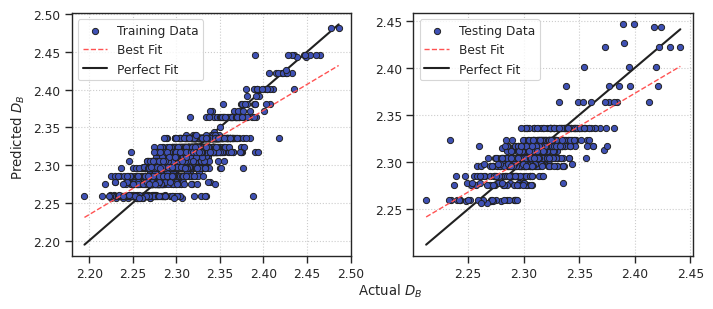

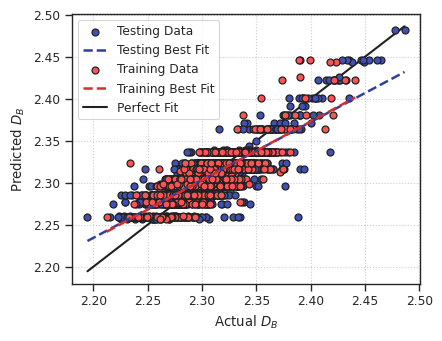

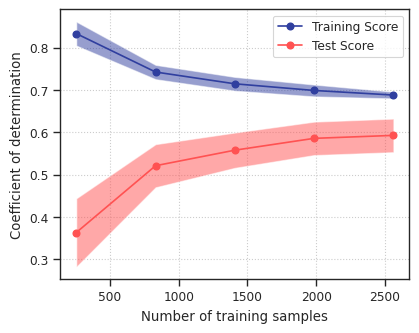

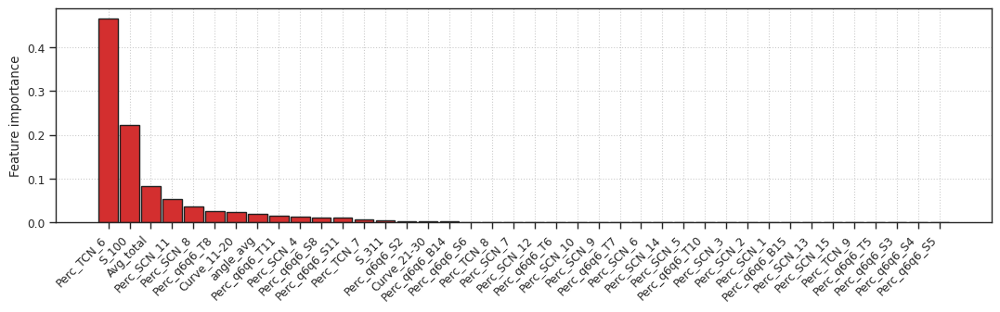

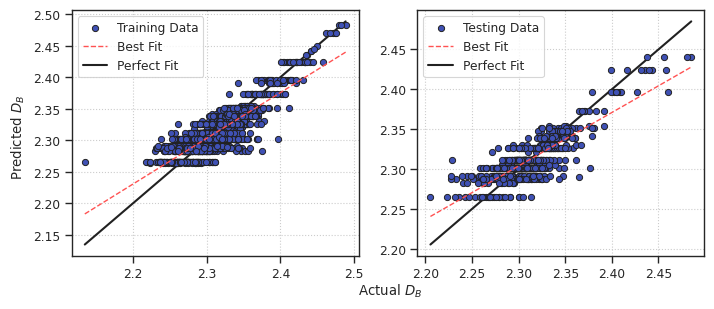

...

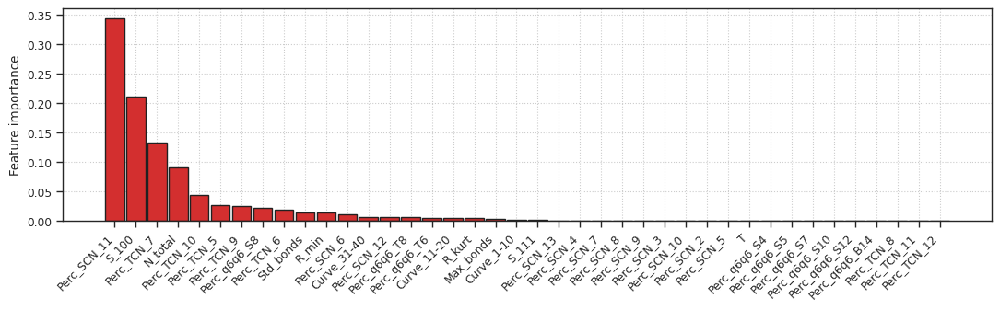

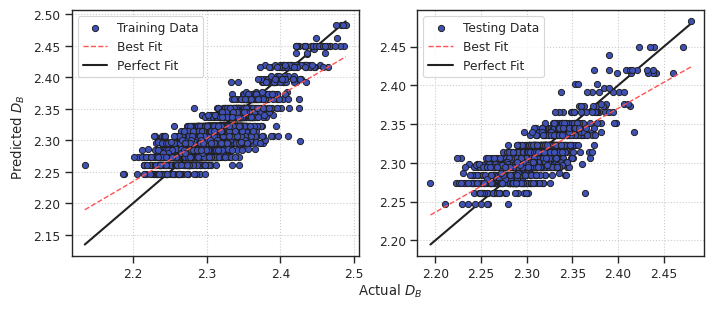

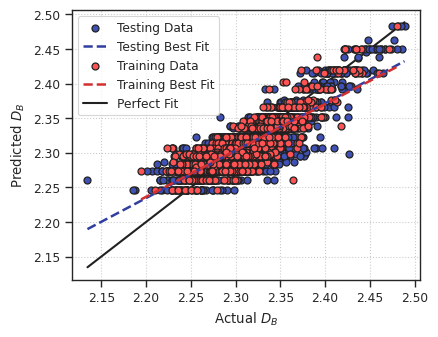

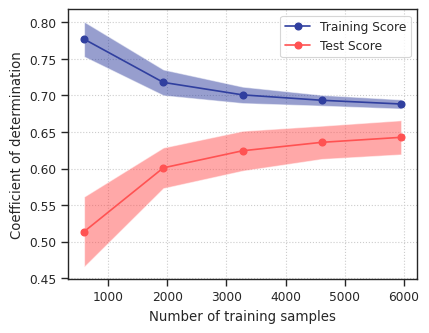

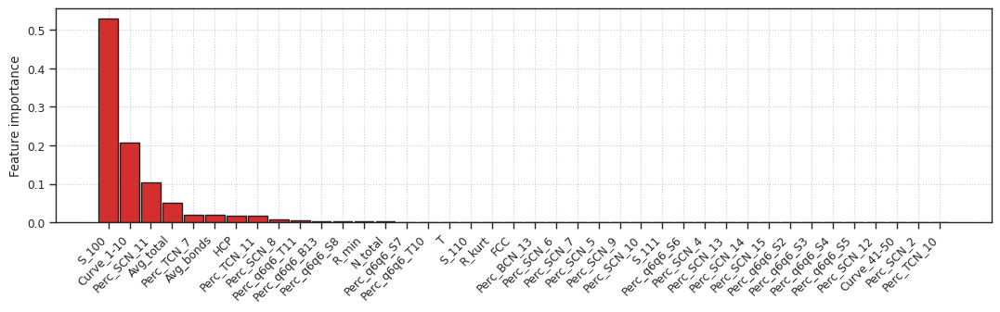

In [69]:
for mnp in X_Y_MNPS.keys():
    print(f"\nDataset: {mnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]
    
    estimator = DecisionTreeRegressor(criterion='squared_error', splitter='best', max_depth=None, 
                                      min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, 
                                      max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0, ccp_alpha=0.0,
                                      random_state=RANDOM_SEED)
    paramGrid = {'criterion': ['squared_error', 'absolute_error', 'poisson'], # 'friedman_mse', 
                 'splitter': ['best', 'random'], 
                 'max_depth' : [3, 5, None], 
                 'max_features': ['sqrt', 'log2', None]}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

    dtReg = searchResults.best_estimator_
    yPredTrainDTR, yPredTestDTR, dtReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                  model=dtReg, modelName='DTR', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                  showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### ExtRa Tree Regressor


Dataset: Au
Best score: 0.613
Best parameter combination: {'criterion': 'absolute_error', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}
  Running ETR
  Trained and tested using coefficient of determination.
    Training score: 0.722
    Testing score:
      Mean absolute error: 0.011812
      Mean squared error: 0.000243
      Root mean squared error: 0.015578
      Coefficient of determination: 0.668


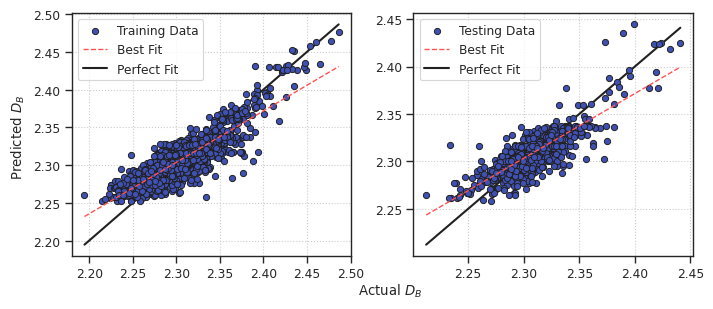

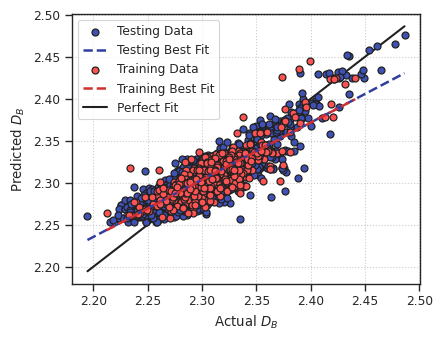

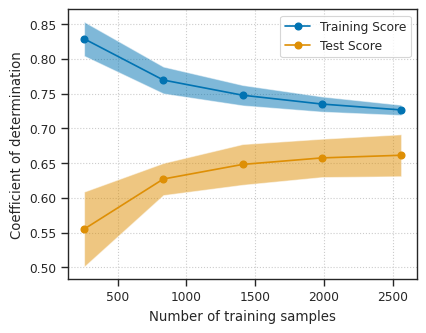

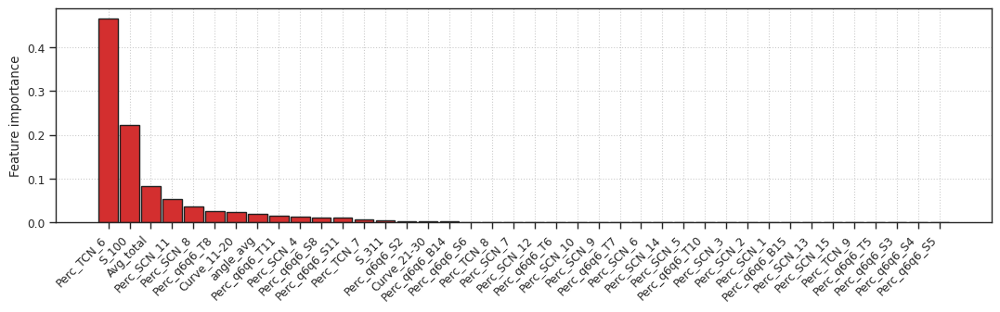


Dataset: Pd
Best score: 0.696
Best parameter combination: {'criterion': 'squared_error', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}
  Running ETR
  Trained and tested using coefficient of determination.
    Training score: 0.754
    Testing score:
      Mean absolute error: 0.012304
      Mean squared error: 0.000276
      Root mean squared error: 0.016628
      Coefficient of determination: 0.734


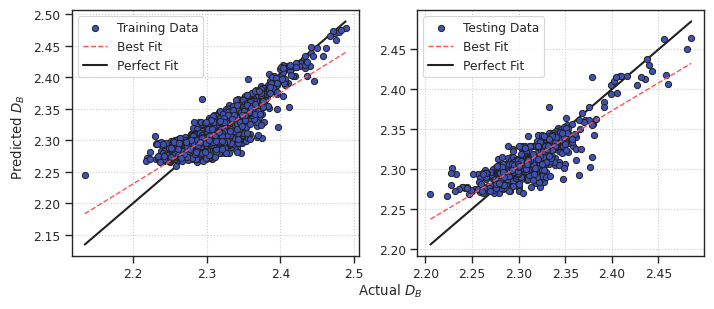

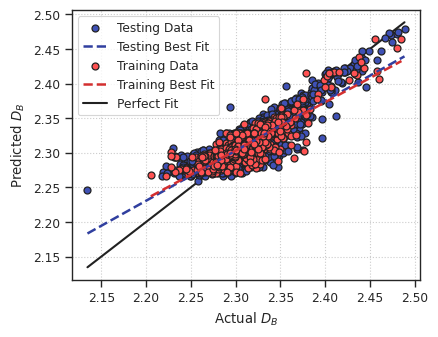

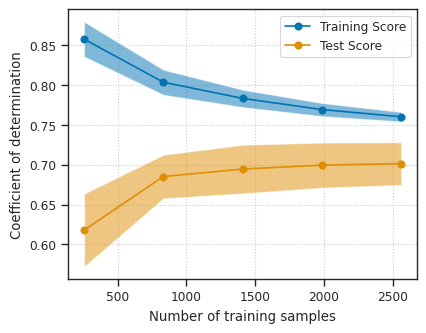

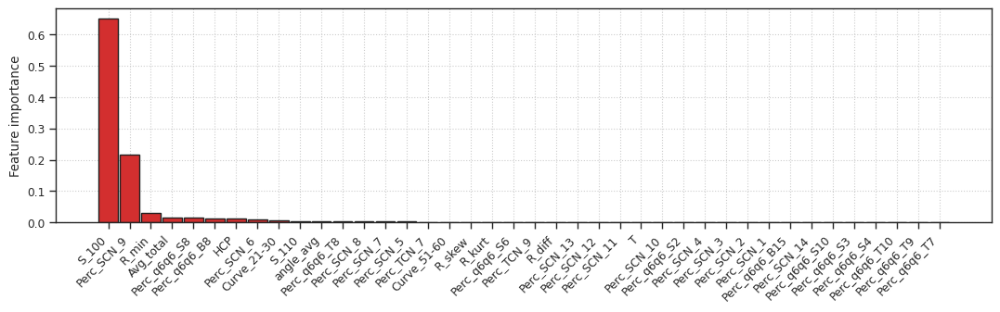


Dataset: Pt
Best score: 0.478
Best parameter combination: {'criterion': 'absolute_error', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}
  Running ETR
  Trained and tested using coefficient of determination.
    Training score: 0.830
    Testing score:
      Mean absolute error: 0.012804
      Mean squared error: 0.000365
      Root mean squared error: 0.019108
      Coefficient of determination: 0.625


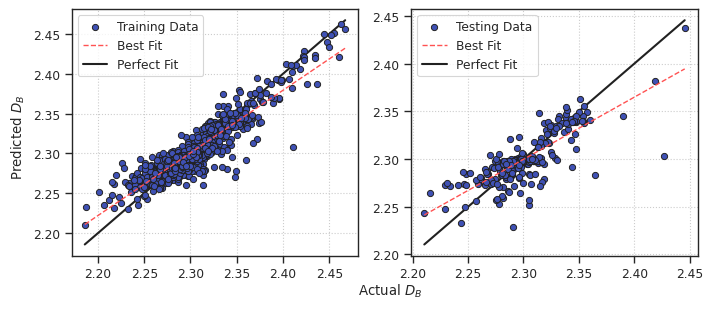

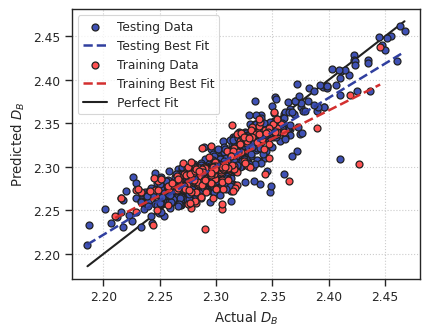

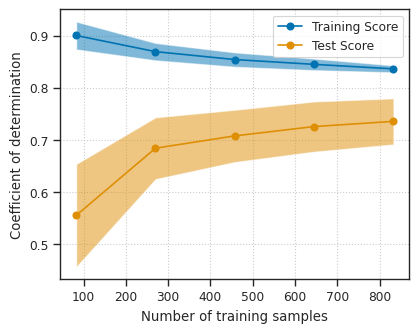

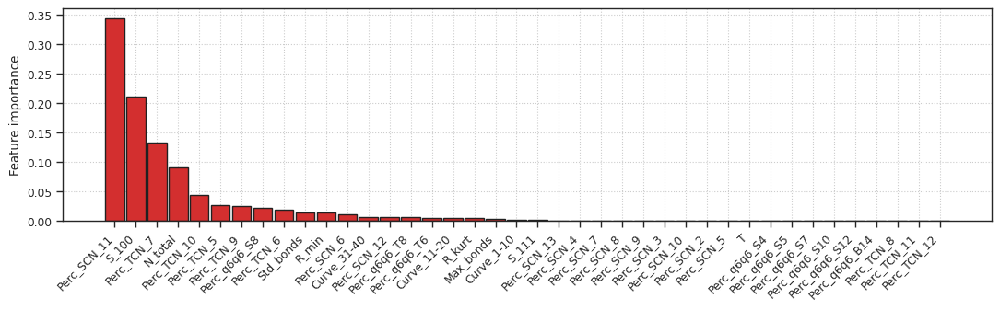


Dataset: MNP
Best score: 0.650
Best parameter combination: {'criterion': 'squared_error', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}
  Running ETR
  Trained and tested using coefficient of determination.
    Training score: 0.716
    Testing score:
      Mean absolute error: 0.012259
      Mean squared error: 0.000275
      Root mean squared error: 0.016574
      Coefficient of determination: 0.685


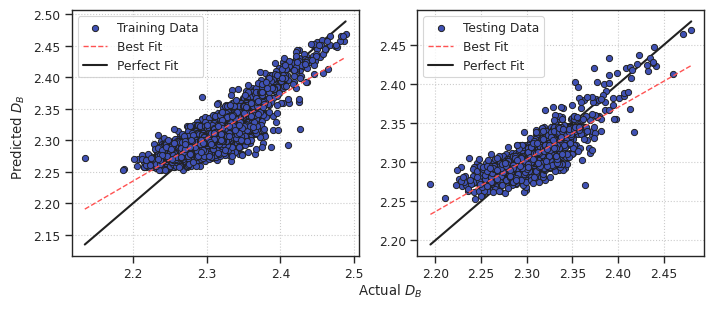

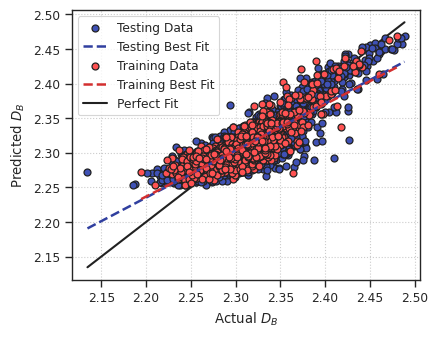

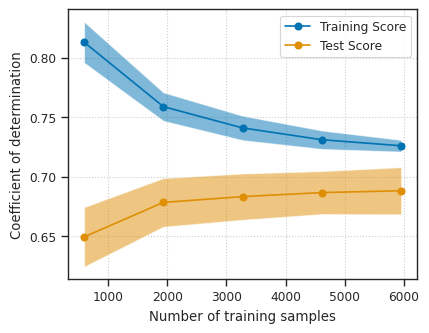

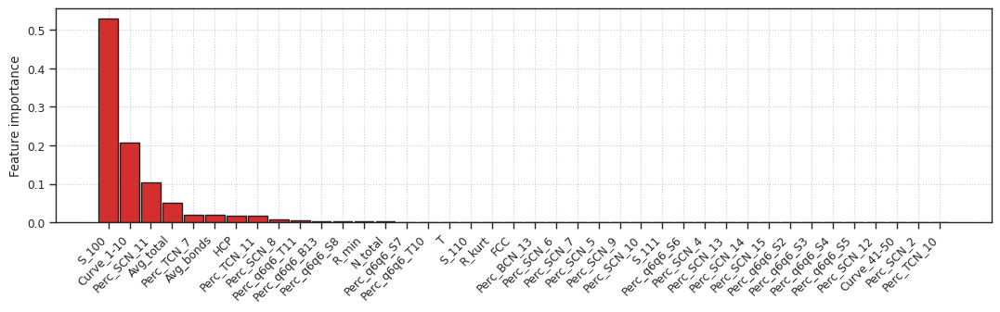

In [12]:
for mnp in X_Y_MNPS.keys():
    print(f"\nDataset: {mnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]
    
    estimator = ExtraTreeRegressor(criterion='squared_error', splitter='random', max_depth=None, 
                                   min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, 
                                   max_features=1.0, min_impurity_decrease=0.0, max_leaf_nodes=None, ccp_alpha=0.0,
                                   random_state=RANDOM_SEED)
    paramGrid = {'criterion': ['squared_error', 'friedman_mse', 'absolute_error', 'poisson'], 
                 'splitter': ['best', 'random'], 
                 'max_depth' : [3, 5, None], 
                 'max_features': ['sqrt', 'log2', None]}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)
    
    etReg = BaggingRegressor(searchResults.best_estimator_, random_state=RANDOM_SEED)
    yPredTrainETR, yPredTestETR, etReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                  model=etReg, modelName='ETR', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                  showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### Random Forest Regressor


Dataset: Au
Best score: 0.721
Best parameter combination: {'max_depth': 30, 'max_features': 'sqrt', 'min_samples_leaf': 5, 'min_samples_split': 5, 'n_estimators': 350}
  Running RFR
  Trained and tested using coefficient of determination.
    Training score: 0.868
    Testing score:
      Mean absolute error: 0.010725
      Mean squared error: 0.000204
      Root mean squared error: 0.014276
      Coefficient of determination: 0.721


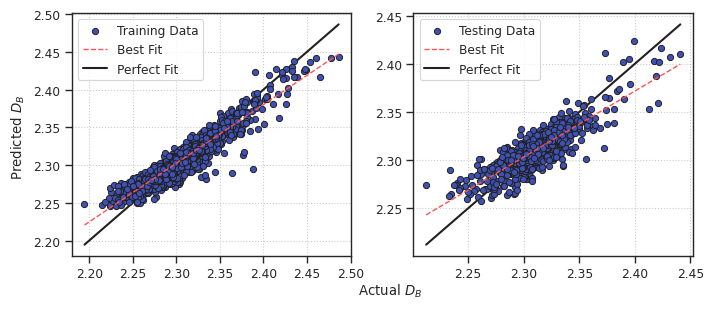

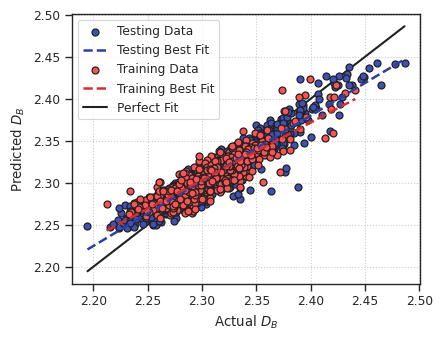

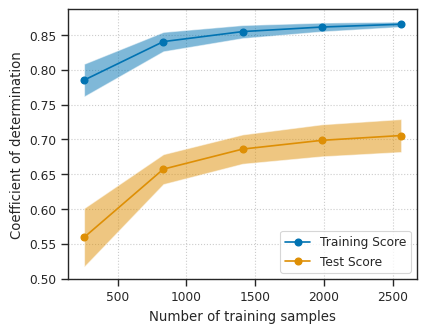

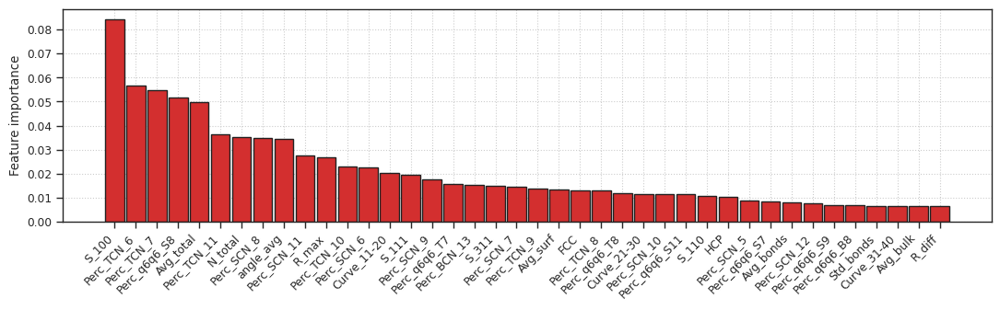


Dataset: Pd
Best score: 0.778
Best parameter combination: {'max_depth': 30, 'max_features': 'sqrt', 'min_samples_leaf': 5, 'min_samples_split': 5, 'n_estimators': 350}
  Running RFR
  Trained and tested using coefficient of determination.
    Training score: 0.880
    Testing score:
      Mean absolute error: 0.011245
      Mean squared error: 0.000231
      Root mean squared error: 0.015201
      Coefficient of determination: 0.778


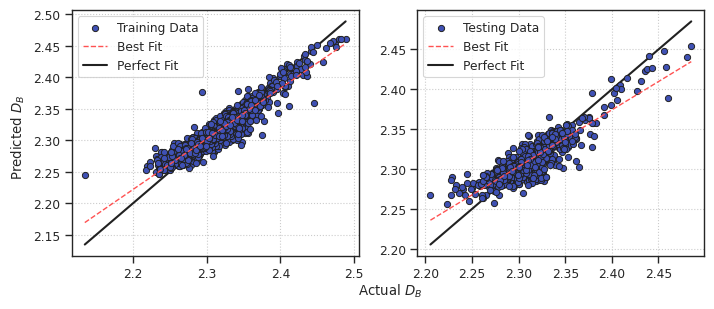

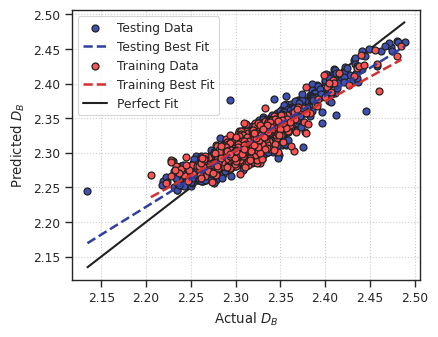

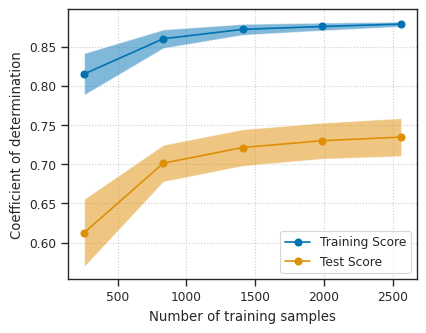

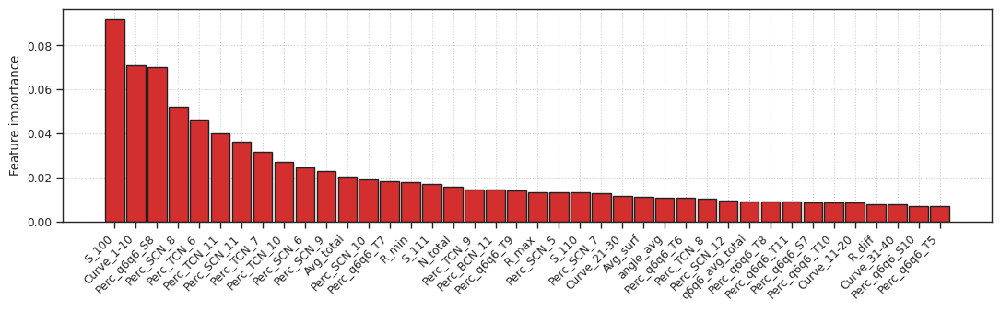


Dataset: Pt
Best score: 0.669
Best parameter combination: {'max_depth': 30, 'max_features': 'sqrt', 'min_samples_leaf': 5, 'min_samples_split': 5, 'n_estimators': 350}
  Running RFR
  Trained and tested using coefficient of determination.
    Training score: 0.887
    Testing score:
      Mean absolute error: 0.012391
      Mean squared error: 0.000323
      Root mean squared error: 0.017958
      Coefficient of determination: 0.669


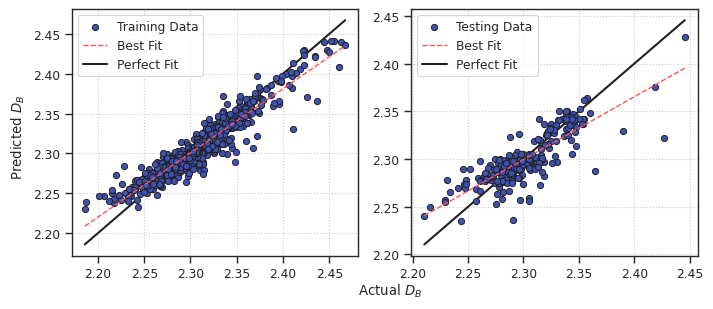

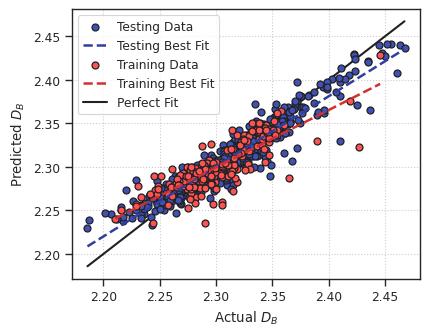

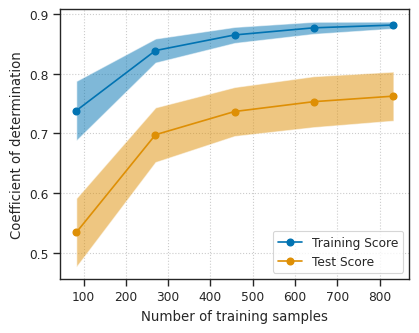

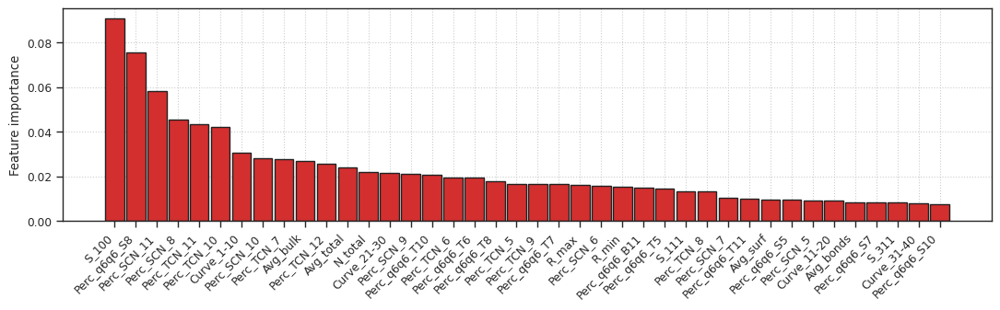


Dataset: MNP
Best score: 0.739
Best parameter combination: {'max_depth': 30, 'max_features': 'sqrt', 'min_samples_leaf': 5, 'min_samples_split': 5, 'n_estimators': 350}
  Running RFR
  Trained and tested using coefficient of determination.
    Training score: 0.883
    Testing score:
      Mean absolute error: 0.011047
      Mean squared error: 0.000228
      Root mean squared error: 0.015087
      Coefficient of determination: 0.739


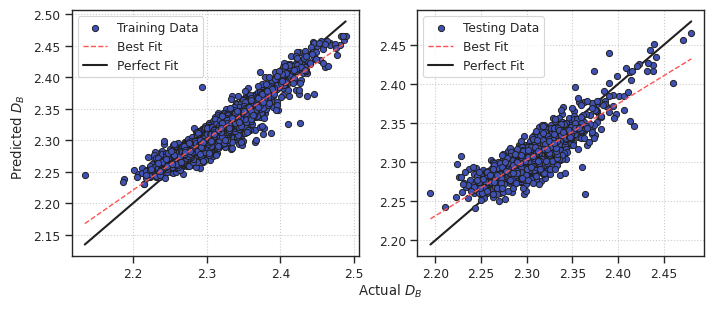

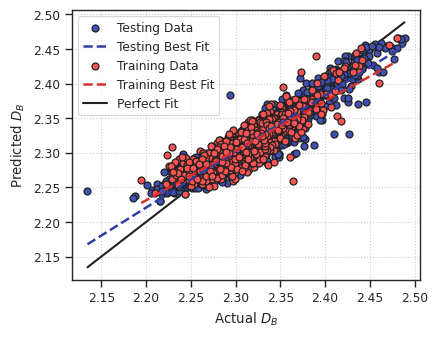

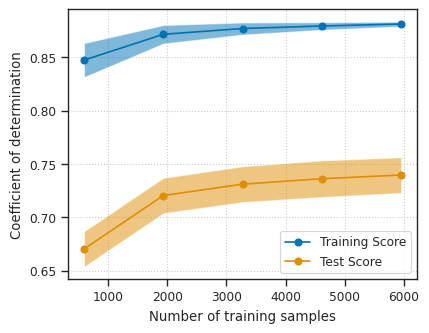

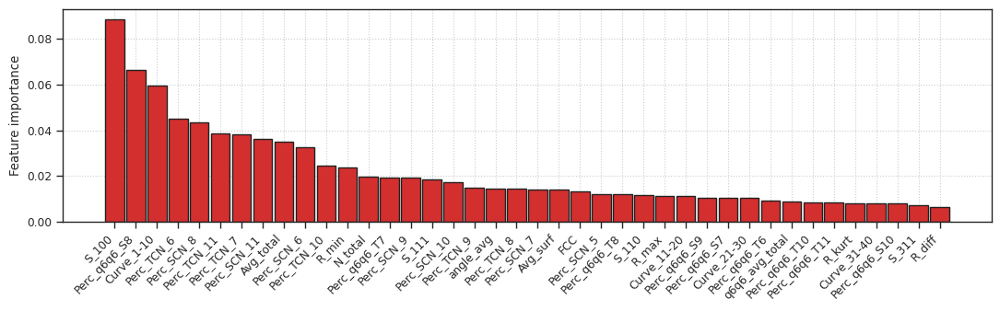

In [13]:
for mnp in X_Y_MNPS.keys():
    print(f"\nDataset: {mnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]
    
    estimator = RandomForestRegressor(n_estimators=100, criterion='squared_error', max_depth=8, min_samples_split=2, min_samples_leaf=1, 
                                      min_weight_fraction_leaf=0.0, max_features=1.0, max_leaf_nodes=None, min_impurity_decrease=0.0, 
                                      bootstrap=True, oob_score=False, n_jobs=None, random_state=RANDOM_SEED, verbose=0, warm_start=False, 
                                      ccp_alpha=0.0, max_samples=None)
    paramGrid = {'max_depth': [30], 
                 'max_features' : ['sqrt', 'log2', 1],  # 'log2', 1
                 'n_estimators': [350],
                 'min_samples_split': [5], 
                 'min_samples_leaf': [5]}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

    rfReg = searchResults.best_estimator_
    yPredTrainRFR, yPredTestRFR, rfReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                  model=rfReg, modelName='RFR', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                  showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

In [ ]:
# rfReg = RandomForestRegressor(n_estimators=300, criterion='friedman_mse', max_depth=10, min_samples_split=8, min_samples_leaf=5, 
#                               min_weight_fraction_leaf=0.0, max_features='sqrt', max_leaf_nodes=None, min_impurity_decrease=0.0, 
#                               bootstrap=True, oob_score=False, n_jobs=8, random_state=RANDOM_SEED, verbose=0, warm_start=False, ccp_alpha=0.0, max_samples=None)
# yPredTrain, yPredTest, model = evalModel(rfReg, Xtrain, yTrain, Xtest, yTest)

# Feature elimination
# impFeats = rfReg.feature_names_in_[rfReg.feature_importances_ > 0.02]
# XtrainNew = Xtrain[impFeats]
# XtestNew = Xtest[impFeats]
# yPredTrainRFR, yPredTestRFR, rfReg = runModel(XtrainNew, yTrain, XtestNew, yTest, 
#                                               model=rfReg, modelName='RFR', showFeatCoef=False, plotFeatImp=True, 
#                                               verbose=True, showFig=True)

#### ExtRa Trees Regressor


Dataset: Au
Best score: 0.718
Best parameter combination: {'criterion': 'squared_error', 'max_depth': 30, 'max_features': None, 'n_estimators': 300}
  Running ETsR
  Trained and tested using coefficient of determination.
    Training score: 1.000
    Testing score:
      Mean absolute error: 0.010806
      Mean squared error: 0.000207
      Root mean squared error: 0.014371
      Coefficient of determination: 0.718


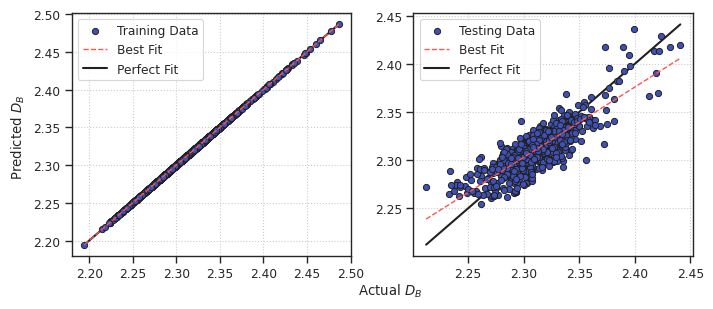

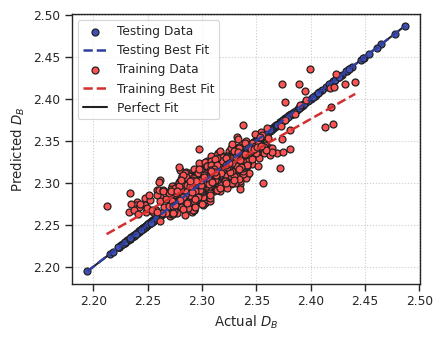

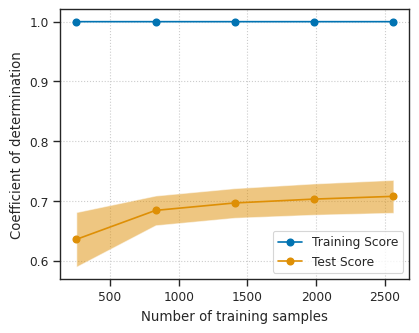

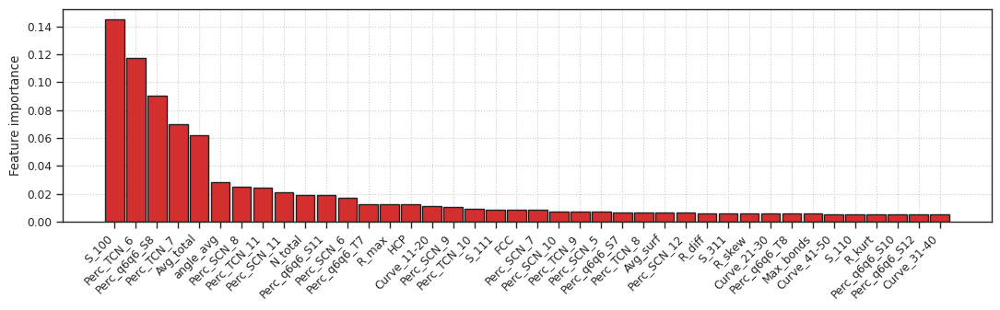


Dataset: Pd
Best score: 0.780
Best parameter combination: {'criterion': 'absolute_error', 'max_depth': 10, 'max_features': None, 'n_estimators': 300}
  Running ETsR
  Trained and tested using coefficient of determination.
    Training score: 0.895
    Testing score:
      Mean absolute error: 0.011237
      Mean squared error: 0.000228
      Root mean squared error: 0.015113
      Coefficient of determination: 0.780


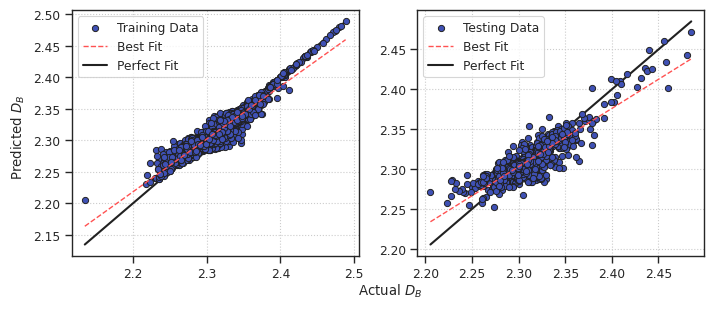

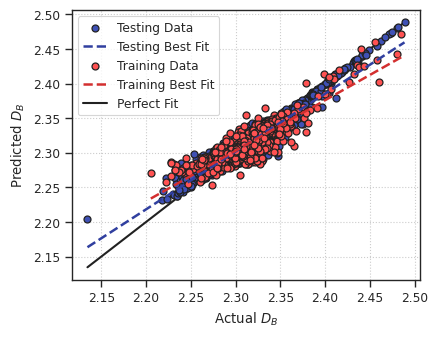

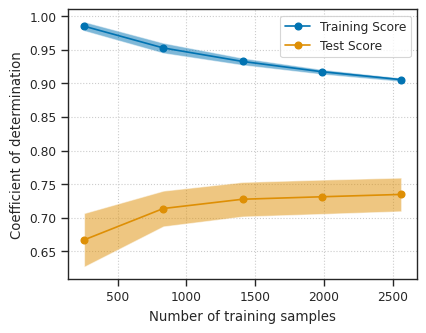

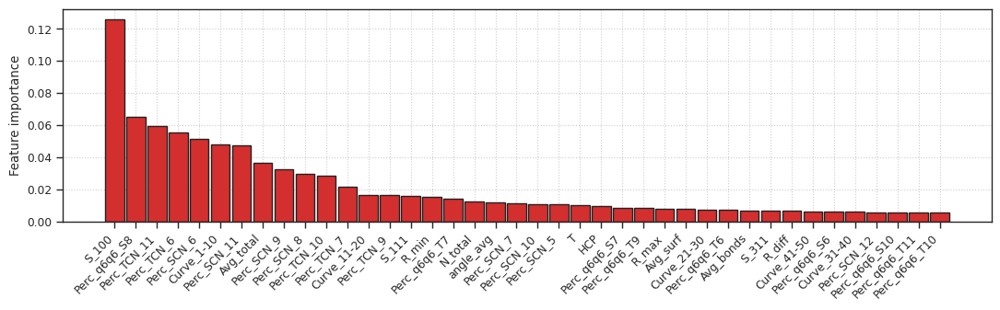


Dataset: Pt
Best score: 0.685
Best parameter combination: {'criterion': 'absolute_error', 'max_depth': 30, 'max_features': 'sqrt', 'n_estimators': 300}
  Running ETsR
  Trained and tested using coefficient of determination.
    Training score: 1.000
    Testing score:
      Mean absolute error: 0.012201
      Mean squared error: 0.000307
      Root mean squared error: 0.017528
      Coefficient of determination: 0.685


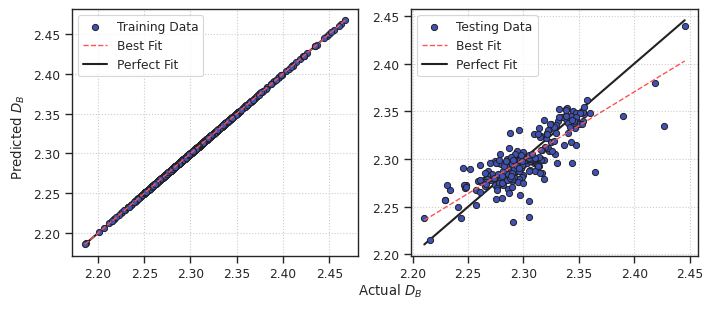

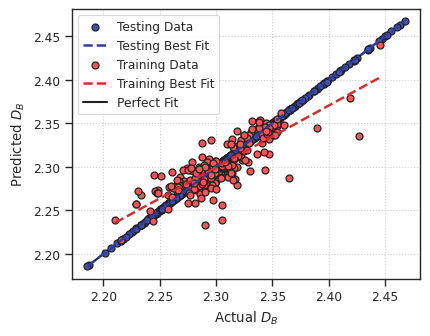

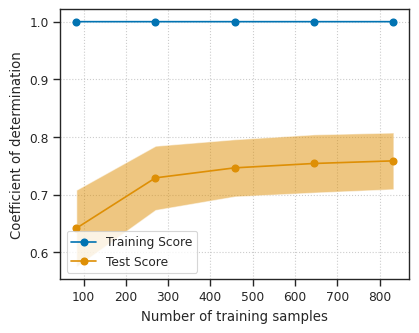

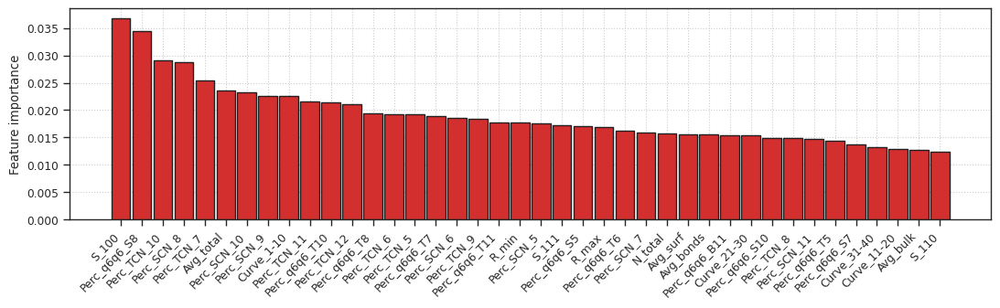


Dataset: MNP
Best score: 0.732
Best parameter combination: {'criterion': 'squared_error', 'max_depth': 30, 'max_features': 'log2', 'n_estimators': 300}
  Running ETsR
  Trained and tested using coefficient of determination.
    Training score: 1.000
    Testing score:
      Mean absolute error: 0.011154
      Mean squared error: 0.000234
      Root mean squared error: 0.015288
      Coefficient of determination: 0.732


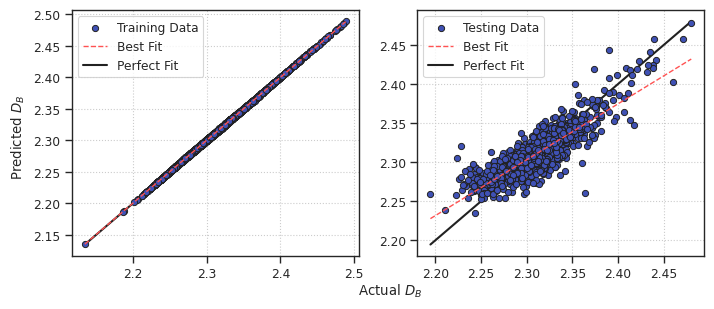

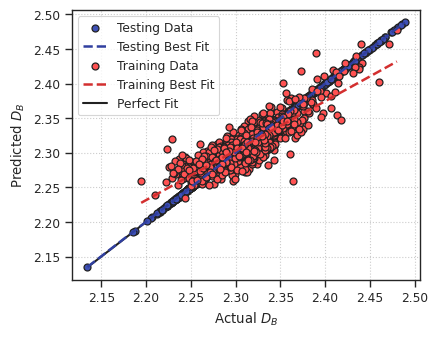

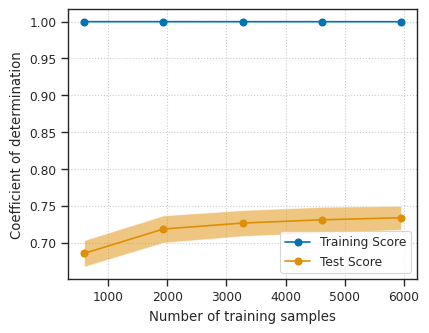

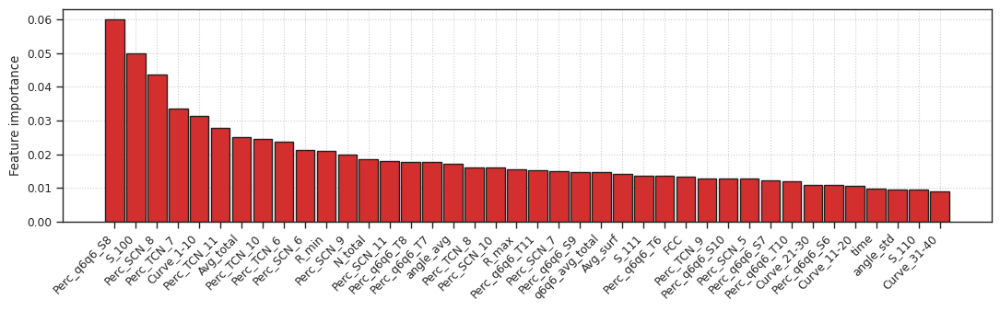

In [14]:
for mnp in X_Y_MNPS.keys():
    print(f"\nDataset: {mnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]
    
    estimator = ExtraTreesRegressor(n_estimators=100, criterion='squared_error', max_depth=5, 
                                    min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, 
                                    max_features=1.0, max_leaf_nodes=None, min_impurity_decrease=0.0, 
                                    bootstrap=False, oob_score=False, n_jobs=NUM_JOBS, random_state=RANDOM_SEED, verbose=0, 
                                    warm_start=False, ccp_alpha=0.0, max_samples=None)
    paramGrid = {'n_estimators': [100, 300], 
                 'criterion': ['squared_error', 'absolute_error', 'poisson'],  # 'friedman_mse', 
                 'max_depth' : [5, 10, 30], 
                 'max_features': ['sqrt', 'log2', None]}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)
    
    etsReg = searchResults.best_estimator_
    yPredTrainETsR, yPredTestETsR, etsReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                     model=etsReg, modelName='ETsR', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                     showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### Adaptive Boosting Forest Regressor


Dataset: Au
Best score: 0.678
Best parameter combination: {'learning_rate': 0.1, 'loss': 'exponential', 'n_estimators': 150}
  Running ABR
  Trained and tested using coefficient of determination.
    Training score: 0.688
    Testing score:
      Mean absolute error: 0.011725
      Mean squared error: 0.000235
      Root mean squared error: 0.015341
      Coefficient of determination: 0.678


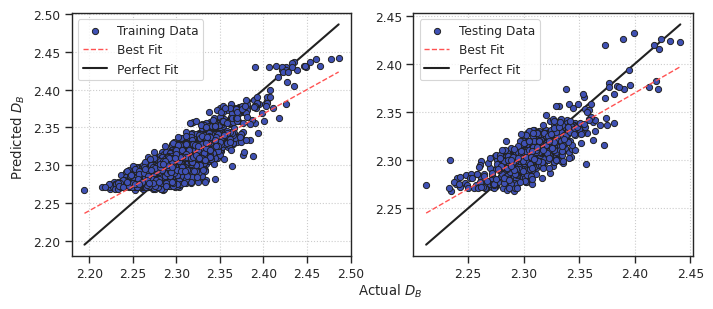

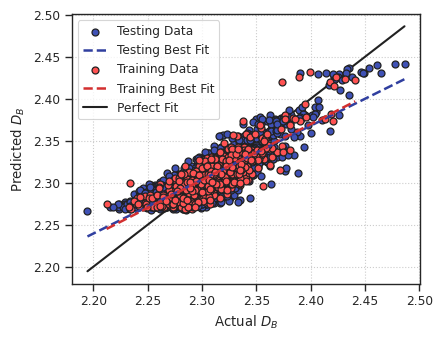

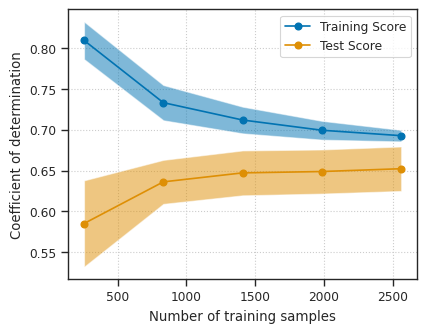

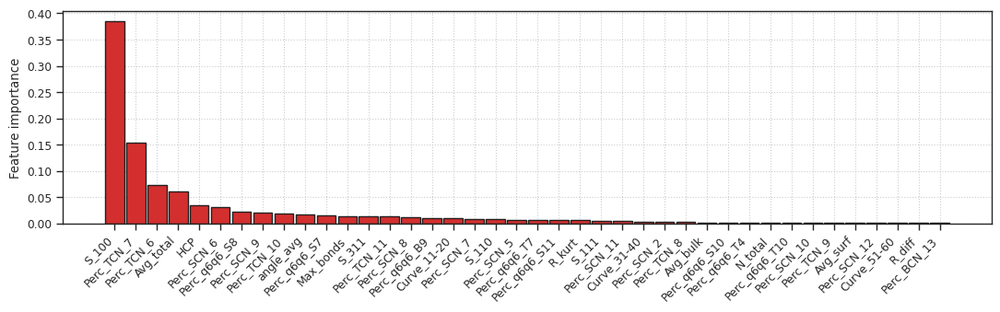


Dataset: Pd
Best score: 0.714
Best parameter combination: {'learning_rate': 1.0, 'loss': 'exponential', 'n_estimators': 100}
  Running ABR
  Trained and tested using coefficient of determination.
    Training score: 0.728
    Testing score:
      Mean absolute error: 0.012973
      Mean squared error: 0.000297
      Root mean squared error: 0.017235
      Coefficient of determination: 0.714


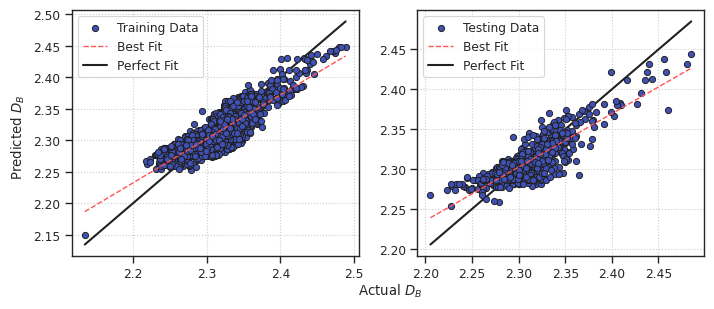

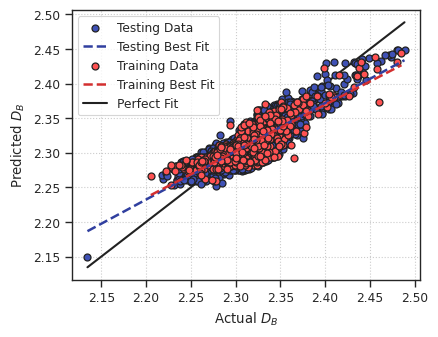

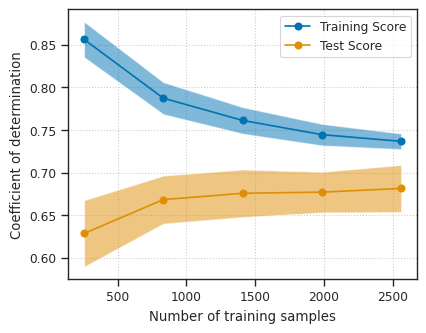

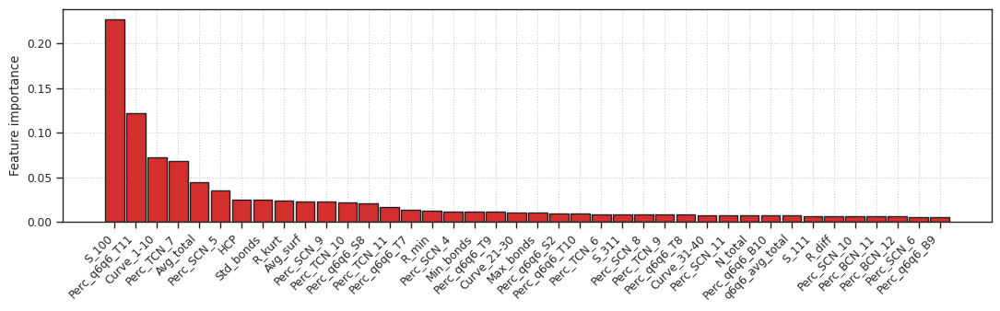


Dataset: Pt
Best score: 0.591
Best parameter combination: {'learning_rate': 1.0, 'loss': 'exponential', 'n_estimators': 50}
  Running ABR
  Trained and tested using coefficient of determination.
    Training score: 0.797
    Testing score:
      Mean absolute error: 0.014147
      Mean squared error: 0.000399
      Root mean squared error: 0.019964
      Coefficient of determination: 0.591


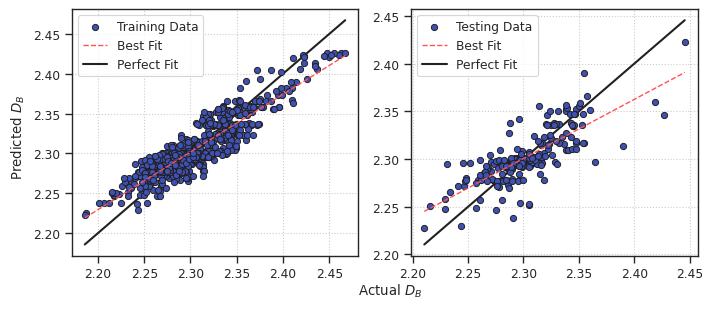

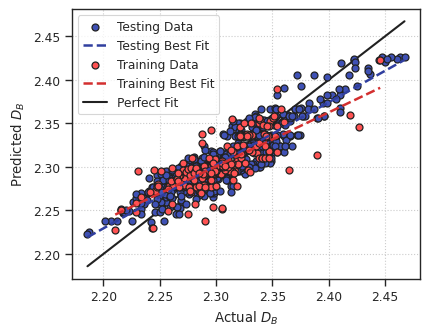

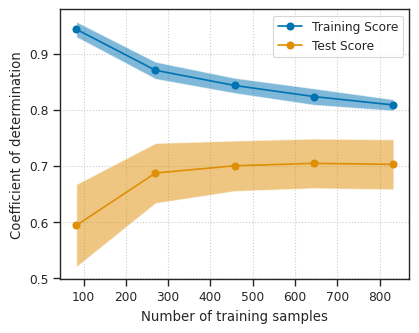

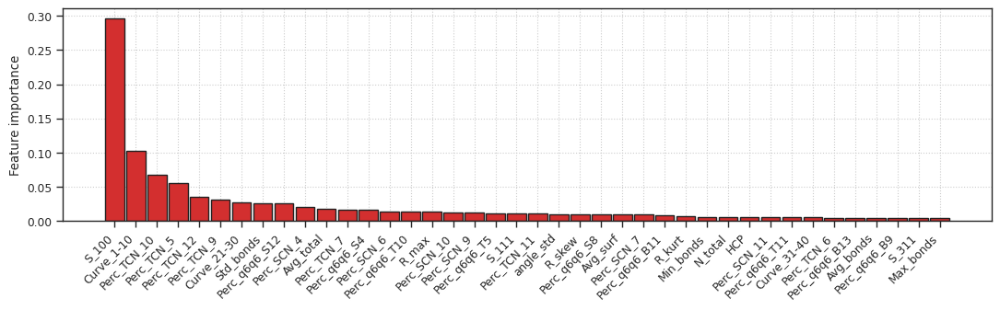


Dataset: MNP
Best score: 0.645
Best parameter combination: {'learning_rate': 1.0, 'loss': 'exponential', 'n_estimators': 50}
  Running ABR
  Trained and tested using coefficient of determination.
    Training score: 0.691
    Testing score:
      Mean absolute error: 0.013325
      Mean squared error: 0.000310
      Root mean squared error: 0.017604
      Coefficient of determination: 0.645


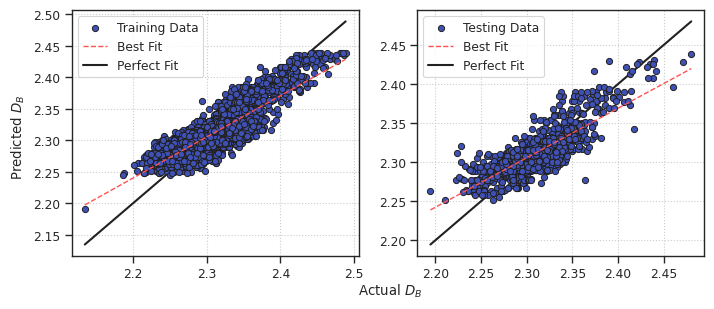

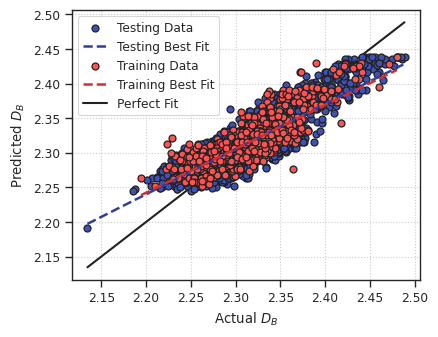

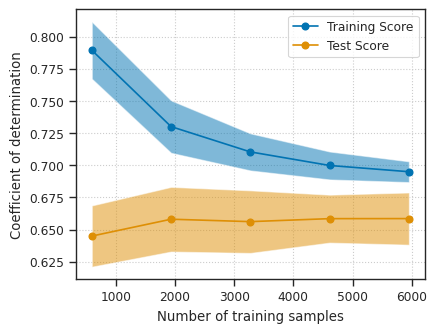

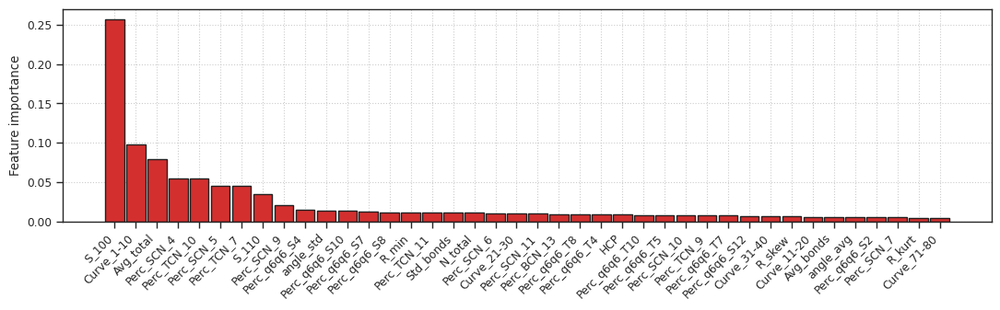

In [15]:
for mnp in X_Y_MNPS.keys():
    print(f"\nDataset: {mnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]
    
    estimator = AdaBoostRegressor(estimator=None, n_estimators=50, learning_rate=1.0, loss='linear', random_state=RANDOM_SEED)
    paramGrid = {'n_estimators': [50, 100, 150], 
                 'learning_rate': [0.1, 1.0, 10], 
                 'loss' : ['linear', 'square', 'exponential']}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

    abReg = searchResults.best_estimator_
    yPredTrainABR, yPredTestABR, abReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                  model=abReg, modelName='ABR', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                  showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### Extreme Gradient Boosting Regressor


Dataset: Au
[07:12:47] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[07:12:48] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[07:12:48] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[07:12:48] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[07:12:48] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[07:12:48] WARNING: /croot/xgboost-split_1675457761144/wo

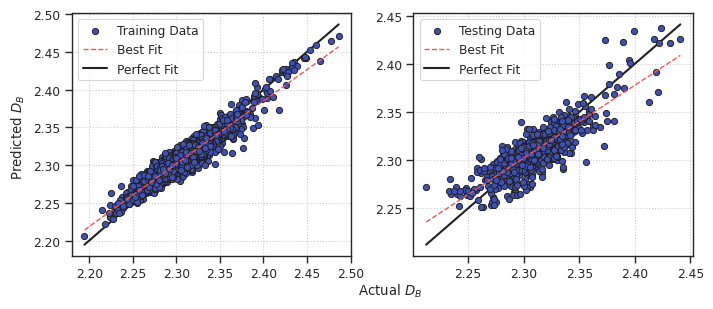

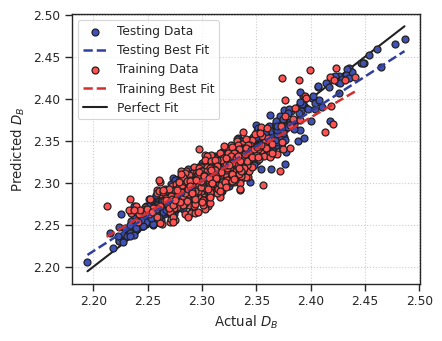

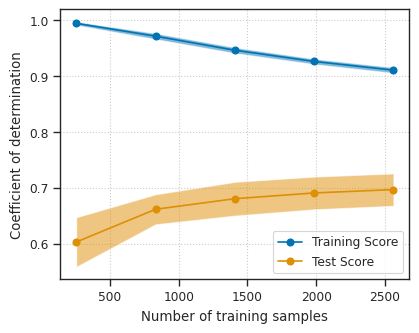

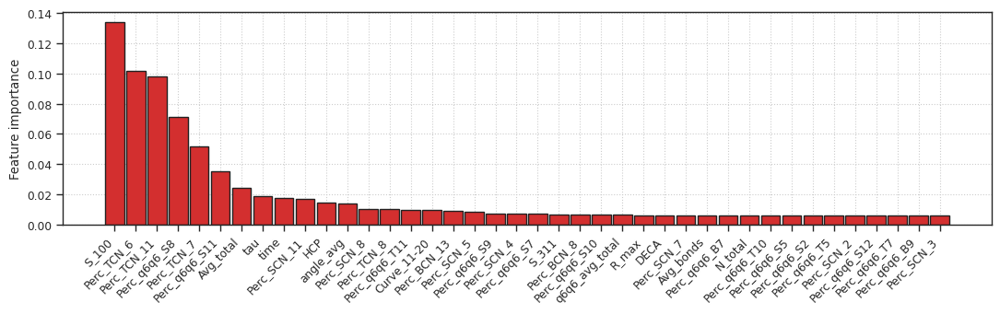


Dataset: Pd
[07:42:14] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[07:42:14] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[07:42:14] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[07:42:14] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[07:42:14] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[07:42:14] WARNING: /croot/xgboost-split_1675457761144/wo

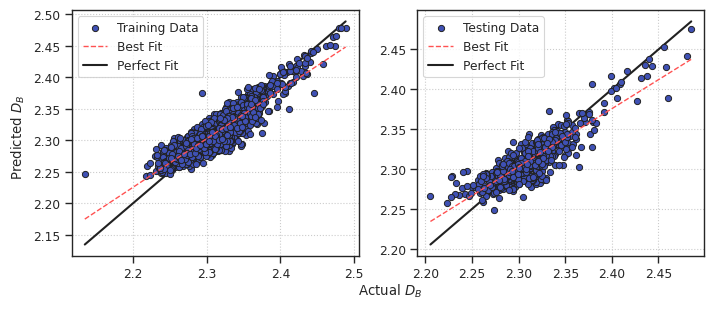

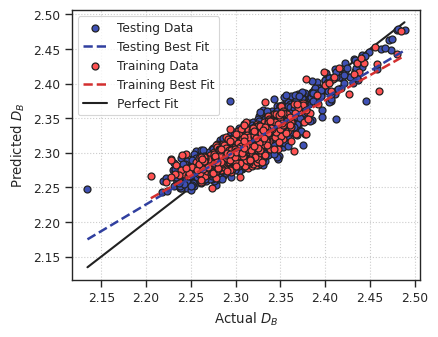

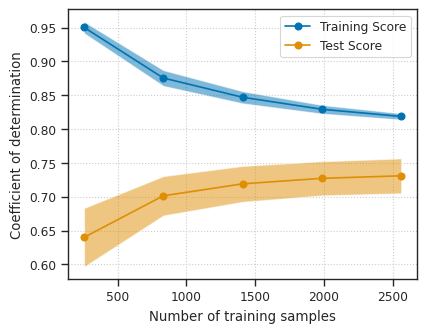

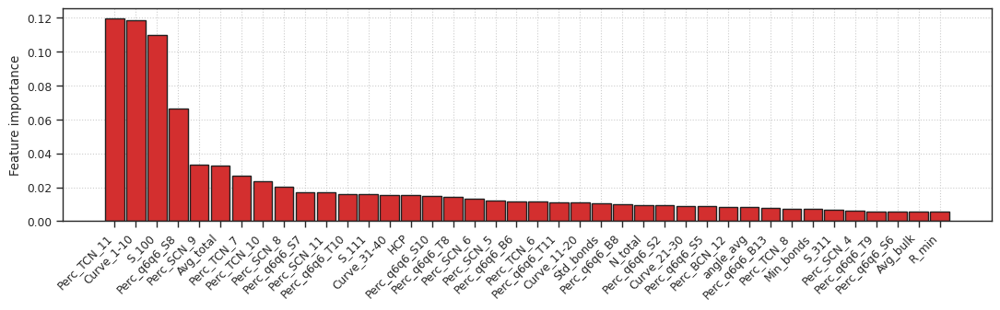


Dataset: Pt
[08:06:28] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[08:06:28] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[08:06:28] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[08:06:29] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[08:06:29] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[08:06:29] WARNING: /croot/xgboost-split_1675457761144/wo

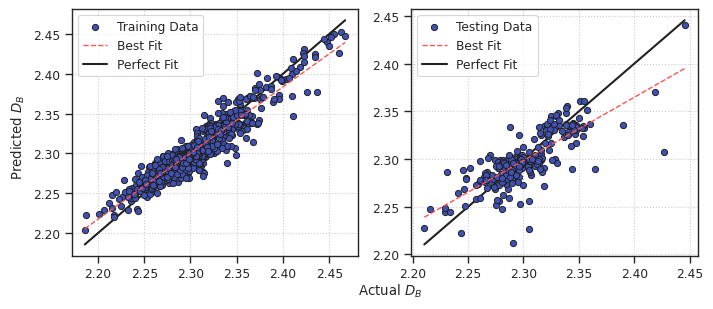

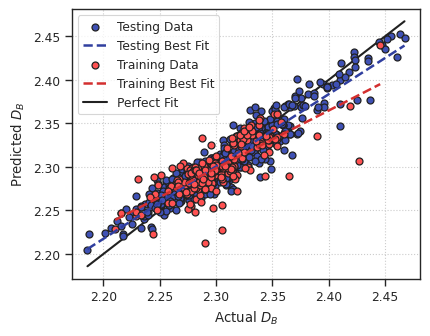

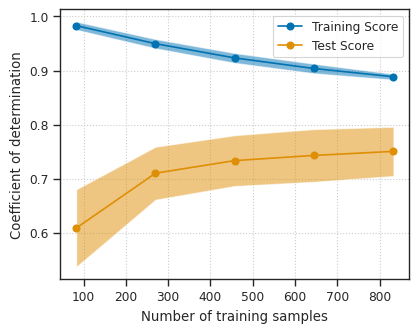

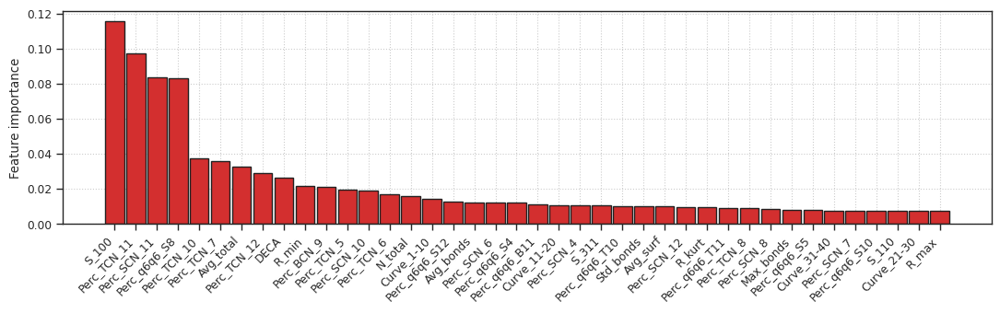


Dataset: MNP
[08:30:59] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[08:30:59] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[08:31:00] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[08:31:00] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[08:31:00] WARNING: /croot/xgboost-split_1675457761144/work/src/learner.cc:767: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

[08:31:00] WARNING: /croot/xgboost-split_1675457761144/w

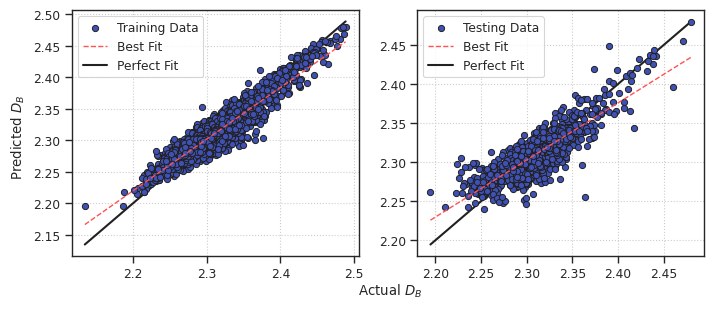

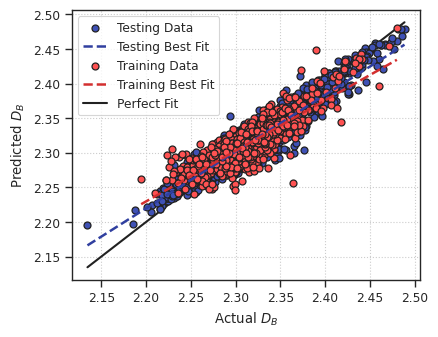

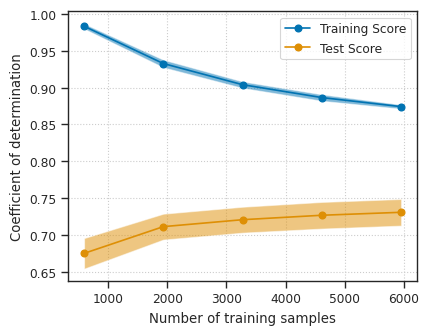

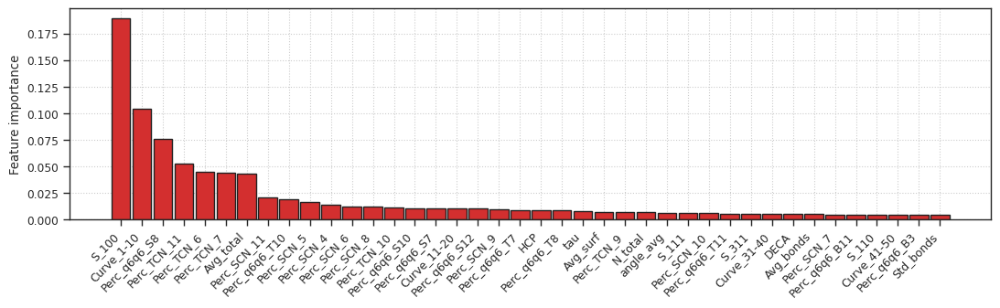

In [16]:
for mnp in X_Y_MNPS.keys():
    print(f"\nDataset: {mnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]
    
    estimator = XGBRegressor(verbosity=1, n_jobs=NUM_JOBS, importance_type='gain')
    # n_estimators=100, max_depth=5, max_leaves=0, max_bin=15, grow_policy='depthwise', learning_rate=0.01, verbosity=3, 
    # objective=None, booster='gbtree', tree_method='hist', n_jobs=NUM_JOBS, 
    # gamma=None, min_child_weight=None, 
    # subsample=None, sampling_method=None, colsample_bytree=None, colsample_bylevel=None, colsample_bynode=None, 
    # reg_alpha=None, reg_lambda=None, scale_pos_weight=None, base_score=None, random_state=RANDOM_SEED, 
    # missing=None, num_parallel_tree=None, monotone_constraints=None, interaction_constraints=None, importance_type='gain', 
    # eval_metric=mean_squared_error, early_stopping_rounds=None, max_delta_step=None
    paramGrid = {'n_estimators': [50, 100], 
                 'booster': ['gbtree', 'gblinear', 'dart'], 
                 'learning_rate': [0.01, 0.1],
                 'min_child_weight': [1, 3, 5],
                 'gamma': [0, 1, 3], 
                 'max_depth' : [3, 6, 9], 
                 'colsample_bytree': [0.5, 1], 
                 'subsample': [0.5, 1]}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)
    
    xgbReg = searchResults.best_estimator_
    yPredTrainXGBR, yPredTestXGBR, xgbReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                     model=xgbReg, modelName='XGBR', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                     showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### Light Gradient Boosting Machine Regressor


Dataset: Au
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001909 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 19384
[LightGBM] [Info] Number of data points in the train set: 2560, number of used features: 91
[LightGBM] [Info] Start training from score 2.310865
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

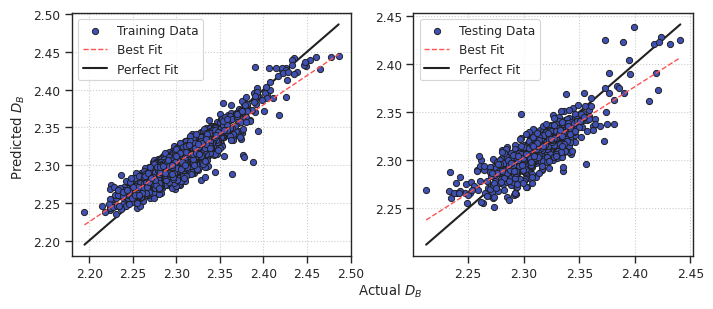

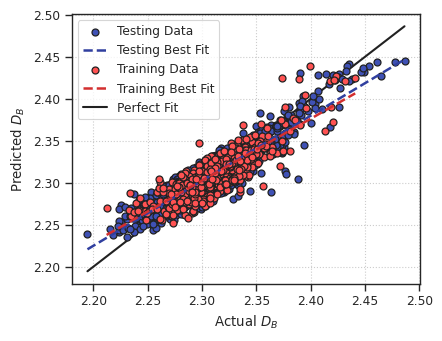

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001619 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16944
[LightGBM] [Info] Number of data points in the train set: 832, number of used features: 89
[LightGBM] [Info] Start training from score 2.311431
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

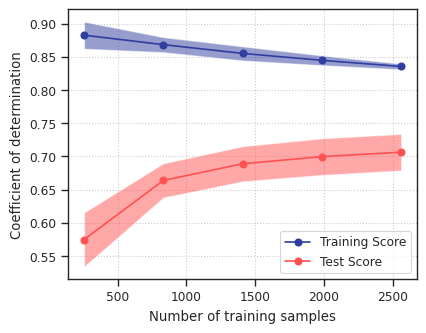

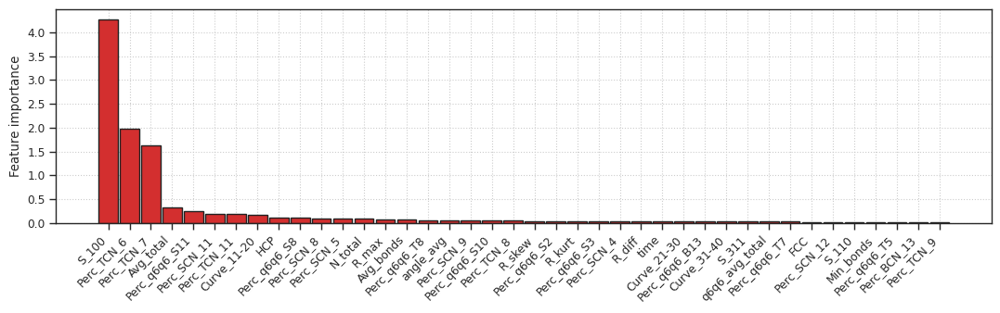


Dataset: Pd
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001813 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 19314
[LightGBM] [Info] Number of data points in the train set: 2560, number of used features: 90
[LightGBM] [Info] Start training from score 2.311606
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

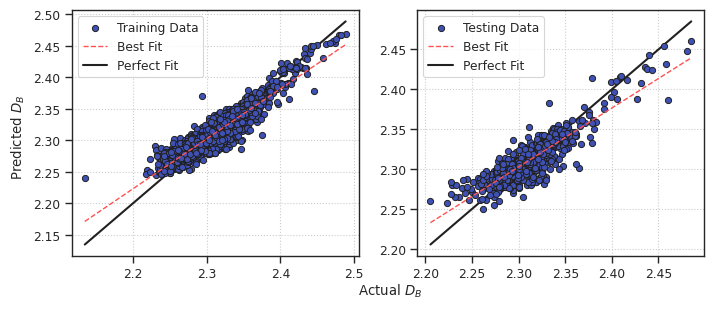

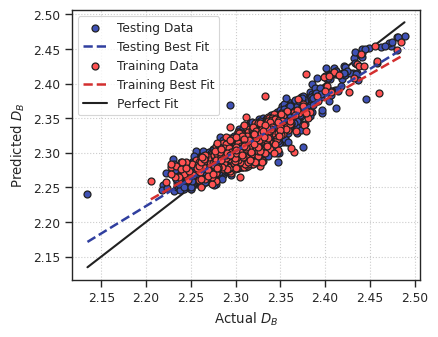

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explici

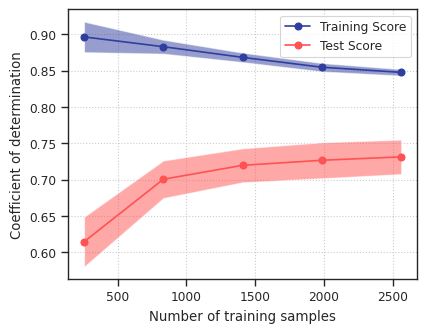

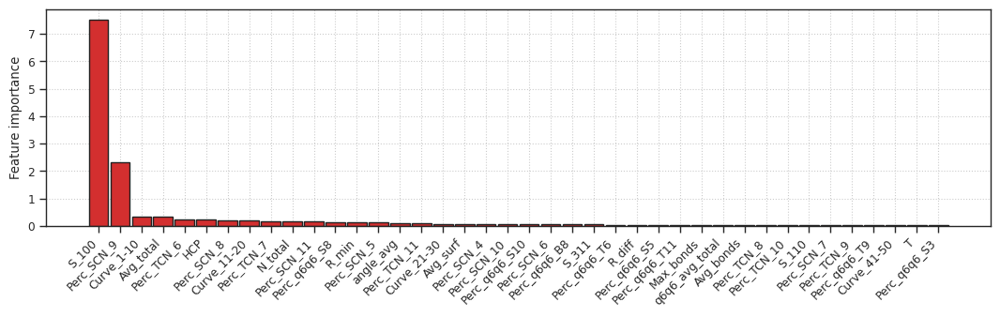


Dataset: Pt
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000701 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 14591
[LightGBM] [Info] Number of data points in the train set: 832, number of used features: 73
[LightGBM] [Info] Start training from score 2.303566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000588 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 15299
[LightGBM] [Info] Number of data points in the train set: 1040, number of used features: 75
[LightGBM] [Info] Start training from score 2.302991
[LightGB

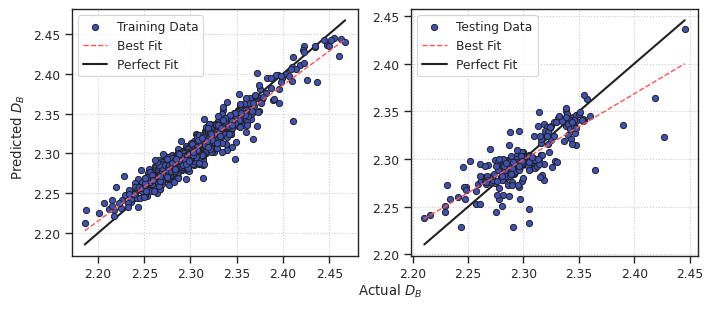

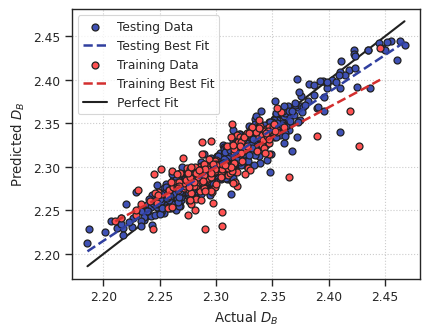

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explici

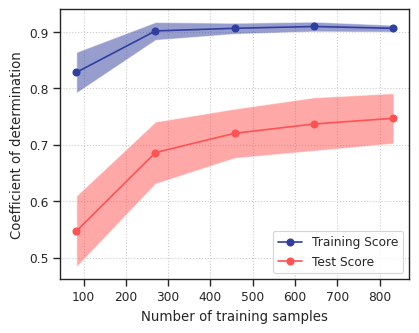

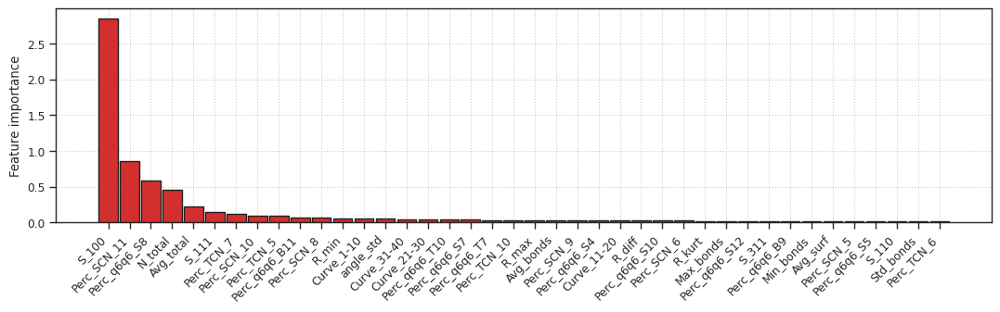


Dataset: MNP
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002191 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20169
[LightGBM] [Info] Number of data points in the train set: 5952, number of used features: 90
[LightGBM] [Info] Start training from score 2.309551
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature_fraction > 0.0f) at /croot/lightgbm_1700267924313/work/src/boosting/rf.hpp, line 36 .

[LightGBM] [Fatal] Check failed: (config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f) || (config->feature_fraction < 1.0f && config->feature

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
Best score: 0.732
Best parameter combination: {'boosting_type': 'gbdt', 'max_depth': 10, 'n_estimators': 50}
  Running LGBMR
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002314 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20363
[LightGBM] [Info] Number of data points in the train set: 7440, number of used features: 90
[LightGBM] [Info] Start training from score 2.309849
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [W

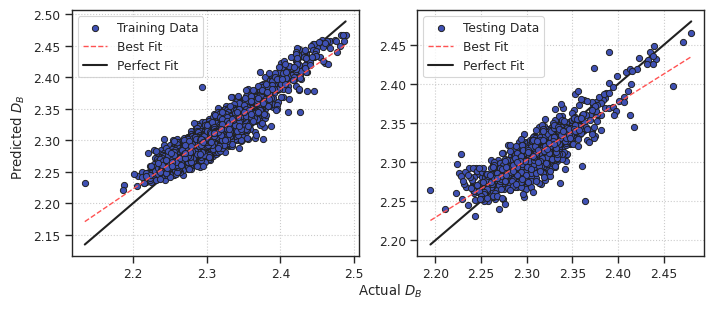

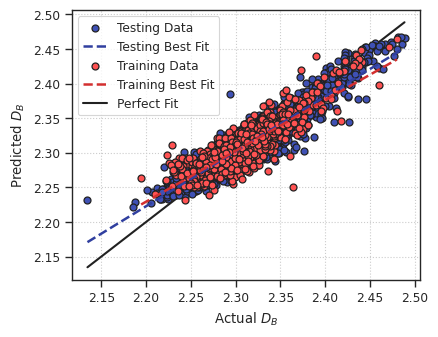

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves O

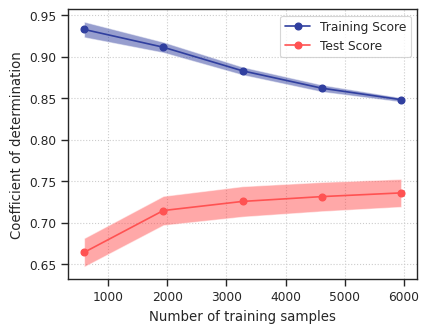

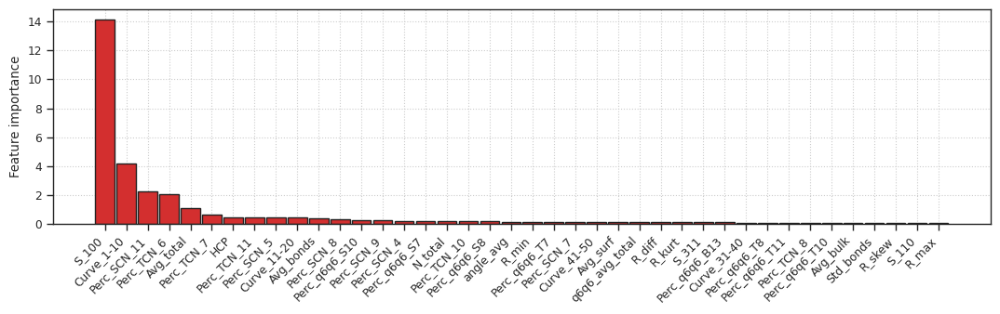

In [34]:
for mnp in X_Y_MNPS.keys():
    print(f"\nDataset: {mnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_MNPS[mnp]
    
    estimator = LGBMRegressor(boosting_type='gbdt', num_leaves=31, max_depth=20, learning_rate=0.1, n_estimators=100, subsample_for_bin=200000, objective=None, 
                              class_weight=None, min_split_gain=0.0, min_child_weight=0.001, min_child_samples=20, subsample=1.0, subsample_freq=0, colsample_bytree=1.0, 
                              reg_alpha=0.0, reg_lambda=0.0, random_state=RANDOM_SEED, n_jobs=NUM_JOBS, importance_type='gain')
    paramGrid = {'boosting_type': ['gbdt', 'dart', 'rf'], 
                 'max_depth' : [5, 10, 20], 
                 'n_estimators': [25, 50, 100, 250]}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

    lgbmReg = searchResults.best_estimator_
    yPredTrainLGBMR, yPredTestLGBMR, lgbmReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                    model=lgbmReg, modelName='LGBMR', datasetName=mnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                    showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

<a id='bnps'></a>
## Bimetallic Nanoparticles

Here we attempt to train a machine learning model that aims to predict the $D_B$ values of a set of simulated bimetallic nanoparticles (combinations of gold, palladium, or platinum), study the feature importance profile to understand the influential features in the prediction of the $D_B$ values, and investigate the conditions that give rise to rougher nanoparticles.

### Data Loading

In [43]:
with open('data/processedBNPdata.pickle', 'rb') as f:
    BNPsDF = pickle.load(f)
AuPdNPDF, AuPtNPDF, PdPtNPDF, BNPNPDF = BNPsDF

In [44]:
XtrainAuPdNP, XtestAuPdNP, yTrainAuPdNP, yTestAuPdNP = splitScaleData(df=AuPdNPDF, polyFeats=POLY_FEATS, scaling=SCALING, verbose=True)
XtrainAuPtNP, XtestAuPtNP, yTrainAuPtNP, yTestAuPtNP = splitScaleData(df=AuPtNPDF, polyFeats=POLY_FEATS, scaling=SCALING, verbose=True)
XtrainPdPtNP, XtestPdPtNP, yTrainPdPtNP, yTestPdPtNP = splitScaleData(df=PdPtNPDF, polyFeats=POLY_FEATS, scaling=SCALING, verbose=True)
XtrainBNP, XtestBNP, yTrainBNP, yTestBNP = splitScaleData(df=BNPNPDF, polyFeats=POLY_FEATS, scaling=SCALING, verbose=True)
X_Y_MNPS = {'AuPd': (XtrainAuPdNP, XtestAuPdNP, yTrainAuPdNP, yTestAuPdNP), 
            'AuPt': (XtrainAuPtNP, XtestAuPtNP, yTrainAuPtNP, yTestAuPtNP), 
            'PdPt': (XtrainPdPtNP, XtestPdPtNP, yTrainPdPtNP, yTestPdPtNP), 
            'BNP': (XtrainBNP, XtestBNP, yTrainBNP, yTestBNP)}

Applying minmax scaling to feature values...
Applying minmax scaling to feature values...
Applying minmax scaling to feature values...
Applying minmax scaling to feature values...


### Models Training and Evaluation

The regression models as described above are trained on different bimetallic nanoparticle datasets (combinations of gold, palladium, and platinum, and all three datasets combined) without polynomial features, with features scaled via min-max normalisation.

#### Linear Regressor


Dataset: Au
  Running LinR
  Trained and tested using coefficient of determination.
    Training score: 0.714
    Testing score:
      Mean absolute error: 0.011150
      Mean squared error: 0.000216
      Root mean squared error: 0.014693
      Coefficient of determination: 0.705
Feature coefficients:
  N_total: 0.011
  R_max: 0.072
  R_kurt: 0.007
  S_100: 0.028
  S_110: 0.028
  S_311: 0.056
  Avg_bonds: 0.005
  Min_bonds: 0.002
  Perc_BCN_7: 0.003
  Perc_BCN_13: 0.066
  Perc_BCN_14: 0.067
  Perc_BCN_15: 0.015
  Perc_BCN_16: 0.026
  Perc_BCN_17: 0.004
  Perc_q6q6_B3: 0.021
  Perc_q6q6_B6: 0.053
  Perc_q6q6_B11: 0.028
  Perc_q6q6_B13: 0.010
  Perc_q6q6_B14: 0.007
  Perc_SCN_9: 0.826
  Perc_SCN_10: 1.431
  Perc_SCN_11: 2.863
  Perc_SCN_12: 0.424
  Perc_SCN_13: 0.225
  Perc_SCN_14: 0.067
  Perc_SCN_15: 0.047
  Perc_q6q6_S2: 0.012
  Perc_q6q6_S3: 0.002
  Perc_q6q6_S6: 0.103
  Perc_q6q6_S7: 0.016
  Perc_q6q6_S11: 0.048
  Perc_q6q6_S13: 0.006
  Perc_q6q6_T4: 0.053
  Perc_q6q6_T5: 0.042
  

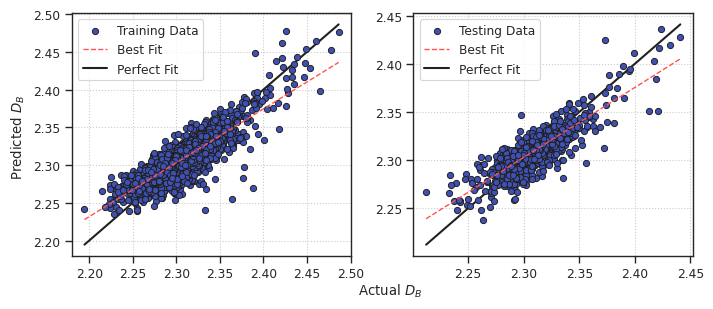

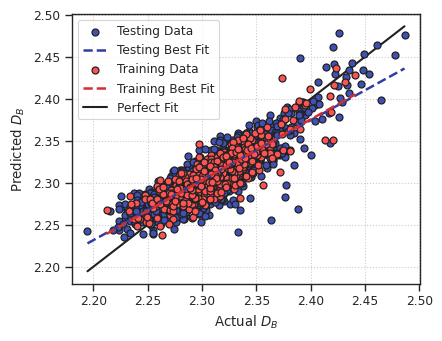

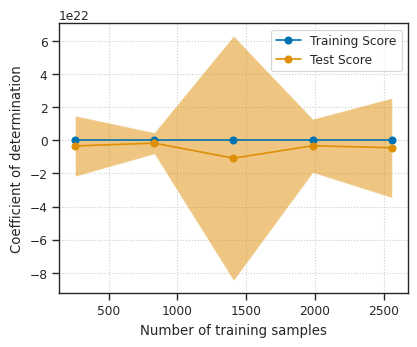

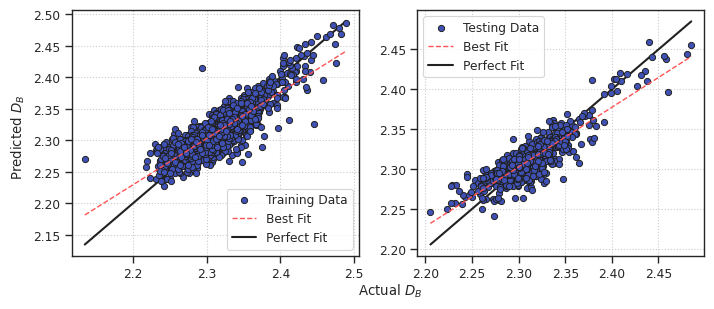

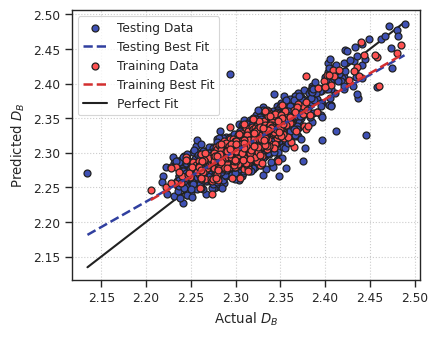

...

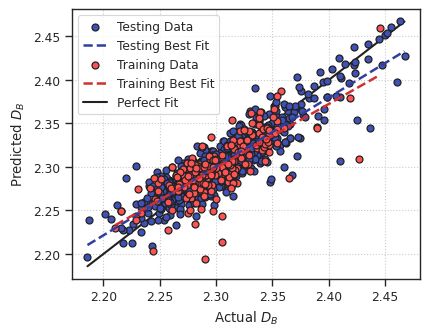

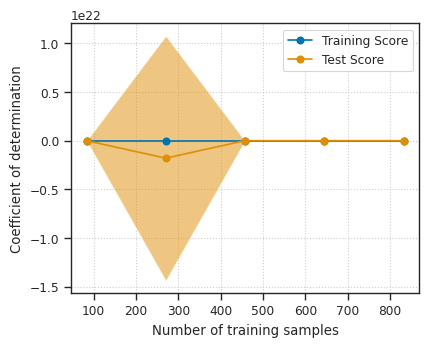

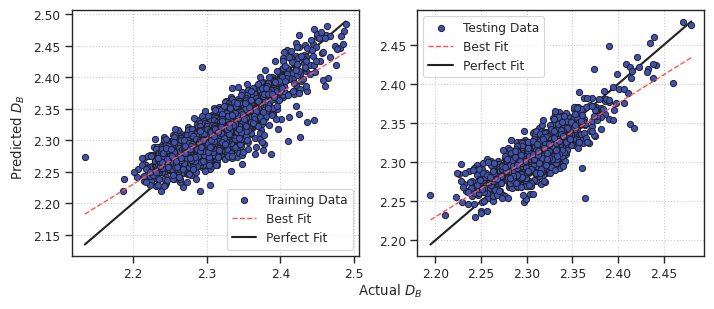

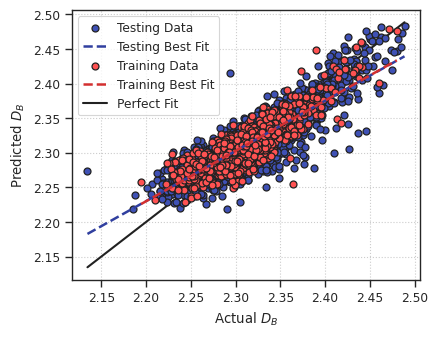

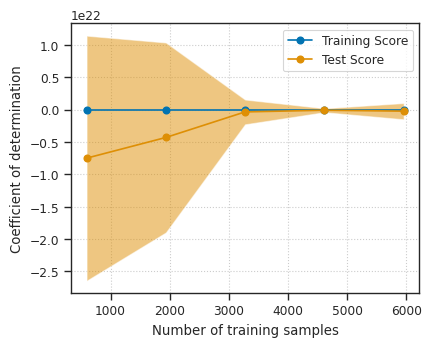

In [47]:
for bnp in X_Y_BNPS.keys():
    print(f"\nDataset: {bnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_BNPS[bnp]
    
    linReg = LinearRegression(positive=False, fit_intercept=True, 
                              copy_X=True, n_jobs=NUM_JOBS)
    yPredTrainLinR, yPredTestLinR, linReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                     model=linReg, modelName='LinR', datasetName=bnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                     showFeatCoef=True, plotFeatImp=False, verbose=True, showFig=True)

#### LASSO Regressor


Dataset: Au
  Running LASSO
  Trained and tested using coefficient of determination.
    Training score: 0.711
    Testing score:
      Mean absolute error: 0.011080
      Mean squared error: 0.000213
      Root mean squared error: 0.014609
      Coefficient of determination: 0.708
  Feature coefficients:
    R_max: 0.056
    R_kurt: 0.004
    S_100: 0.021
    S_110: 0.003
    S_311: 0.037
    Min_bonds: 0.003
    FCC: 0.007
    Perc_BCN_7: 0.001
    Perc_BCN_9: 0.005
    Perc_BCN_14: 0.016
    Perc_BCN_16: 0.018
    Perc_q6q6_B3: 0.007
    Perc_q6q6_B6: 0.034
    Perc_q6q6_B7: 0.001
    Perc_q6q6_B11: 0.026
    Perc_q6q6_B14: 0.005
    Perc_SCN_8: 0.115
    Perc_q6q6_S2: 0.008
    Perc_q6q6_S4: 0.005
    Perc_q6q6_S6: 0.077
    Perc_q6q6_S7: 0.017
    Perc_q6q6_S11: 0.034
    Perc_q6q6_S13: 0.005
    Perc_TCN_10: 0.007
    Perc_q6q6_T5: 0.020
    Perc_q6q6_T8: 0.043
    Perc_q6q6_T10: 0.012

Dataset: Pd
  Running LASSO
  Trained and tested using coefficient of determination.
    Trai

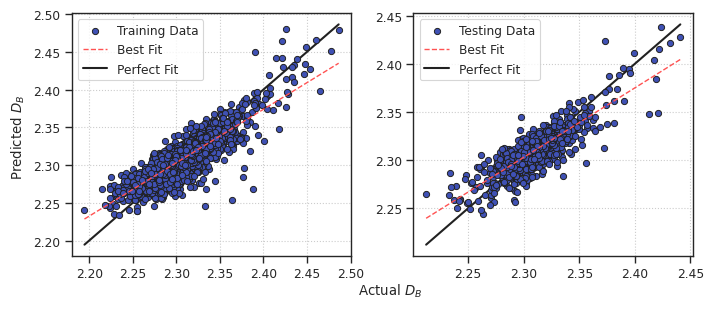

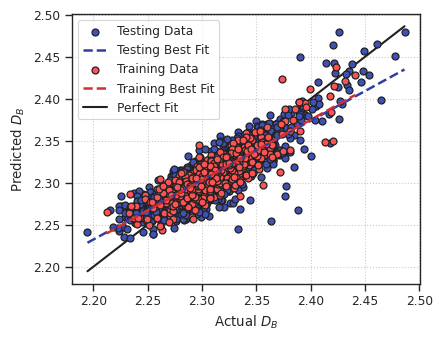

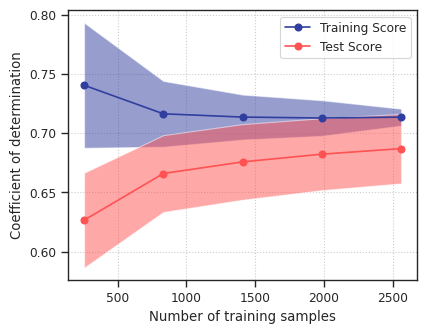

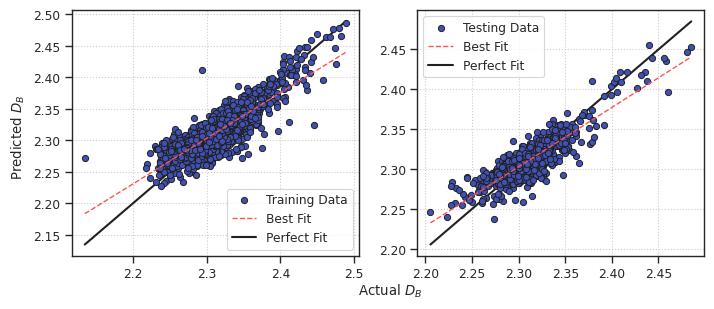

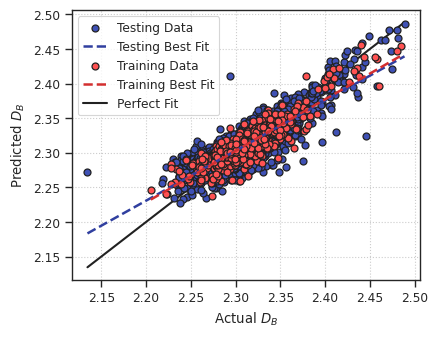

...

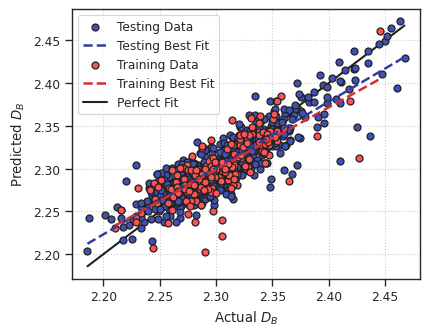

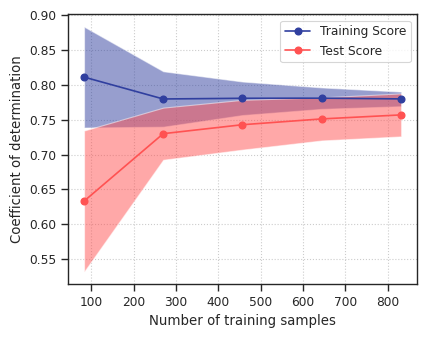

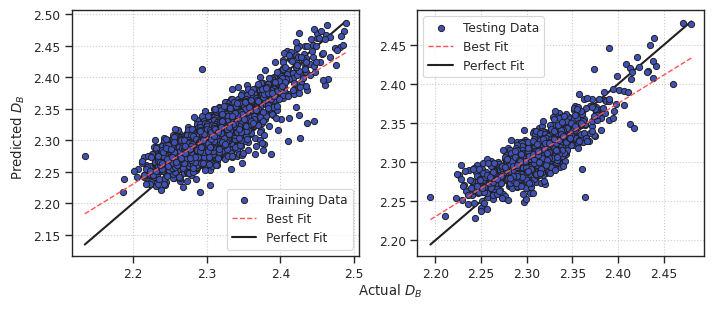

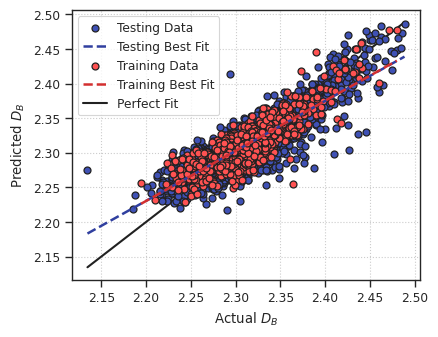

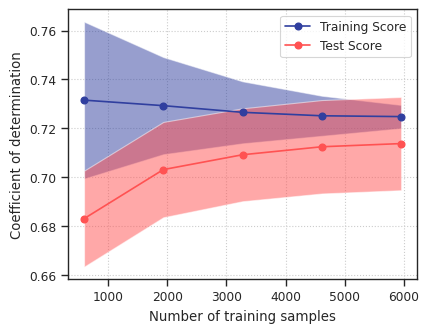

In [48]:
for bnp in X_Y_BNPS.keys():
    print(f"\nDataset: {bnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_BNPS[bnp]
    
    lassoReg = LassoLarsCV(fit_intercept=True, max_iter=500, cv=5, max_n_alphas=1000, positive=False, eps=np.finfo(float).eps, 
                           precompute='auto', n_jobs=NUM_JOBS, copy_X=True, verbose=False)
    yPredTrainLASSO, yPredTestLASSO, lassoReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                         model=lassoReg, modelName='LASSO', datasetName=bnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                         showFeatCoef=True, plotFeatImp=False, verbose=True, showFig=True)

#### Ridge Regressor


Dataset: Au
  Running Ridge
  Trained and tested using coefficient of determination.
    Training score: 0.712
    Testing score:
      Mean absolute error: 0.011100
      Mean squared error: 0.000214
      Root mean squared error: 0.014630
      Coefficient of determination: 0.707
  Feature coefficients:
    R_max: 0.061
    R_kurt: 0.006
    S_100: 0.029
    S_110: 0.015
    S_311: 0.036
    Avg_total: 0.022
    Avg_bonds: 0.004
    Min_bonds: 0.003
    FCC: 0.008
    Perc_BCN_7: 0.005
    Perc_BCN_9: 0.005
    Perc_BCN_14: 0.018
    Perc_BCN_15: 0.001
    Perc_BCN_16: 0.020
    Perc_BCN_17: 0.002
    Perc_q6q6_B3: 0.020
    Perc_q6q6_B6: 0.034
    Perc_q6q6_B7: 0.005
    Perc_q6q6_B11: 0.027
    Perc_q6q6_B13: 0.004
    Perc_q6q6_B14: 0.004
    Perc_SCN_8: 0.067
    Perc_SCN_9: 0.003
    Perc_SCN_13: 0.001
    Perc_SCN_15: 0.007
    Perc_q6q6_S2: 0.011
    Perc_q6q6_S4: 0.009
    Perc_q6q6_S6: 0.077
    Perc_q6q6_S7: 0.025
    Perc_q6q6_S8: 0.001
    Perc_q6q6_S11: 0.039
    Perc_q

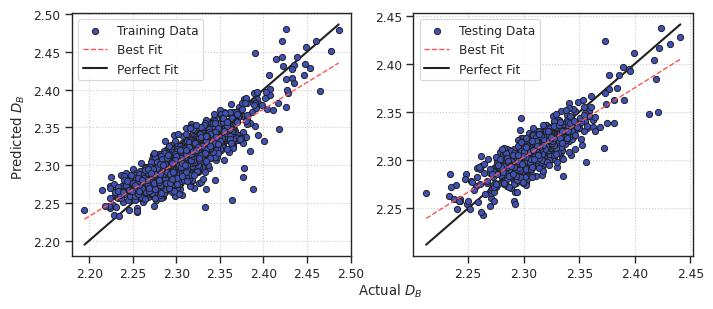

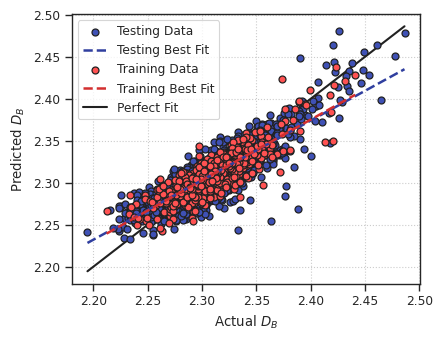

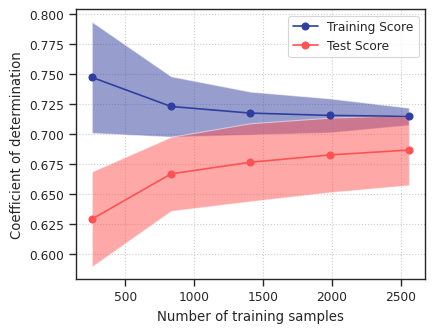

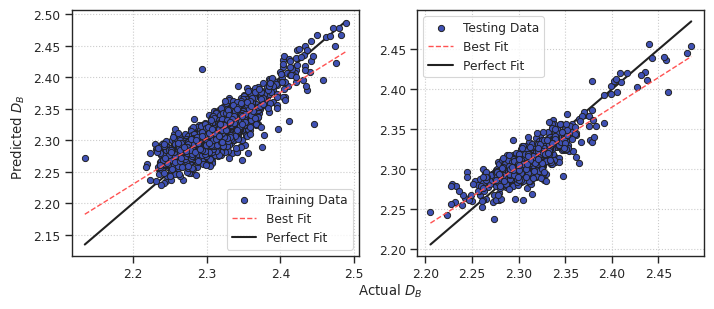

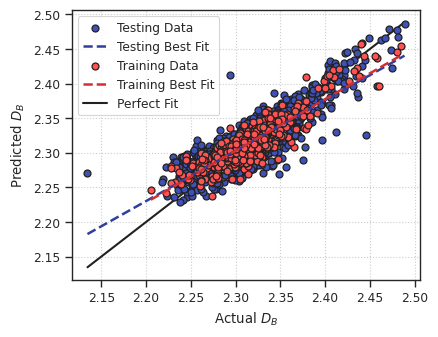

...

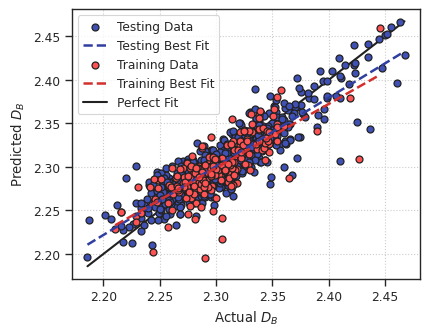

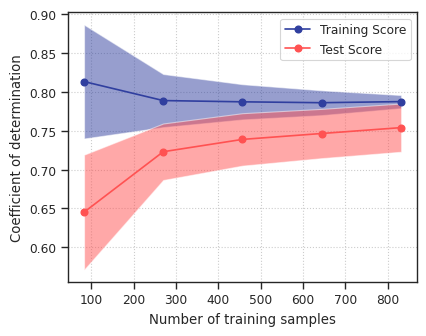

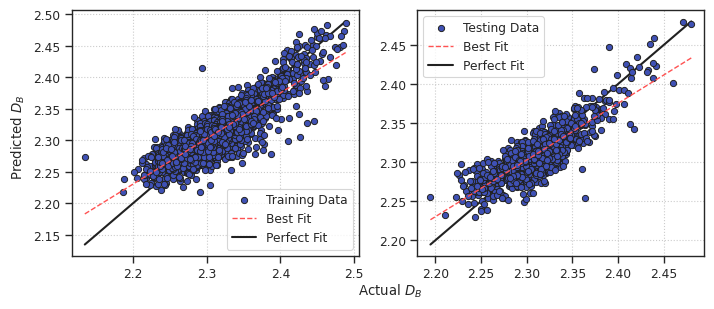

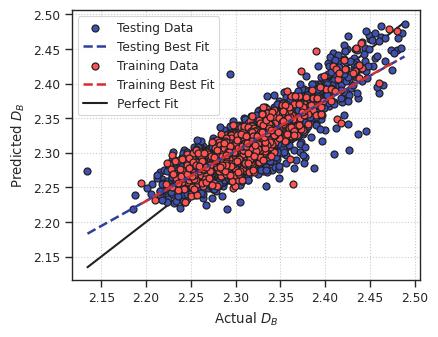

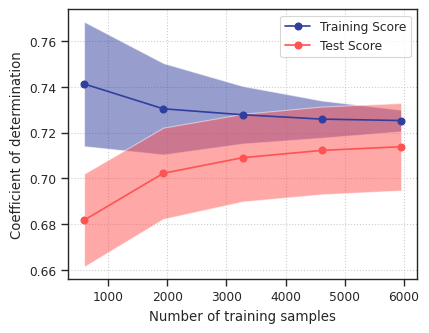

In [50]:
for bnp in X_Y_BNPS.keys():
    print(f"\nDataset: {bnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_BNPS[bnp]
    
    ridgeReg = RidgeCV(alphas=(0.01, 0.1, 1.0, 10.0, 100.0), fit_intercept=True, scoring=None, cv=None, 
                       gcv_mode='auto', store_cv_values=False, alpha_per_target=False)  # cv=None for LOOCV, scoring='negative mean squared error'
    yPredTrainRidge, yPredTestRidge, ridgeReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                         model=ridgeReg, modelName='Ridge', datasetName=bnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                         showFeatCoef=True, plotFeatImp=False, verbose=True, showFig=True)

#### Elastic Net Regressor


Dataset: Au
  Running ElasNetR
  Trained and tested using coefficient of determination.
    Training score: 0.710
    Testing score:
      Mean absolute error: 0.011061
      Mean squared error: 0.000213
      Root mean squared error: 0.014596
      Coefficient of determination: 0.709
  Feature coefficients:
    R_max: 0.053
    R_kurt: 0.003
    S_100: 0.023
    S_311: 0.035
    Avg_total: 0.036
    Min_bonds: 0.003
    FCC: 0.006
    Perc_BCN_9: 0.006
    Perc_BCN_10: 0.001
    Perc_BCN_14: 0.010
    Perc_BCN_16: 0.017
    Perc_q6q6_B3: 0.006
    Perc_q6q6_B6: 0.029
    Perc_q6q6_B7: 0.001
    Perc_q6q6_B11: 0.022
    Perc_q6q6_B14: 0.004
    Perc_SCN_8: 0.107
    Perc_q6q6_S2: 0.006
    Perc_q6q6_S4: 0.002
    Perc_q6q6_S6: 0.068
    Perc_q6q6_S7: 0.017
    Perc_q6q6_S8: 0.005
    Perc_q6q6_S11: 0.025
    Perc_q6q6_S13: 0.005
    Perc_TCN_10: 0.012
    Perc_q6q6_T5: 0.018
    Perc_q6q6_T8: 0.034
    Perc_q6q6_T10: 0.009

Dataset: Pd
  Running ElasNetR
  Trained and tested using coe

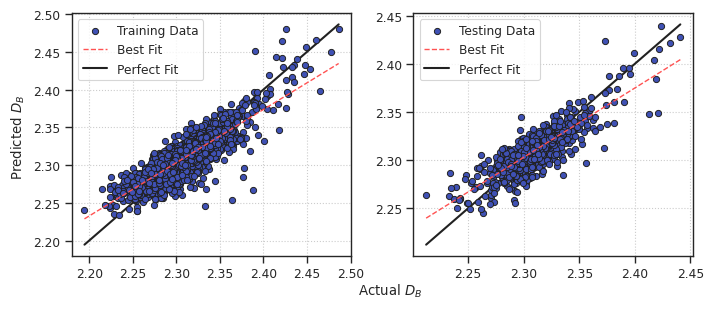

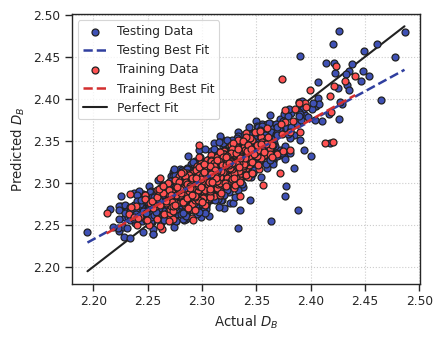

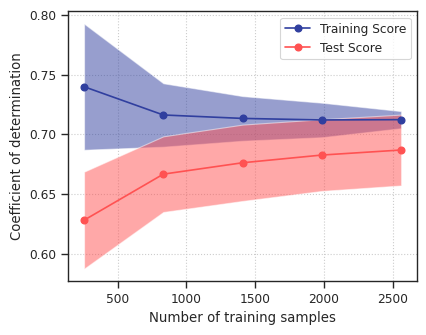

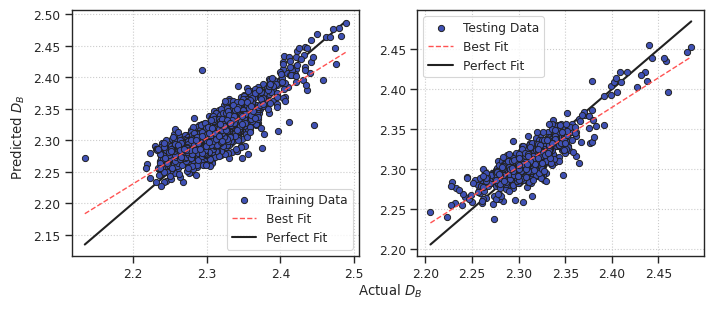

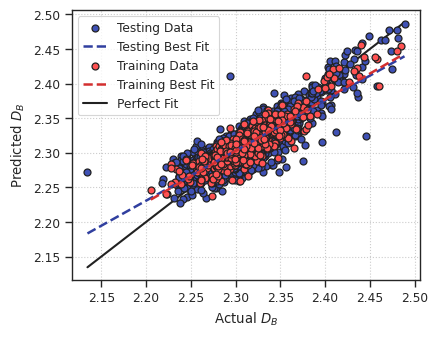

...

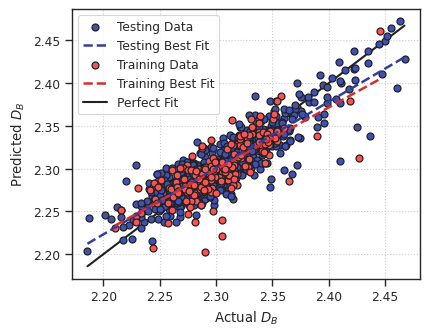

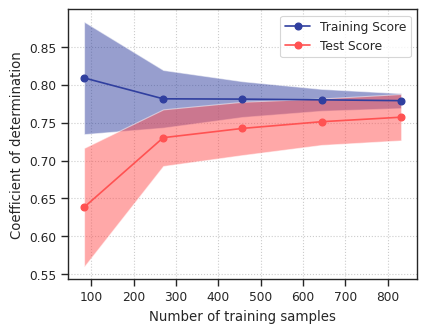

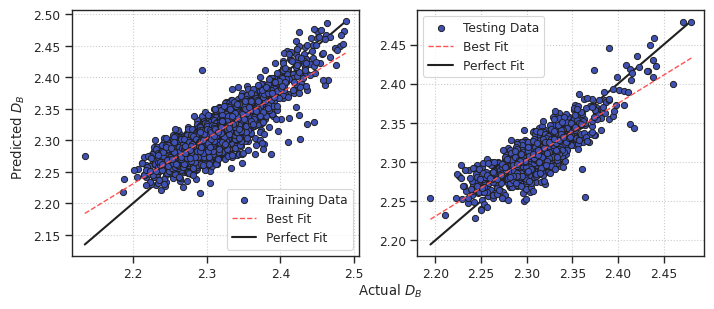

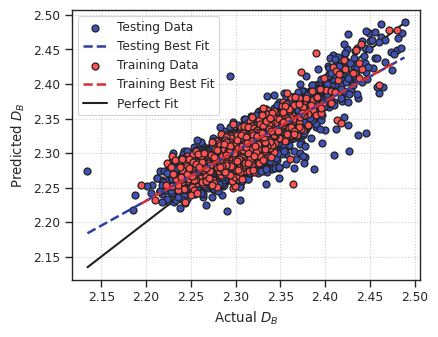

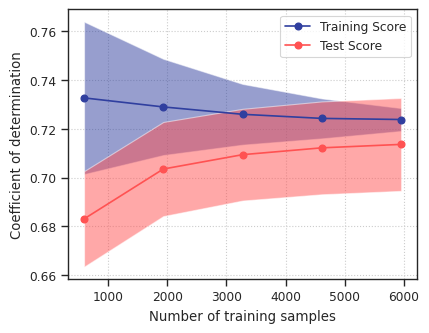

In [51]:
for bnp in X_Y_BNPS.keys():
    print(f"\nDataset: {bnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_BNPS[bnp]
    
    enReg = ElasticNetCV(l1_ratio=(0.1, 0.5, 0.7, 0.9, 0.95, 0.99), eps=0.001, n_alphas=100, alphas=None, 
                         fit_intercept=True, precompute='auto', max_iter=100000, tol=0.0001, cv=5, 
                         copy_X=True, verbose=0, n_jobs=NUM_JOBS, positive=False, random_state=RANDOM_SEED, selection='cyclic')
    yPredTrainElasNetR, yPredTestElasNetR, enReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                            model=enReg, modelName='ElasNetR', datasetName=bnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                            showFeatCoef=True, plotFeatImp=False, verbose=True, showFig=True)

#### Kernel Ridge Regressor

In [ ]:
for bnp in X_Y_BNPS.keys():
    print(f"\nDataset: {bnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_BNPS[bnp]

    # General
    estimator = KernelRidge(alpha=1, kernel='linear', gamma=None, degree=3, coef0=1, kernel_params=None)
    paramGridGeneral = {'alpha': [0.1, 1.0, 10, 100], 
                 'kernel': ['linear', 'poly', 'cosine'],  # 'linear', 'poly', 'rbf', 'sigmoid', 'additive_chi2', 'chi2', 'polynomial', 'laplacian', 'cosine'
                 }
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResultsGeneral = hyperparamTune(estimator, paramGridGeneral, Xtrain, yTrain, Xtest, yTest, cv=cv)

    # Sigmoid kernel
    estimator = KernelRidge(alpha=1, kernel='linear', gamma=None, degree=3, coef0=1, kernel_params=None)
    paramGridSigmoid = {'alpha': [0.1, 1.0, 10, 100], 
                 'kernel': ['sigmoid'],  # 'linear', 'poly', 'rbf', 'sigmoid', 'additive_chi2', 'chi2', 'polynomial', 'laplacian', 'cosine'
                 'gamma': (1.0, 0.1, 0.01, 0.001), 
                 'coef0': [0.5, 1.0, 2.0], 
                 }
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResultsSigmoid = hyperparamTune(estimator, paramGridSigmoid, Xtrain, yTrain, Xtest, yTest, cv=cv)
   
    # Polynomial kernel
    estimator = KernelRidge(alpha=1, kernel='linear', gamma=None, degree=3, coef0=1, kernel_params=None)
    paramGridPolynomial = {'alpha': [0.1, 1.0, 10, 100], 
                 'kernel': ['polynomial'],  # 'linear', 'poly', 'rbf', 'sigmoid', 'additive_chi2', 'chi2', 'polynomial', 'laplacian', 'cosine'
                 'degree' : [2, 3, 4], 
                 'gamma': (1.0, 0.1, 0.01, 0.001), 
                 'coef0': [0.5, 1.0, 2.0], 
                 }
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResultsPolynomial = hyperparamTune(estimator, paramGridPolynomial, Xtrain, yTrain, Xtest, yTest, cv=cv)

    # Kernel involving gammas
    estimator = KernelRidge(alpha=1, kernel='linear', gamma=None, degree=3, coef0=1, kernel_params=None)
    paramGridGamma = {'alpha': [0.1, 1.0, 10, 100], 
                 'kernel': ['rbf', 'laplacian', 'chi2', 'sigmoid'],  # 'linear', 'poly', 'rbf', 'sigmoid', 'additive_chi2', 'chi2', 'polynomial', 'laplacian', 'cosine'
                 'gamma': (1.0, 0.1, 0.01, 0.001), 
                 }
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResultsGamma = hyperparamTune(estimator, paramGridGamma, Xtrain, yTrain, Xtest, yTest, cv=cv)

    bestResultsIdx = np.argmax([searchResultsGeneral.best_score_, searchResultsSigmoid.best_score_, searchResultsPolynomial.best_score_, searchResultsGamma.best_score_])
    searchResultsBest = [searchResultsGeneral, searchResultsSigmoid, searchResultsPolynomial, searchResultsGamma][bestResultsIdx]

    krReg = searchResults.best_estimator_
    yPredTrainKRR, yPredTestKRR, krReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                  model=krReg, modelName='KRR', datasetName=bnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                  showFeatCoef=False, plotFeatImp=False, verbose=True, showFig=True)

#### K-Nearest Neighbour Regressor


Dataset: Au
Best score: 0.711
Best parameter combination: {'metric': 'minkowski', 'n_neighbors': 10, 'p': 1, 'weights': 'distance'}
  Running KNR
  Trained and tested using coefficient of determination.
    Training score: 1.000
    Testing score:
      Mean absolute error: 0.010917
      Mean squared error: 0.000211
      Root mean squared error: 0.014537
      Coefficient of determination: 0.711

Dataset: Pd
Best score: 0.759
Best parameter combination: {'metric': 'minkowski', 'n_neighbors': 10, 'p': 1, 'weights': 'distance'}
  Running KNR
  Trained and tested using coefficient of determination.
    Training score: 1.000
    Testing score:
      Mean absolute error: 0.011773
      Mean squared error: 0.000250
      Root mean squared error: 0.015818
      Coefficient of determination: 0.759

Dataset: Pt
Best score: 0.587
Best parameter combination: {'metric': 'minkowski', 'n_neighbors': 10, 'p': 1.5, 'weights': 'distance'}
  Running KNR
  Trained and tested using coefficient of deter

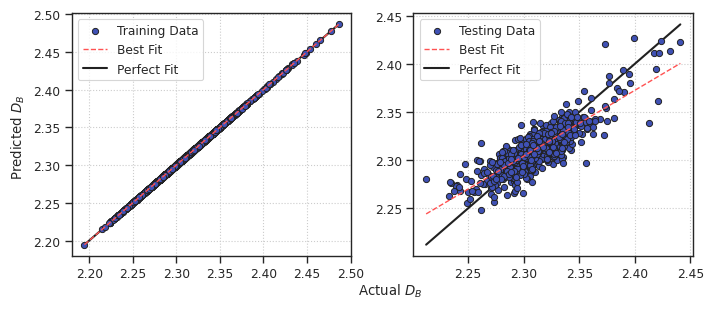

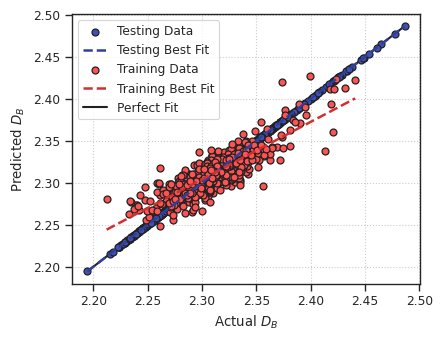

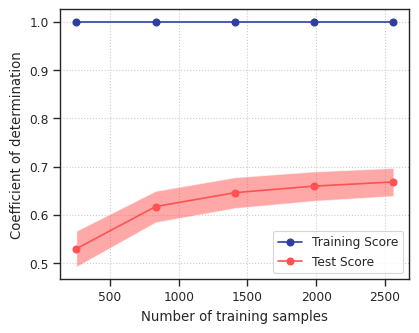

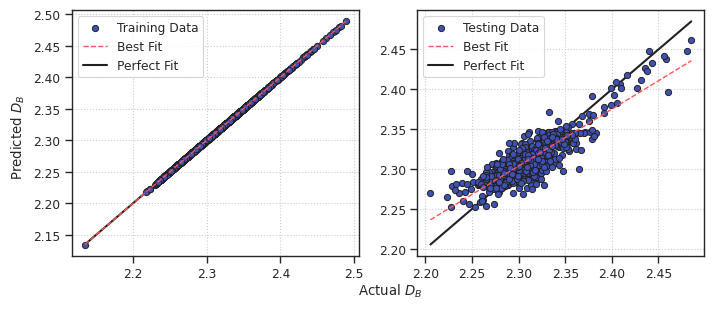

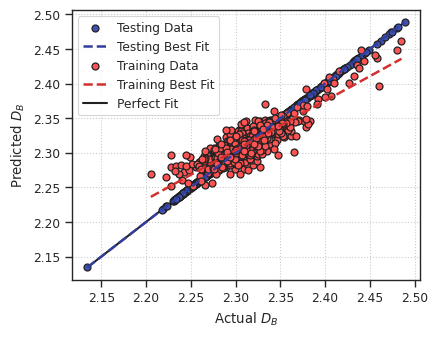

...

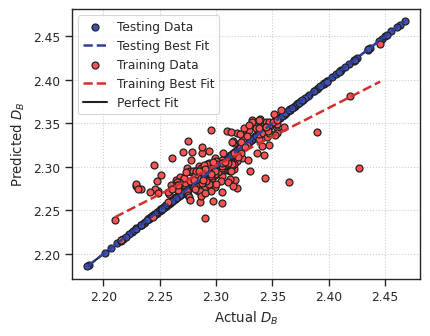

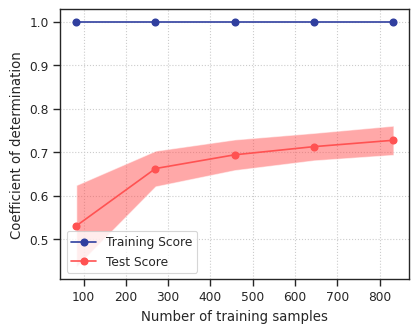

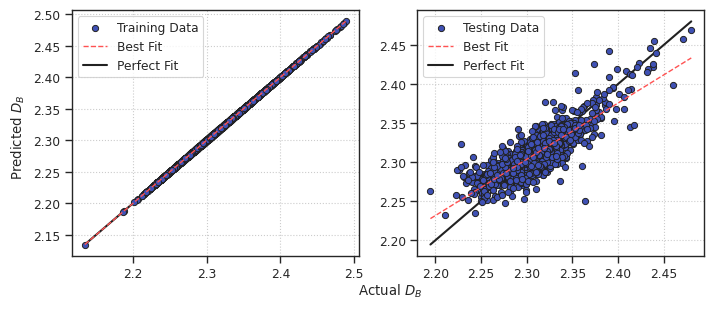

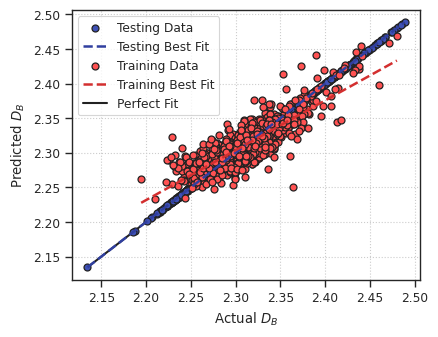

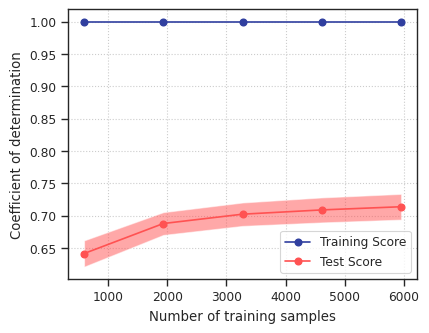

In [66]:
for bnp in X_Y_BNPS.keys():
    print(f"\nDataset: {bnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_BNPS[bnp]
    
    estimator = KNeighborsRegressor(n_neighbors=5, weights='uniform', p=2, metric='minkowski', 
                                    algorithm='auto', leaf_size=30, metric_params=None, n_jobs=NUM_JOBS)
    paramGrid = {'n_neighbors': [3, 5, 8, 10], 
                 'weights': ['uniform', 'distance'],  
                 'p' : [1, 1.5, 2], 
                 'metric': ['minkowski', 'euclidean', 'manhattan']}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

    knReg = searchResults.best_estimator_
    yPredTrainKNR, yPredTestKNR, knReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                  model=knReg, modelName='KNR', datasetName=bnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                  showFeatCoef=False, plotFeatImp=False, verbose=True, showFig=True)

#### Support Vector Regressor


Dataset: Au
Best score: 0.732
Best parameter combination: {'C': 0.1, 'degree': 2, 'epsilon': 0.01, 'gamma': 'scale', 'kernel': 'rbf'}
  Running SVR
  Trained and tested using coefficient of determination.
    Training score: 0.762
    Testing score:
      Mean absolute error: 0.010503
      Mean squared error: 0.000196
      Root mean squared error: 0.013994
      Coefficient of determination: 0.732

Dataset: Pd
Best score: 0.781
Best parameter combination: {'C': 0.1, 'degree': 2, 'epsilon': 0.01, 'gamma': 'scale', 'kernel': 'rbf'}
  Running SVR
  Trained and tested using coefficient of determination.
    Training score: 0.779
    Testing score:
      Mean absolute error: 0.011245
      Mean squared error: 0.000227
      Root mean squared error: 0.015082
      Coefficient of determination: 0.781

Dataset: Pt
Best score: 0.598
Best parameter combination: {'C': 0.1, 'degree': 2, 'epsilon': 0.01, 'gamma': 'scale', 'kernel': 'rbf'}
  Running SVR
  Trained and tested using coefficient of d

KeyboardInterrupt: 

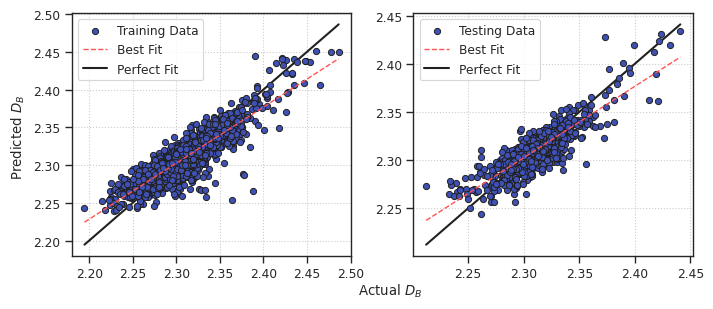

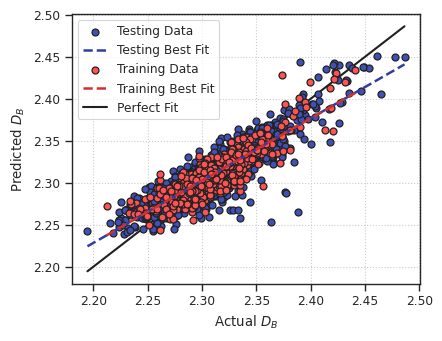

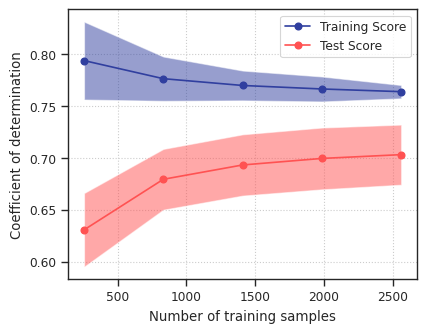

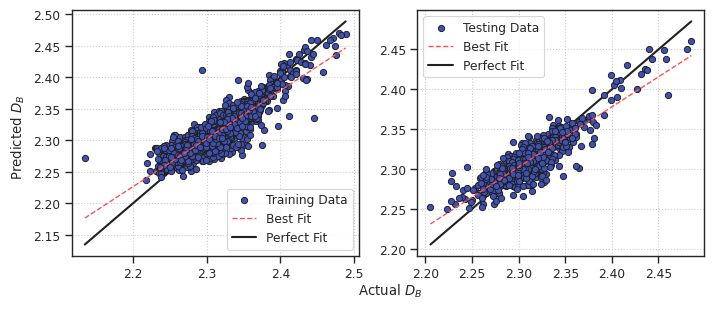

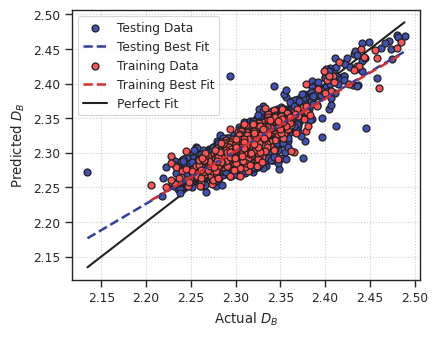

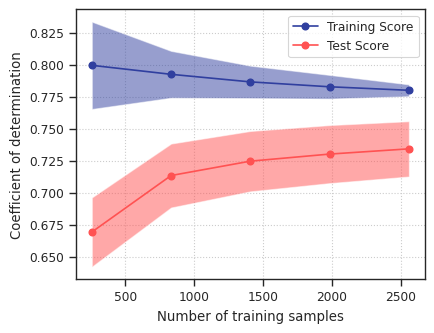

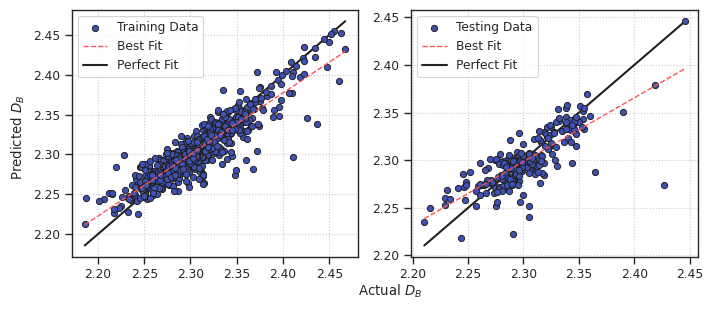

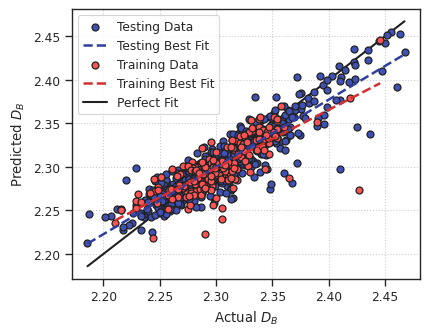

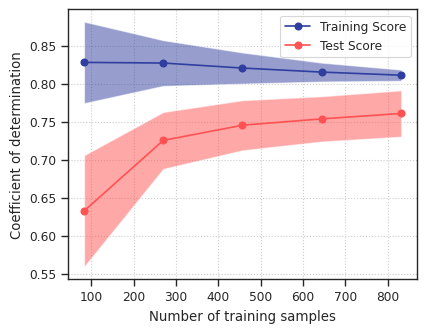

In [68]:
for bnp in X_Y_BNPS.keys():
    print(f"\nDataset: {bnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_BNPS[bnp]
    
    estimator = SVR(coef0=0.0, tol=0.001, epsilon=0.1, shrinking=True, cache_size=200, verbose=False, max_iter=-1)
    paramGrid = {'C': [0.01, 0.1, 1.0, 10, 100], 
                 'epsilon': [0.01, 0.1, 1.0], 
                 'kernel': ['linear', 'poly', 'rbf', 'sigmoid'], 
                 'degree' : [2, 3, 4], 
                 'gamma': ['scale', 'auto', 0.01, 0.1, 1.0]}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

    svReg = searchResults.best_estimator_
    yPredTrainSVR, yPredTestSVR, svReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                  model=svReg, modelName='SVR', datasetName=bnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                  showFeatCoef=False, plotFeatImp=False, verbose=True, showFig=True)

#### Decision Tree Regressor

In [ ]:
for bnp in X_Y_BNPS.keys():
    print(f"\nDataset: {bnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_BNPS[bnp]
    
    estimator = DecisionTreeRegressor(criterion='squared_error', splitter='best', max_depth=None, 
                                      min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, 
                                      max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0, ccp_alpha=0.0,
                                      random_state=RANDOM_SEED)
    paramGrid = {'criterion': ['squared_error', 'absolute_error', 'poisson'], # 'friedman_mse', 
                 'splitter': ['best', 'random'], 
                 'max_depth' : [3, 5, None], 
                 'max_features': ['sqrt', 'log2', None]}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

    dtReg = searchResults.best_estimator_
    yPredTrainDTR, yPredTestDTR, dtReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                  model=dtReg, modelName='DTR', datasetName=bnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                  showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)


Dataset: Au
Best score: 0.613
Best parameter combination: {'criterion': 'absolute_error', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}
  Running DTR
  Trained and tested using coefficient of determination.
    Training score: 0.680
    Testing score:
      Mean absolute error: 0.012704
      Mean squared error: 0.000283
      Root mean squared error: 0.016835
      Coefficient of determination: 0.613

Dataset: Pd
Best score: 0.696
Best parameter combination: {'criterion': 'squared_error', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}
  Running DTR
  Trained and tested using coefficient of determination.
    Training score: 0.725
    Testing score:
      Mean absolute error: 0.013295
      Mean squared error: 0.000317
      Root mean squared error: 0.017793
      Coefficient of determination: 0.696

Dataset: Pt
Best score: 0.478
Best parameter combination: {'criterion': 'absolute_error', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}
  Running DTR
  

#### ExtRa Tree Regressor

In [ ]:
for bnp in X_Y_BNPS.keys():
    print(f"\nDataset: {bnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_BNPS[bnp]
    
    estimator = ExtraTreeRegressor(criterion='squared_error', splitter='random', max_depth=None, 
                                   min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, 
                                   max_features=1.0, min_impurity_decrease=0.0, max_leaf_nodes=None, ccp_alpha=0.0,
                                   random_state=RANDOM_SEED)
    paramGrid = {'criterion': ['squared_error', 'friedman_mse', 'absolute_error', 'poisson'], 
                 'splitter': ['best', 'random'], 
                 'max_depth' : [3, 5, None], 
                 'max_features': ['auto', 'sqrt', 'log2', 1.0, None]}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)
    
    etReg = BaggingRegressor(searchResults.best_estimator_, random_state=RANDOM_SEED)
    yPredTrainETR, yPredTestETR, etReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                  model=etReg, modelName='ETR', datasetName=bnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                  showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### Random Forest Regressor

In [ ]:
for bnp in X_Y_BNPS.keys():
    print(f"\nDataset: {bnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_BNPS[bnp]
    
    estimator = RandomForestRegressor(n_estimators=100, criterion='squared_error', max_depth=8, min_samples_split=2, min_samples_leaf=1, 
                                      min_weight_fraction_leaf=0.0, max_features=1.0, max_leaf_nodes=None, min_impurity_decrease=0.0, 
                                      bootstrap=True, oob_score=False, n_jobs=None, random_state=RANDOM_SEED, verbose=0, warm_start=False, 
                                      ccp_alpha=0.0, max_samples=None)
    paramGrid = {'max_depth': [30,], 
                 'max_features' : ['sqrt', 'log2', 1],  # 'log2', 1
                 'n_estimators': [350],
                 'min_samples_split': [5], 
                 'min_samples_leaf': [5]}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

    rfReg = searchResults.best_estimator_
    yPredTrainRFR, yPredTestRFR, rfReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                  model=rfReg, modelName='RFR', datasetName=bnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                  showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

Running RFR
Trained and tested using coefficient of determination.
  Training score: 0.945
  Testing score:
    Mean absolute error: 0.011417
    Mean squared error: 0.000238
    Root mean squared error: 0.015416
    Coefficient of determination: 0.766


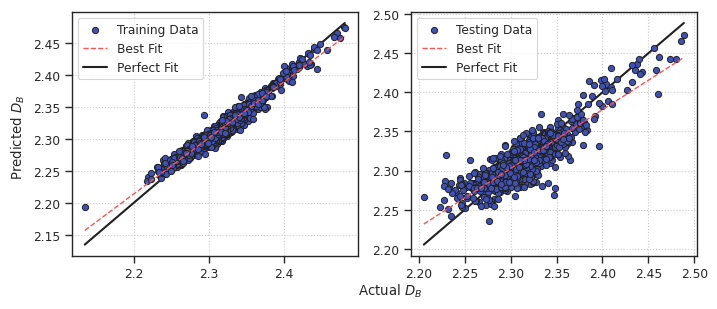

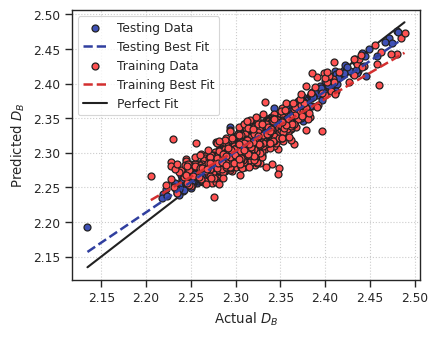

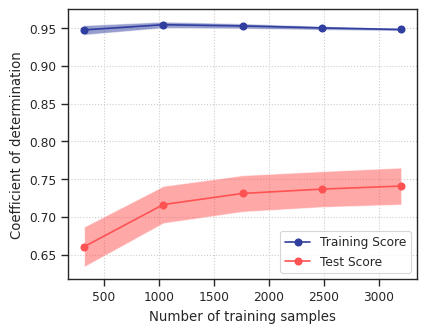

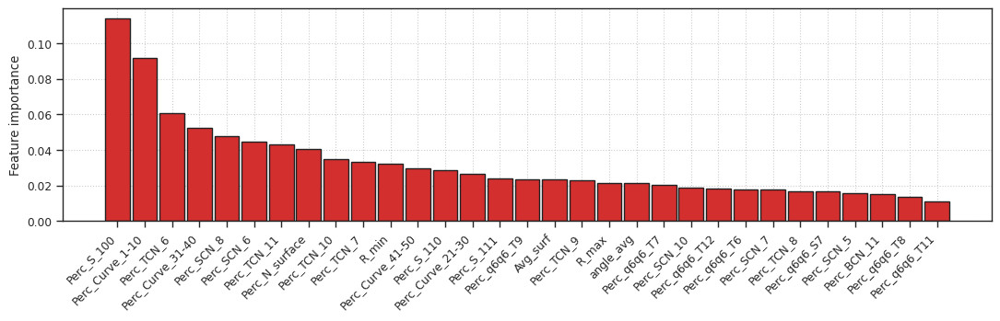

In [123]:
# rfReg = RandomForestRegressor(n_estimators=300, criterion='friedman_mse', max_depth=10, min_samples_split=8, min_samples_leaf=5, 
#                               min_weight_fraction_leaf=0.0, max_features='sqrt', max_leaf_nodes=None, min_impurity_decrease=0.0, 
#                               bootstrap=True, oob_score=False, n_jobs=8, random_state=RANDOM_SEED, verbose=0, warm_start=False, ccp_alpha=0.0, max_samples=None)
# yPredTrain, yPredTest, model = evalModel(rfReg, Xtrain, yTrain, Xtest, yTest)

# Feature elimination
# impFeats = rfReg.feature_names_in_[rfReg.feature_importances_ > 0.02]
# XtrainNew = Xtrain[impFeats]
# XtestNew = Xtest[impFeats]
# yPredTrainRFR, yPredTestRFR, rfReg = runModel(XtrainNew, yTrain, XtestNew, yTest, 
#                                               model=rfReg, modelName='RFR', showFeatCoef=False, plotFeatImp=True, 
#                                               verbose=True, showFig=True)

#### ExtRa Trees Regressor

In [ ]:
for bnp in X_Y_BNPS.keys():
    print(f"\nDataset: {bnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_BNPS[bnp]
    
    estimator = ExtraTreesRegressor(n_estimators=100, criterion='squared_error', max_depth=None, 
                                    min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, 
                                    max_features=1.0, max_leaf_nodes=None, min_impurity_decrease=0.0, 
                                    bootstrap=False, oob_score=False, n_jobs=NUM_JOBS, random_state=RANDOM_SEED, verbose=0, 
                                    warm_start=False, ccp_alpha=0.0, max_samples=None)
    paramGrid = {'n_estimators': [100, 300], 
                 'criterion': ['squared_error', 'absolute_error', 'poisson'],  # 'friedman_mse', 
                 'max_depth' : [5, 10, 30], 
                 'max_features': ['sqrt', 'log2', 1.0, None]}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)
    
    etsReg = searchResults.best_estimator_
    yPredTrainETsR, yPredTestETsR, etsReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                     model=etsReg, modelName='ETsR', datasetName=bnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                     showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### Adaptive Boosting Forest Regressor

In [ ]:
for bnp in X_Y_BNPS.keys():
    print(f"\nDataset: {bnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_BNPS[bnp]
    
    estimator = AdaBoostRegressor(estimator=None, n_estimators=50, learning_rate=1.0, loss='linear', random_state=RANDOM_SEED)
    paramGrid = {'n_estimators': [50, 100, 150], 
                 'learning_rate': [0.1, 1.0, 10], 
                 'loss' : ['linear', 'square', 'exponential']}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

    abReg = searchResults.best_estimator_
    yPredTrainABR, yPredTestABR, abReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                  model=abReg, modelName='ABR', datasetName=bnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                  showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### Extreme Gradient Boosting Regressor

In [ ]:
for bnp in X_Y_BNPS.keys():
    print(f"\nDataset: {bnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_BNPS[bnp]
    
    estimator = XGBRegressor(verbosity=1, n_jobs=NUM_JOBS, importance_type='gain')
    # n_estimators=100, max_depth=5, max_leaves=0, max_bin=15, grow_policy='depthwise', learning_rate=0.01, verbosity=3, 
    # objective=None, booster='gbtree', tree_method='hist', n_jobs=NUM_JOBS, 
    # gamma=None, min_child_weight=None, 
    # subsample=None, sampling_method=None, colsample_bytree=None, colsample_bylevel=None, colsample_bynode=None, 
    # reg_alpha=None, reg_lambda=None, scale_pos_weight=None, base_score=None, random_state=RANDOM_SEED, 
    # missing=None, num_parallel_tree=None, monotone_constraints=None, interaction_constraints=None, importance_type='gain', 
    # eval_metric=mean_squared_error, early_stopping_rounds=None, max_delta_step=None
    paramGrid = {# 'n_estimators': [50, 100], 
                 # 'booster': ['gbtree', 'gblinear', 'dart'], 
                 'learning_rate': [0.01, 0.1],
                 'min_child_weight': [1, 3, 5],
                 'gamma': [0, 1, 3], 
                 'max_depth' : [3, 6, 9], 
                 'colsample_bytree': [0.5, 1], 
                 'subsample': [0.5, 1]}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)
    
    xgbReg = searchResults.best_estimator_
    yPredTrainXGBR, yPredTestXGBR, xgbReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                     model=xgbReg, modelName='XGBR', datasetName=bnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                     showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### Light Gradient Boosting Machine Regressor

In [ ]:
for bnp in X_Y_BNPS.keys():
    print(f"\nDataset: {bnp}")
    Xtrain, Xtest, yTrain, yTest = X_Y_BNPS[bnp]
    
    estimator = LGBMRegressor(boosting_type='gbdt', num_leaves=31, max_depth=20, learning_rate=0.1, n_estimators=100, subsample_for_bin=200000, objective=None, 
                              class_weight=None, min_split_gain=0.0, min_child_weight=0.001, min_child_samples=20, subsample=1.0, subsample_freq=0, colsample_bytree=1.0, 
                              reg_alpha=0.0, reg_lambda=0.0, random_state=RANDOM_SEED, n_jobs=NUM_JOBS, importance_type='gain')
    paramGrid = {'boosting_type': ['gbdt', 'dart', 'rf'], 
                 'max_depth' : [5, 10, 20], 
                 'n_estimators': [25, 50, 100, 250]}
    cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
    searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

    lgbmReg = searchResults.best_estimator_
    yPredTrainLGBMR, yPredTestLGBMR, lgbmReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                    model=lgbmReg, modelName='LGBMR', datasetName=bnp, figNameAppendix=FIG_NAME_APPENDIX,
                                                    showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

<a id='tnps'></a>
## Trimetallic Nanoparticles

Here we attempt to train a machine learning model that aims to predict the $D_B$ values of a set of simulated trimetallic (gold-palladium-platinum) nanoparticles, study the feature importance profile to understand the influential features in the prediction of the $D_B$ values, and investigate the conditions that give rise to rougher nanoparticles.

### Data Loading

In [6]:
with open('data/processedTNPdata.pickle', 'rb') as f:
    AuPdPtNPDF = pickle.load(f)

In [7]:
TNP_NAME = 'AuPdPt'

Xtrain, Xtest, yTrain, yTest = splitScaleData(df=AuPdPtNPDF, polyFeats=POLY_FEATS, scaling=SCALING, verbose=True)

Applying minmax scaling to feature values...


In [45]:
# Label Transformation

# Standardisation
# yTrain = (yTrain - yTrain.mean()) / yTrain.std()
# yTest = (yTest - yTest.mean()) / yTest.std()

# # Normalisation
# yTrain = (yTrain - yTrain.min()) / abs(yTrain.max() - yTrain.min())
# yTest = (yTest - yTest.min()) / abs(yTest.max() - yTest.min())

### Models Training and Evaluation

The regression models as described above are trained on different trimetallic (gold-palladium-platinum) nanoparticle datasets without polynomial features, with features scaled via min-max normalisation.

#### Linear Regressor

  Running LinR
  Trained and tested using coefficient of determination.
    Training score: 0.611
    Testing score:
      Mean absolute error: 7206.910203
      Mean squared error: 500071685302.741821
      Root mean squared error: 707157.468534
      Coefficient of determination: -351226820228156.000


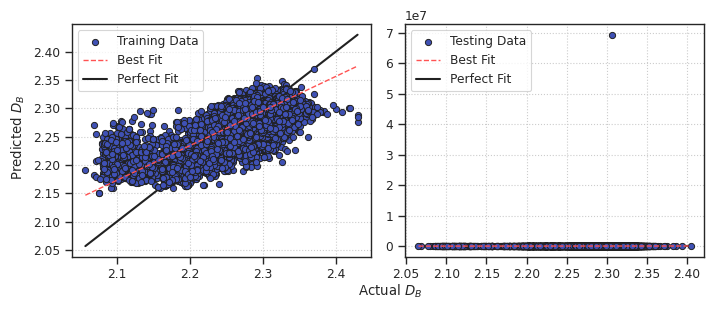

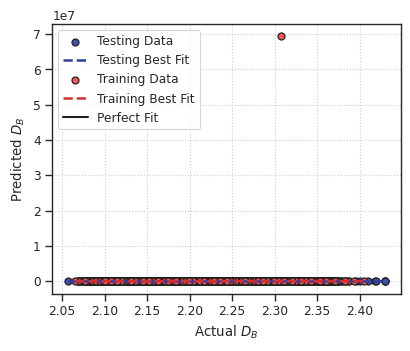

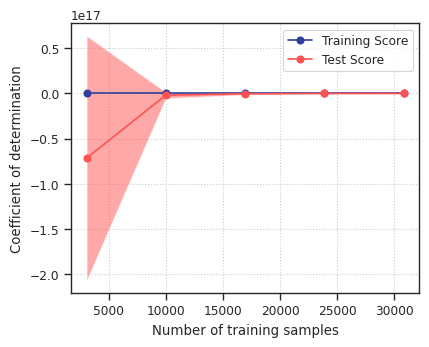

  Feature coefficients:
    N_Au: 17412026890.211
    N_Pd: 20501257467.277
    N_Pt: 20501257467.610
    R_max: 11887.431
    R_std: 0.038
    R_kurt: 0.154
    S_100: 0.001
    Curve_71-80: 0.003
    MM_BL_avg: 0.071
    AuAu_BL_avg: 0.005
    AuAu_BL_std: 0.006
    AuPd_BL_avg: 0.086
    AuPd_BL_min: 0.014
    AuPt_BL_avg: 0.078
    AuPt_BL_min: 0.040
    PdPd_BL_max: 0.019
    PdPt_BL_max: 0.036
    PdPt_BL_min: 0.044
    PdPt_BL_num: 0.004
    PtPt_BL_min: 0.076
    AuAuAu_BA1_max: 0.012
    AuAuPt_BA1_avg: 0.008
    AuAuPt_BA1_std: 0.009
    AuAuPt_BA1_min: 0.001
    AuAuPt_BA1_num: 0.029
    AuPdAu_BA1_avg: 0.001
    AuPdAu_BA1_std: 0.003
    AuPdPd_BA1_std: 0.006
    AuPdPd_BA1_min: 0.015
    AuPdPd_BA1_num: 0.058
    AuPdPt_BA1_max: 0.016
    AuPtAu_BA1_max: 0.001
    AuPtPd_BA1_max: 0.023
    AuPtPd_BA1_min: 0.017
    AuPtPt_BA1_max: 0.002
    AuPtPt_BA1_min: 0.007
    AuPtPt_BA1_num: 0.068
    PdAuAu_BA1_max: 0.004
    PdAuAu_BA1_min: 0.009
    PdAuPd_BA1_avg: 0.005
    PdAu

In [41]:
linReg = LinearRegression(positive=False, fit_intercept=True, 
                          copy_X=True, n_jobs=NUM_JOBS)
yPredTrainLinR, yPredTestLinR, linReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                 model=linReg, modelName='LinR', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                                 showFeatCoef=True, plotFeatImp=False, verbose=True, showFig=True)

#### LASSO Regressor

  Running LASSO
  Trained and tested using coefficient of determination.
    Training score: 0.607
    Testing score:
      Mean absolute error: 0.016946
      Mean squared error: 0.000571
      Root mean squared error: 0.023892
      Coefficient of determination: 0.599


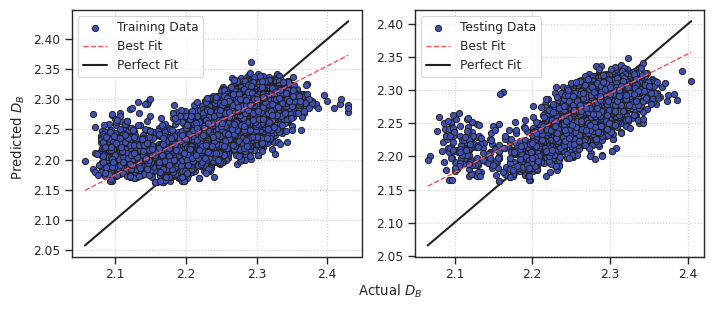

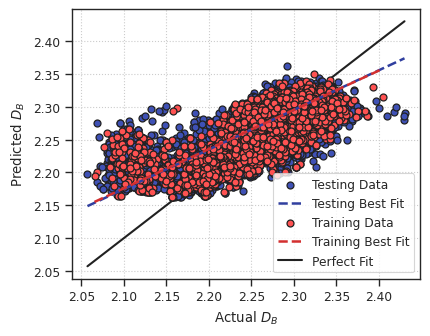

/home/users/u6853992/anaconda3/envs/npfd/lib/python3.9/site-packages/sklearn/linear_model/_least_angle.py:645: ConvergenceWarning: Regressors in active set degenerate. Dropping a regressor, after 446 iterations, i.e. alpha=2.574e-06, with an active set of 346 regressors, and the smallest cholesky pivot element being 1.490e-08. Reduce max_iter or increase eps parameters.
  warnings.warn(
/home/users/u6853992/anaconda3/envs/npfd/lib/python3.9/site-packages/sklearn/linear_model/_least_angle.py:645: ConvergenceWarning: Regressors in active set degenerate. Dropping a regressor, after 285 iterations, i.e. alpha=9.280e-06, with an active set of 229 regressors, and the smallest cholesky pivot element being 1.490e-08. Reduce max_iter or increase eps parameters.
  warnings.warn(
/home/users/u6853992/anaconda3/envs/npfd/lib/python3.9/site-packages/sklearn/linear_model/_least_angle.py:645: ConvergenceWarning: Regressors in active set degenerate. Dropping a regressor, after 423 iterations, i.e. alp

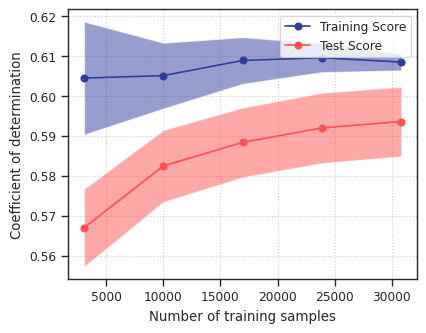

  Feature coefficients:
    N_atom_total: 0.002
    N_Pt: 0.091
    R_std: 0.016
    R_kurt: 0.048
    Curve_71-80: 0.003
    MM_BL_avg: 0.084
    AuAu_BL_std: 0.005
    AuPd_BL_avg: 0.052
    AuPd_BL_max: 0.006
    AuPd_BL_min: 0.017
    AuPt_BL_avg: 0.028
    AuPt_BL_min: 0.040
    PdPd_BL_max: 0.021
    PdPt_BL_max: 0.027
    PdPt_BL_min: 0.009
    AuAuAu_BA1_max: 0.004
    AuAuPd_BA1_std: 0.001
    AuAuPt_BA1_avg: 0.005
    AuAuPt_BA1_std: 0.007
    AuAuPt_BA1_num: 0.021
    AuPdAu_BA1_std: 0.002
    AuPdPd_BA1_std: 0.003
    AuPdPd_BA1_max: 0.003
    AuPdPd_BA1_min: 0.008
    AuPdPd_BA1_num: 0.026
    AuPdPt_BA1_max: 0.006
    AuPtPd_BA1_max: 0.011
    AuPtPd_BA1_min: 0.020
    AuPtPt_BA1_min: 0.004
    AuPtPt_BA1_num: 0.054
    PdAuAu_BA1_max: 0.003
    PdAuAu_BA1_min: 0.003
    PdAuPt_BA1_std: 0.002
    PdPdPd_BA1_avg: 0.001
    PdPdPd_BA1_num: 0.053
    PdPdPt_BA1_std: 0.006
    PdPdPt_BA1_min: 0.001
    PdPdPt_BA1_num: 0.021
    PdPtAu_BA1_max: 0.009
    PdPtPd_BA1_max: 0.007


In [42]:
lassoReg = LassoLarsCV(fit_intercept=True, max_iter=500, cv=5, max_n_alphas=1000, positive=False, eps=np.finfo(float).eps, 
                       precompute='auto', n_jobs=NUM_JOBS, copy_X=True, verbose=False)
yPredTrainLASSO, yPredTestLASSO, lassoReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                     model=lassoReg, modelName='LASSO', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                                     showFeatCoef=True, plotFeatImp=False, verbose=True, showFig=True)

#### Ridge Regressor

  Running Ridge
  Trained and tested using coefficient of determination.
    Training score: 0.611
    Testing score:
      Mean absolute error: 0.016912
      Mean squared error: 0.000567
      Root mean squared error: 0.023810
      Coefficient of determination: 0.602


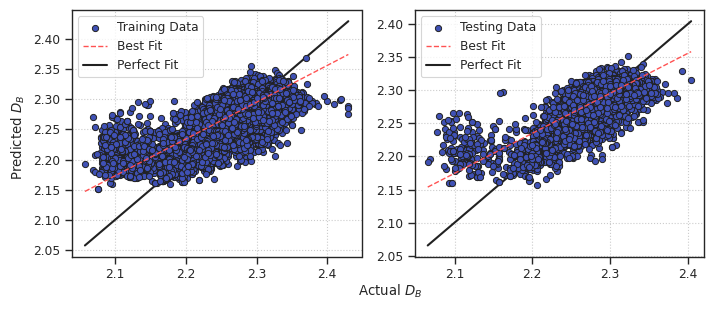

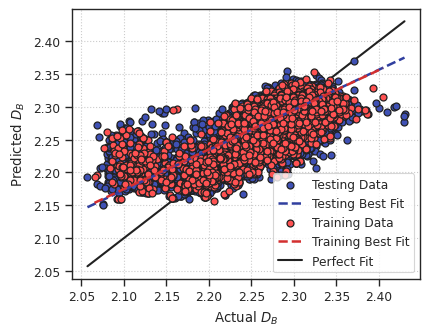

/home/users/u6853992/anaconda3/envs/npfd/lib/python3.9/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


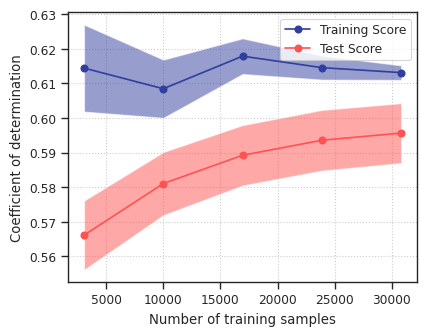

  Feature coefficients:
    N_atom_total: 0.062
    N_Au: 0.047
    N_Pt: 0.156
    R_std: 0.037
    R_kurt: 0.132
    Curve_71-80: 0.003
    MM_BL_avg: 0.071
    AuAu_BL_avg: 0.004
    AuAu_BL_std: 0.006
    AuPd_BL_avg: 0.085
    AuPd_BL_min: 0.015
    AuPt_BL_avg: 0.077
    AuPt_BL_min: 0.041
    PdPd_BL_max: 0.019
    PdPt_BL_max: 0.036
    PdPt_BL_min: 0.044
    PdPt_BL_num: 0.002
    PtPt_BL_min: 0.073
    AuAuAu_BA1_max: 0.012
    AuAuPt_BA1_avg: 0.008
    AuAuPt_BA1_std: 0.009
    AuAuPt_BA1_min: 0.001
    AuAuPt_BA1_num: 0.029
    AuPdAu_BA1_avg: 0.001
    AuPdAu_BA1_std: 0.003
    AuPdPd_BA1_std: 0.006
    AuPdPd_BA1_min: 0.015
    AuPdPd_BA1_num: 0.057
    AuPdPt_BA1_max: 0.015
    AuPtAu_BA1_max: 0.001
    AuPtPd_BA1_max: 0.022
    AuPtPd_BA1_min: 0.017
    AuPtPt_BA1_max: 0.002
    AuPtPt_BA1_min: 0.007
    AuPtPt_BA1_num: 0.068
    PdAuAu_BA1_max: 0.004
    PdAuAu_BA1_min: 0.009
    PdAuPd_BA1_avg: 0.005
    PdAuPd_BA1_std: 0.006
    PdAuPd_BA1_min: 0.002
    PdAuPt_BA1_s

In [43]:
ridgeReg = RidgeCV(alphas=(0.01, 0.1, 1.0, 10.0, 100.0), fit_intercept=True, scoring=None, cv=None, 
                   gcv_mode='auto', store_cv_values=False, alpha_per_target=False)  # cv=None for LOOCV, scoring='negative mean squared error'
yPredTrainRidge, yPredTestRidge, ridgeReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                     model=ridgeReg, modelName='Ridge', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                                     showFeatCoef=True, plotFeatImp=False, verbose=True, showFig=True)

#### Elastic Net Regressor

  Running ElasNetR
  Trained and tested using coefficient of determination.
    Training score: 0.597
    Testing score:
      Mean absolute error: 0.016986
      Mean squared error: 0.000578
      Root mean squared error: 0.024052
      Coefficient of determination: 0.594


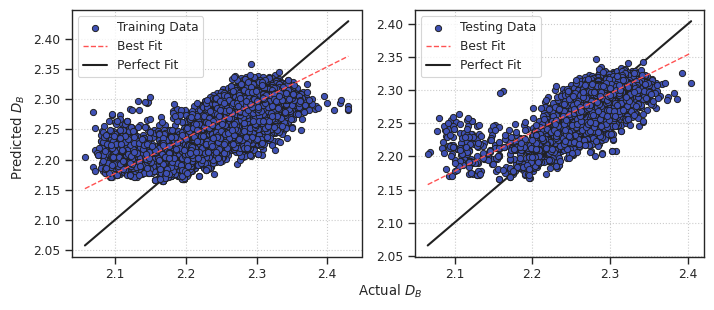

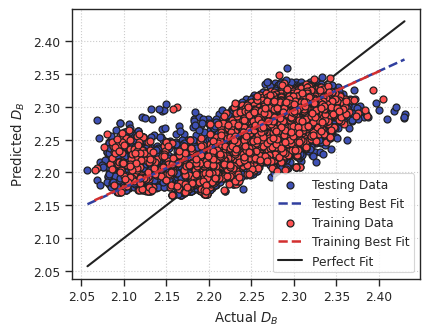

/home/users/u6853992/anaconda3/envs/npfd/lib/python3.9/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


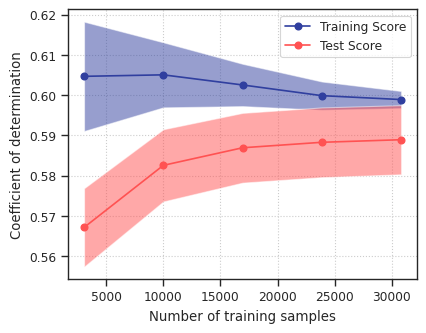

  Feature coefficients:
    N_Pt: 0.014
    Curve_61-70: 0.001
    Curve_71-80: 0.002
    MM_BL_avg: 0.067
    AuAu_BL_std: 0.007
    AuPd_BL_max: 0.005
    AuPt_BL_min: 0.009
    PdPd_BL_max: 0.009
    PdPt_BL_max: 0.012
    AuAuPt_BA1_std: 0.007
    AuPdAu_BA1_std: 0.001
    AuPdPd_BA1_max: 0.006
    AuPdPd_BA1_num: 0.006
    AuPtPd_BA1_max: 0.001
    AuPtPd_BA1_min: 0.011
    AuPtPt_BA1_min: 0.002
    AuPtPt_BA1_num: 0.003
    PdPdPt_BA1_num: 0.001
    PdPtAu_BA1_max: 0.004
    PdPtPd_BA1_max: 0.002
    PdPtPt_BA1_max: 0.005
    PtAuAu_BA1_max: 0.003
    PtAuPt_BA1_max: 0.003
    PtPdAu_BA1_std: 0.004
    PtPtAu_BA1_std: 0.003
    PtPtPd_BA1_avg: 0.004
    PtPtPt_BA1_min: 0.002
    AuAuPd_BA2_std: 0.015
    AuAuPd_BA2_max: 0.009
    AuAuPt_BA2_std: 0.002
    AuPtPt_BA2_max: 0.003
    PdAuPd_BA2_max: 0.001
    PdAuPt_BA2_std: 0.028
    PdPtPd_BA2_avg: 0.002
    PdPtPt_BA2_max: 0.004
    AuAuAuPt_BTneg_max: 0.004
    AuAuPdPt_BTneg_num: 0.006
    AuAuPtAu_BTneg_max: 0.001
    AuPdAuPd

In [44]:
enReg = ElasticNetCV(l1_ratio=(0.1, 0.5, 0.7, 0.9, 0.95, 0.99), eps=0.001, n_alphas=100, alphas=None, 
                     fit_intercept=True, precompute='auto', max_iter=100000, tol=0.0001, cv=5, 
                     copy_X=True, verbose=0, n_jobs=NUM_JOBS, positive=False, random_state=RANDOM_SEED, selection='cyclic')
yPredTrainElasNetR, yPredTestElasNetR, enReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                        model=enReg, modelName='ElasNetR', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                                        showFeatCoef=True, plotFeatImp=False, verbose=True, showFig=True)

#### Kernel Ridge Regressor

In [ ]:
# General
estimator = KernelRidge(alpha=1, kernel='linear', gamma=None, degree=3, coef0=1, kernel_params=None)
paramGridGeneral = {'alpha': [0.1, 1.0, 10, 100], 
             'kernel': ['linear', 'poly', 'cosine'],  # 'linear', 'poly', 'rbf', 'sigmoid', 'additive_chi2', 'chi2', 'polynomial', 'laplacian', 'cosine'
             }
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
searchResultsGeneral = hyperparamTune(estimator, paramGridGeneral, Xtrain, yTrain, Xtest, yTest, cv=cv)

# Sigmoid kernel
estimator = KernelRidge(alpha=1, kernel='linear', gamma=None, degree=3, coef0=1, kernel_params=None)
paramGridSigmoid = {'alpha': [0.1, 1.0, 10, 100], 
             'kernel': ['sigmoid'],  # 'linear', 'poly', 'rbf', 'sigmoid', 'additive_chi2', 'chi2', 'polynomial', 'laplacian', 'cosine'
             'gamma': (1.0, 0.1, 0.01, 0.001), 
             'coef0': [0.5, 1.0, 2.0], 
             }
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
searchResultsSigmoid = hyperparamTune(estimator, paramGridSigmoid, Xtrain, yTrain, Xtest, yTest, cv=cv)

# Polynomial kernel
estimator = KernelRidge(alpha=1, kernel='linear', gamma=None, degree=3, coef0=1, kernel_params=None)
paramGridPolynomial = {'alpha': [0.1, 1.0, 10, 100], 
             'kernel': ['polynomial'],  # 'linear', 'poly', 'rbf', 'sigmoid', 'additive_chi2', 'chi2', 'polynomial', 'laplacian', 'cosine'
             'degree' : [2, 3, 4], 
             'gamma': (1.0, 0.1, 0.01, 0.001), 
             'coef0': [0.5, 1.0, 2.0], 
             }
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
searchResultsPolynomial = hyperparamTune(estimator, paramGridPolynomial, Xtrain, yTrain, Xtest, yTest, cv=cv)

# Kernel involving gammas
estimator = KernelRidge(alpha=1, kernel='linear', gamma=None, degree=3, coef0=1, kernel_params=None)
paramGridGamma = {'alpha': [0.1, 1.0, 10, 100], 
             'kernel': ['rbf', 'laplacian', 'chi2', 'sigmoid'],  # 'linear', 'poly', 'rbf', 'sigmoid', 'additive_chi2', 'chi2', 'polynomial', 'laplacian', 'cosine'
             'gamma': (1.0, 0.1, 0.01, 0.001), 
             }
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
searchResultsGamma = hyperparamTune(estimator, paramGridGamma, Xtrain, yTrain, Xtest, yTest, cv=cv)

bestResultsIdx = np.argmax([searchResultsGeneral.best_score_, searchResultsSigmoid.best_score_, searchResultsPolynomial.best_score_, searchResultsGamma.best_score_])
searchResultsBest = [searchResultsGeneral, searchResultsSigmoid, searchResultsPolynomial, searchResultsGamma][bestResultsIdx]

krReg = searchResults.best_estimator_
yPredTrainKRR, yPredTestKRR, krReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                              model=krReg, modelName='KRR', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                              showFeatCoef=False, plotFeatImp=False, verbose=True, showFig=True)

#### K-Nearest Neighbour Regressor

In [8]:
estimator = KNeighborsRegressor(n_neighbors=5, weights='uniform', p=2, metric='minkowski', 
                                algorithm='auto', leaf_size=30, metric_params=None, n_jobs=NUM_JOBS)
paramGrid = {'n_neighbors': [3, 5, 8, 10], 
             'weights': ['uniform', 'distance'],  
             'p' : [1, 1.5, 2], 
             'metric': ['minkowski', 'euclidean', 'manhattan']}
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

knReg = searchResults.best_estimator_
yPredTrainKNR, yPredTestKNR, knReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                              model=knReg, modelName='KNR', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                              showFeatCoef=False, plotFeatImp=False, verbose=True, showFig=True)

KeyboardInterrupt: 

#### Support Vector Regressor

In [ ]:
estimator = SVR(coef0=0.0, tol=0.001, epsilon=0.1, shrinking=True, cache_size=200, verbose=False, max_iter=-1)
paramGrid = {'C': [0.01, 0.1, 1.0, 10, 100], 
             'epsilon': [0.01, 0.1, 1.0], 
             'kernel': ['linear', 'poly', 'rbf', 'sigmoid'], 
             'degree' : [2, 3, 4], 
             'gamma': ['scale', 'auto', 0.01, 0.1, 1.0]}
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

svReg = searchResults.best_estimator_
yPredTrainSVR, yPredTestSVR, svReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                              model=svReg, modelName='SVR', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                              showFeatCoef=False, plotFeatImp=False, verbose=True, showFig=True)

#### Decision Tree Regressor

In [ ]:
estimator = DecisionTreeRegressor(criterion='squared_error', splitter='best', max_depth=None, 
                                  min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, 
                                  max_features=None, max_leaf_nodes=None, min_impurity_decrease=0.0, ccp_alpha=0.0,
                                  random_state=RANDOM_SEED)
paramGrid = {'criterion': ['squared_error', 'absolute_error', 'poisson'], # 'friedman_mse', 
             'splitter': ['best', 'random'], 
             'max_depth' : [3, 5, None], 
             'max_features': ['sqrt', 'log2', None]}
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

dtReg = searchResults.best_estimator_
yPredTrainDTR, yPredTestDTR, dtReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                              model=dtReg, modelName='DTR', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                              showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### ExtRa Tree Regressor

In [ ]:
estimator = ExtraTreeRegressor(criterion='squared_error', splitter='random', max_depth=None, 
                               min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, 
                               max_features=1.0, min_impurity_decrease=0.0, max_leaf_nodes=None, ccp_alpha=0.0,
                               random_state=RANDOM_SEED)
paramGrid = {'criterion': ['squared_error', 'friedman_mse', 'absolute_error', 'poisson'], 
             'splitter': ['best', 'random'], 
             'max_depth' : [3, 5, None], 
             'max_features': ['auto', 'sqrt', 'log2', 1.0, None]}
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

etReg = BaggingRegressor(searchResults.best_estimator_, random_state=RANDOM_SEED)
yPredTrainETR, yPredTestETR, etReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                              model=etReg, modelName='ETR', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                              showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### Random Forest Regressor

In [ ]:
estimator = RandomForestRegressor(n_estimators=100, criterion='squared_error', max_depth=8, min_samples_split=2, min_samples_leaf=1, 
                                  min_weight_fraction_leaf=0.0, max_features=1.0, max_leaf_nodes=None, min_impurity_decrease=0.0, 
                                  bootstrap=True, oob_score=False, n_jobs=None, random_state=RANDOM_SEED, verbose=0, warm_start=False, 
                                  ccp_alpha=0.0, max_samples=None)
paramGrid = {'max_depth': [30,], 
             'max_features' : ['sqrt', 'log2', 1],  # 'log2', 1
             'n_estimators': [350],
             'min_samples_split': [5], 
             'min_samples_leaf': [5]}
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

rfReg = searchResults.best_estimator_
yPredTrainRFR, yPredTestRFR, rfReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                              model=rfReg, modelName='RFR', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                              showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### ExtRa Trees Regressor

In [ ]:
estimator = ExtraTreesRegressor(n_estimators=100, criterion='squared_error', max_depth=None, 
                                min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, 
                                max_features=1.0, max_leaf_nodes=None, min_impurity_decrease=0.0, 
                                bootstrap=False, oob_score=False, n_jobs=NUM_JOBS, random_state=RANDOM_SEED, verbose=0, 
                                warm_start=False, ccp_alpha=0.0, max_samples=None)
paramGrid = {'n_estimators': [100, 300], 
             'criterion': ['squared_error', 'absolute_error', 'poisson'],  # 'friedman_mse', 
             'max_depth' : [5, 10, 30], 
             'max_features': ['sqrt', 'log2', None]}
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

etsReg = searchResults.best_estimator_
yPredTrainETsR, yPredTestETsR, etsReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                 model=etsReg, modelName='ETsR', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                                 showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

  Running ETsR
  Trained and tested using coefficient of determination.
    Training score: 1.000
    Testing score:
      Mean absolute error: 0.013798
      Mean squared error: 0.000427
      Root mean squared error: 0.020657
      Coefficient of determination: 0.700


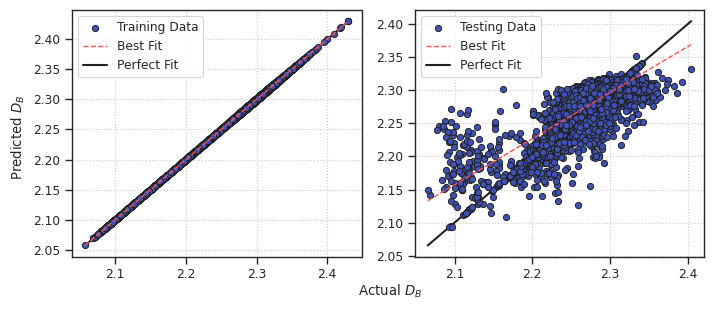

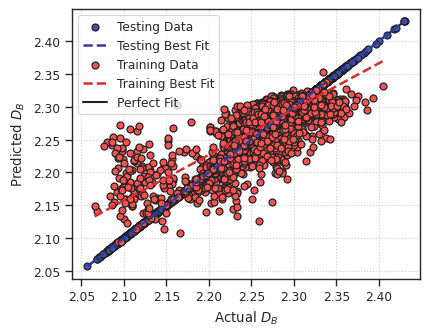


KeyboardInterrupt



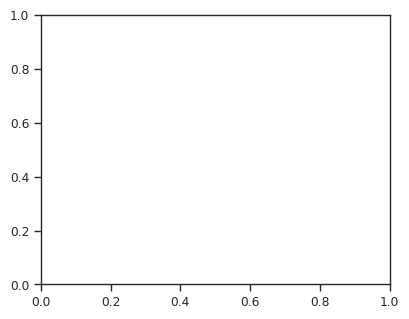

In [33]:
etsReg = ExtraTreesRegressor(n_estimators=500, random_state=42)
yPredTrainETsR, yPredTestETsR, etsReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                 model=etsReg, modelName='ETsR', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                                 showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### Adaptive Boosting Forest Regressor

In [ ]:
estimator = AdaBoostRegressor(estimator=None, n_estimators=50, learning_rate=1.0, loss='linear', random_state=RANDOM_SEED)
paramGrid = {'n_estimators': [50, 100, 150], 
             'learning_rate': [0.1, 1.0, 10], 
             'loss' : ['linear', 'square', 'exponential']}
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

abReg = searchResults.best_estimator_
yPredTrainABR, yPredTestABR, abReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                              model=abReg, modelName='ABR', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                              showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### Extreme Gradient Boosting Regressor

In [ ]:
estimator = XGBRegressor(verbosity=1, n_jobs=NUM_JOBS, importance_type='gain')
# n_estimators=100, max_depth=5, max_leaves=0, max_bin=15, grow_policy='depthwise', learning_rate=0.01, verbosity=3, 
# objective=None, booster='gbtree', tree_method='hist', n_jobs=NUM_JOBS, 
# gamma=None, min_child_weight=None, 
# subsample=None, sampling_method=None, colsample_bytree=None, colsample_bylevel=None, colsample_bynode=None, 
# reg_alpha=None, reg_lambda=None, scale_pos_weight=None, base_score=None, random_state=RANDOM_SEED, 
# missing=None, num_parallel_tree=None, monotone_constraints=None, interaction_constraints=None, importance_type='gain', 
# eval_metric=mean_squared_error, early_stopping_rounds=None, max_delta_step=None
paramGrid = {# 'n_estimators': [50, 100], 
             # 'booster': ['gbtree', 'gblinear', 'dart'], 
             'learning_rate': [0.01, 0.1],
             'min_child_weight': [1, 3, 5],
             'gamma': [0, 1, 3], 
             'max_depth' : [3, 6, 9], 
             'colsample_bytree': [0.5, 1], 
             'subsample': [0.5, 1]}
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

xgbReg = searchResults.best_estimator_
yPredTrainXGBR, yPredTestXGBR, xgbReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                 model=xgbReg, modelName='XGBR', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                                 showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)

#### Light Gradient Boosting Machine Regressor

In [ ]:
estimator = LGBMRegressor(boosting_type='gbdt', num_leaves=31, max_depth=20, learning_rate=0.1, n_estimators=100, subsample_for_bin=200000, objective=None, 
                          class_weight=None, min_split_gain=0.0, min_child_weight=0.001, min_child_samples=20, subsample=1.0, subsample_freq=0, colsample_bytree=1.0, 
                          reg_alpha=0.0, reg_lambda=0.0, random_state=RANDOM_SEED, n_jobs=NUM_JOBS, importance_type='gain')
paramGrid = {'boosting_type': ['gbdt', 'dart', 'rf'], 
             'max_depth' : [5, 10, 20], 
             'n_estimators': [25, 50, 100, 250]}
cv = KFold(n_splits=5, shuffle=True, random_state=RANDOM_SEED)
searchResults = hyperparamTune(estimator, paramGrid, Xtrain, yTrain, Xtest, yTest, cv=cv)

lgbmReg = searchResults.best_estimator_
yPredTrainLGBMR, yPredTestLGBMR, lgbmReg = runModel(Xtrain, yTrain, Xtest, yTest, 
                                                model=lgbmReg, modelName='LGBMR', datasetName=TNP_NAME, figNameAppendix=FIG_NAME_APPENDIX,
                                                showFeatCoef=False, plotFeatImp=True, verbose=True, showFig=True)